In [15]:
%matplotlib inline
import numpy as np
import pandas as pd

import datetime

import matplotlib.pyplot as plt
import pylab
from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 15, 6

import statsmodels.api as sm  
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import adfuller, acf, pacf, q_stat
from statsmodels.graphics.gofplots import qqplot

from sklearn.metrics import mean_squared_error
from math import sqrt

# Step 1) Data cleaning
### - Date column is not in date format
### - Some dates are missing, i.e. category D only has half of the dates

In [16]:
np.random.seed(42)
data = pd.read_csv('../data/siteB.csv')

In [17]:
data['Date_Name'] = data['Date_Name'].apply(lambda x: datetime.datetime.strptime(x,'%Y-%m-%d'))

In [18]:
print data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 78587 entries, 0 to 78586
Data columns (total 4 columns):
Date_Name        78587 non-null datetime64[ns]
subCategory      78587 non-null object
Purchase_Hour    78587 non-null int64
sales            78587 non-null float64
dtypes: datetime64[ns](1), float64(1), int64(1), object(1)
memory usage: 2.4+ MB
None


In [19]:
# Make a dataframe for each category, and put it into a list...len(list) = 16
# Essentially becomes a list of dataframe

def make_dataframe(df, lis):
    f = lambda x: df[df['subCategory'] == x]
    return map(f, lis)

temp_list = data['subCategory'].unique()
splitted_data = make_dataframe(data, temp_list)
print len(splitted_data)
print splitted_data[2][0:5]

15
       Date_Name subCategory  Purchase_Hour  sales
11887 2015-12-17           C              8  65.85
11888 2015-12-15           C              9  94.72
11889 2015-12-15           C             12   1.69
11890 2015-12-18           C             12   7.27
11891 2015-12-15           C             14   3.38


In [20]:
# Looks like some have missing dates, like category D has only half of the dates.

idx = pd.date_range('09-26-2015', '09-30-2016')

for i, item in enumerate(temp_list):
    splitted_data[i] = splitted_data[i].groupby(by=['Date_Name'])['sales'].sum()
    print item, ':', splitted_data[i].shape
    
    # We fill in the missing dates with value 0. Because this may be holiday and the shop made 0 sales.
    splitted_data[i].index = pd.DatetimeIndex(splitted_data[i].index)
    splitted_data[i] = splitted_data[i].reindex(idx, fill_value=0)
    print item, ':', splitted_data[i].shape, '-', splitted_data[i].index

print '\n', splitted_data[0].head()

A : (365,)
A : (371,) - DatetimeIndex(['2015-09-26', '2015-09-27', '2015-09-28', '2015-09-29',
               '2015-09-30', '2015-10-01', '2015-10-02', '2015-10-03',
               '2015-10-04', '2015-10-05',
               ...
               '2016-09-21', '2016-09-22', '2016-09-23', '2016-09-24',
               '2016-09-25', '2016-09-26', '2016-09-27', '2016-09-28',
               '2016-09-29', '2016-09-30'],
              dtype='datetime64[ns]', length=371, freq='D')
B : (365,)
B : (371,) - DatetimeIndex(['2015-09-26', '2015-09-27', '2015-09-28', '2015-09-29',
               '2015-09-30', '2015-10-01', '2015-10-02', '2015-10-03',
               '2015-10-04', '2015-10-05',
               ...
               '2016-09-21', '2016-09-22', '2016-09-23', '2016-09-24',
               '2016-09-25', '2016-09-26', '2016-09-27', '2016-09-28',
               '2016-09-29', '2016-09-30'],
              dtype='datetime64[ns]', length=371, freq='D')
C : (364,)
C : (371,) - DatetimeIndex(['2015-09-26',

# Step 2) Data exploratory
### - We observe the shop has sales every single day, except for category D, which has sales for only 1/2 of the time.
### - Weekly seasonal effect: weekend usually lower sales volume than weekday
### - There is no upward or downward trend except for category E
### - A convenient shop? The data is quite consistent throughout.

In [66]:
# Just to confirm my weekly theory is right,
# 2015-09-26, 2015-09-27, 2015-10-03, 2015-10-04, 2015-10-10, 2015-10-11, etc.
# are all weekends and have lower sales than weekdays.
# We will make a decomposition plot to further validate this.

print splitted_data[0].head(30)

2015-09-26    18.70
2015-09-27    18.95
2015-09-28    55.09
2015-09-29    35.25
2015-09-30    47.80
2015-10-01    36.75
2015-10-02    51.90
2015-10-03    16.45
2015-10-04     7.75
2015-10-05    44.24
2015-10-06    43.44
2015-10-07    43.50
2015-10-08    49.25
2015-10-09    39.20
2015-10-10    15.05
2015-10-11    21.25
2015-10-12     8.80
2015-10-13    36.35
2015-10-14    44.10
2015-10-15    56.85
2015-10-16    64.04
2015-10-17    33.55
2015-10-18    26.95
2015-10-19    60.35
2015-10-20    55.75
2015-10-21    60.80
2015-10-22    47.05
2015-10-23    57.35
2015-10-24    34.70
2015-10-25    32.00
Freq: D, Name: sales, dtype: float64


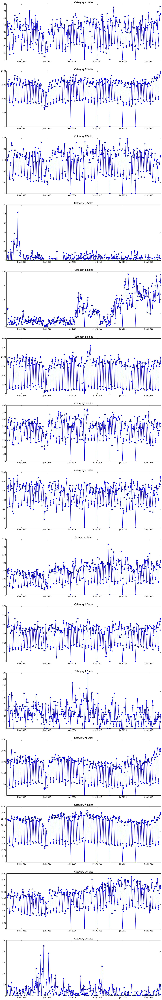

In [65]:
# Time series in connected point plot format for each category.
# We can see the missing dates(or date with 0 sales) in the time series this way

fig, axs = plt.subplots(len(temp_list),1, figsize=(15, 96))
axs = axs.ravel()

for i, item in enumerate(data['subCategory'].unique()):
    axs[i].plot(splitted_data[i].index, splitted_data[i], '-o')
    axs[i].set_title('Category {} Sales'.format(item))

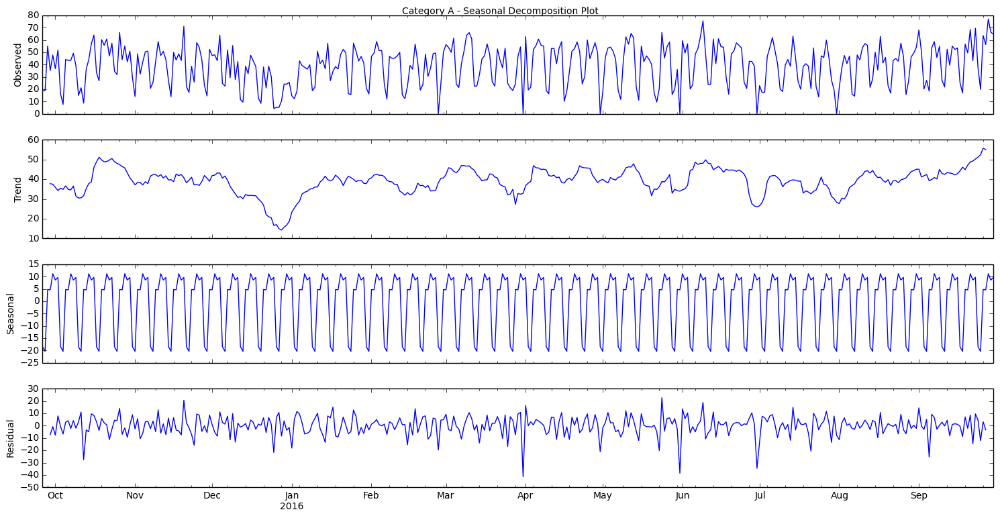

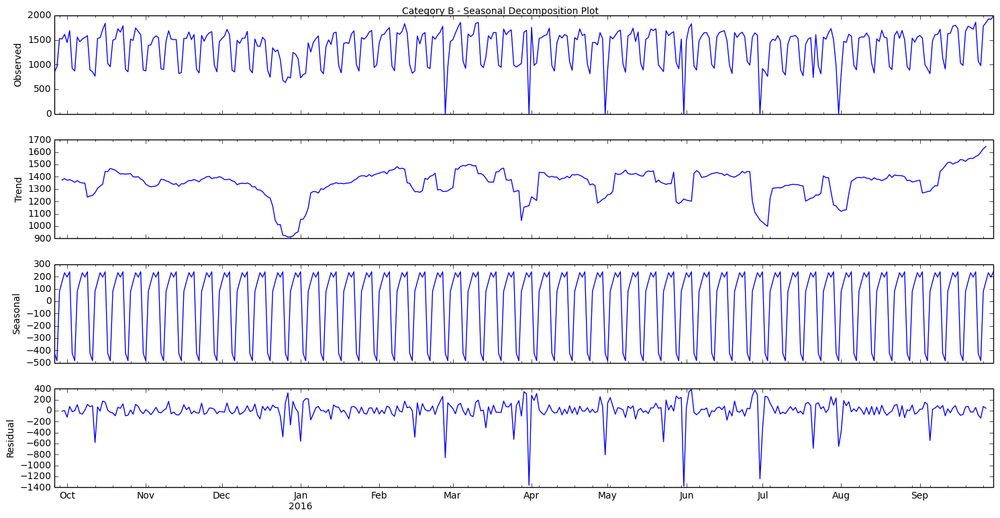

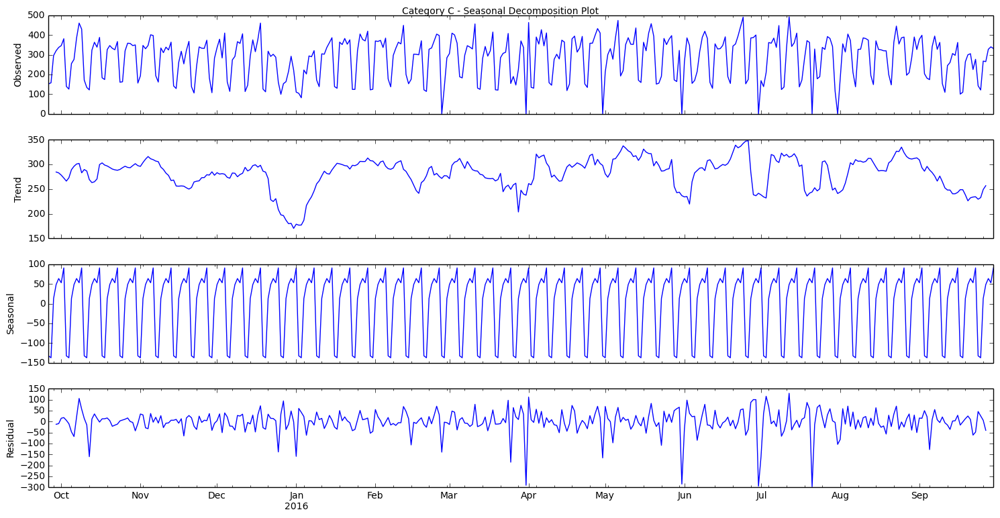

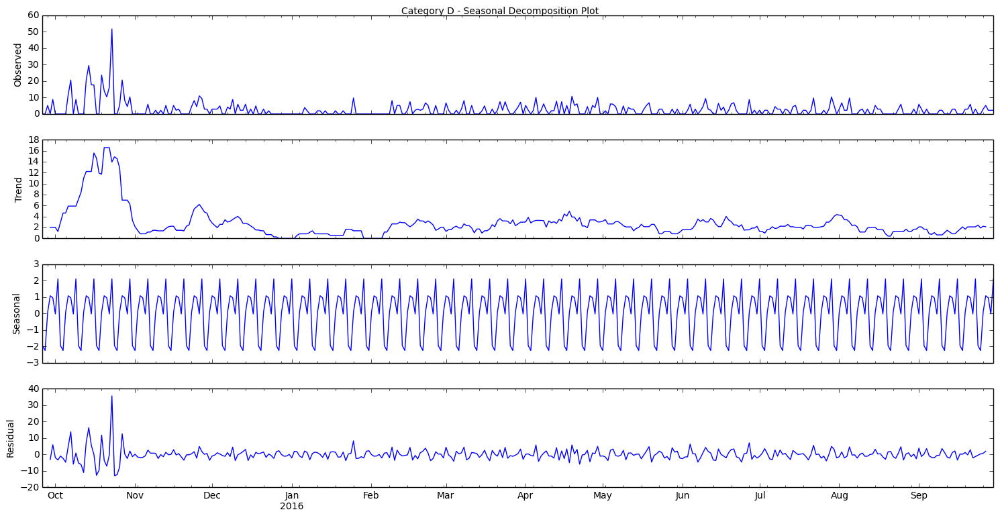

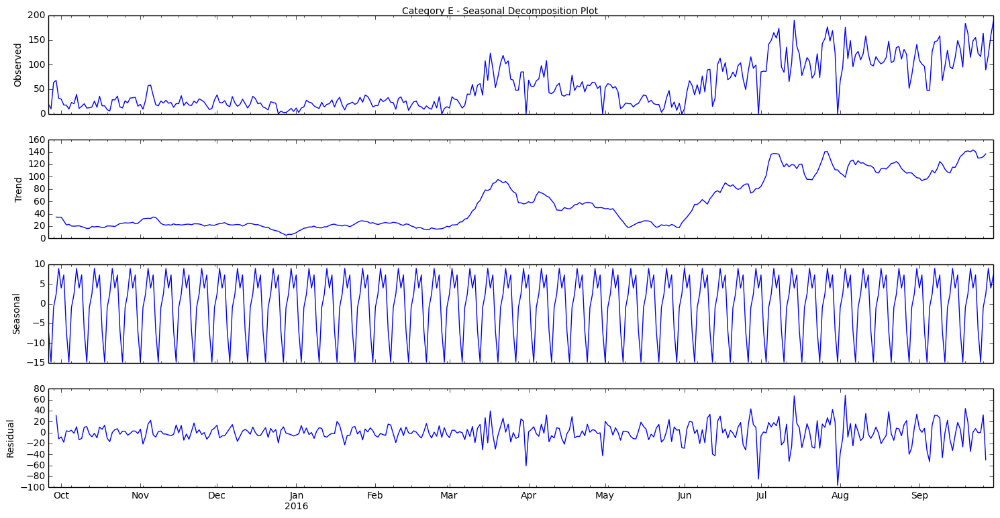

...

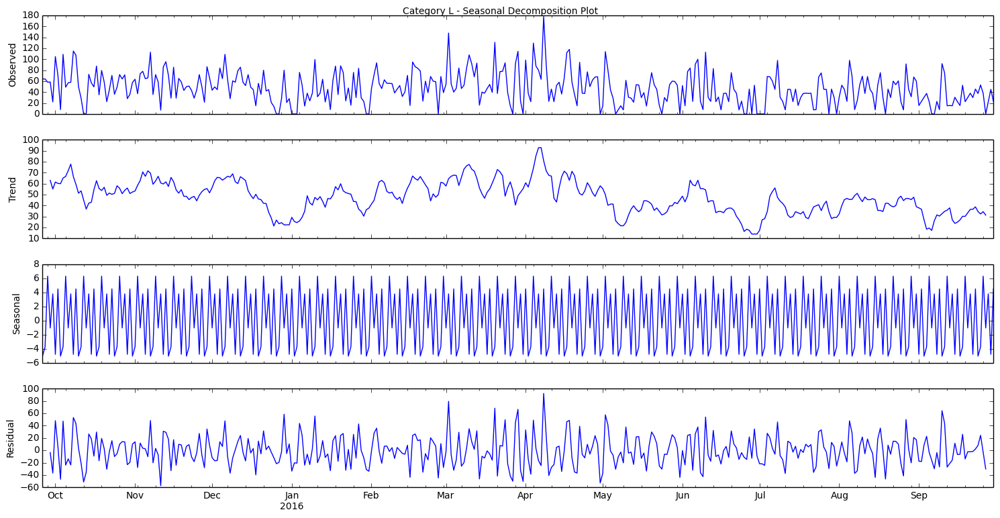

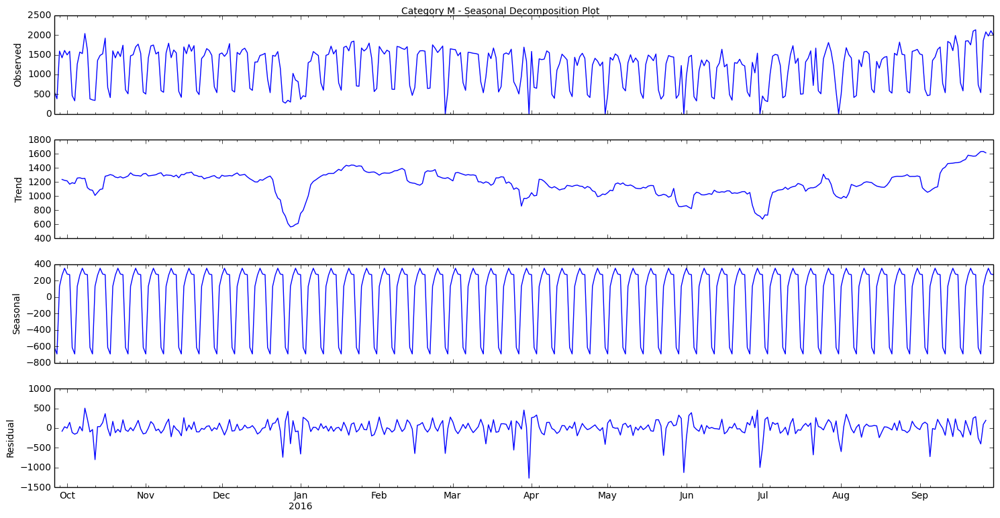

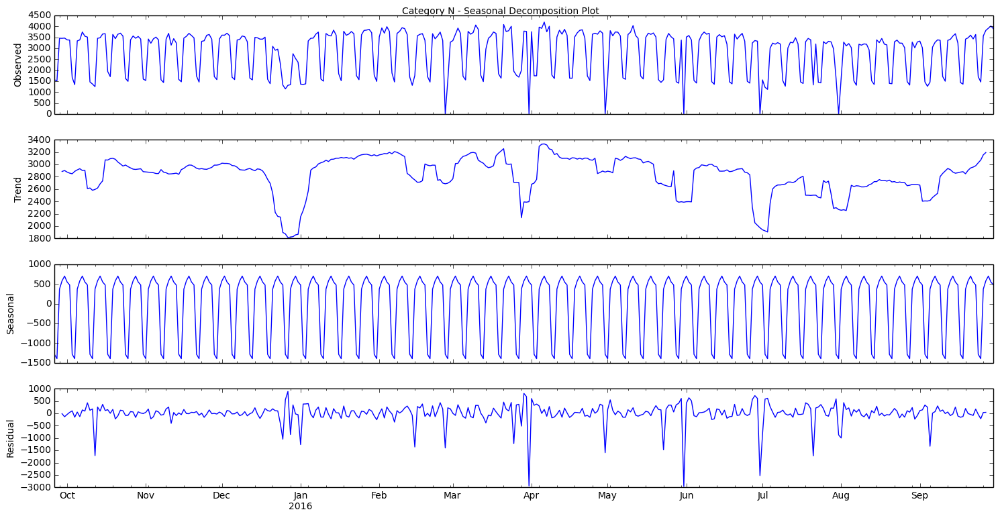

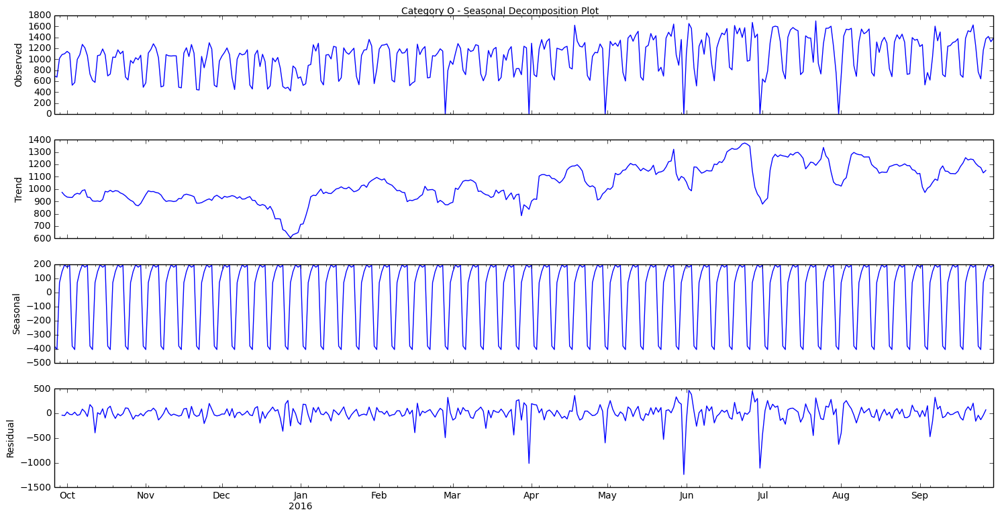

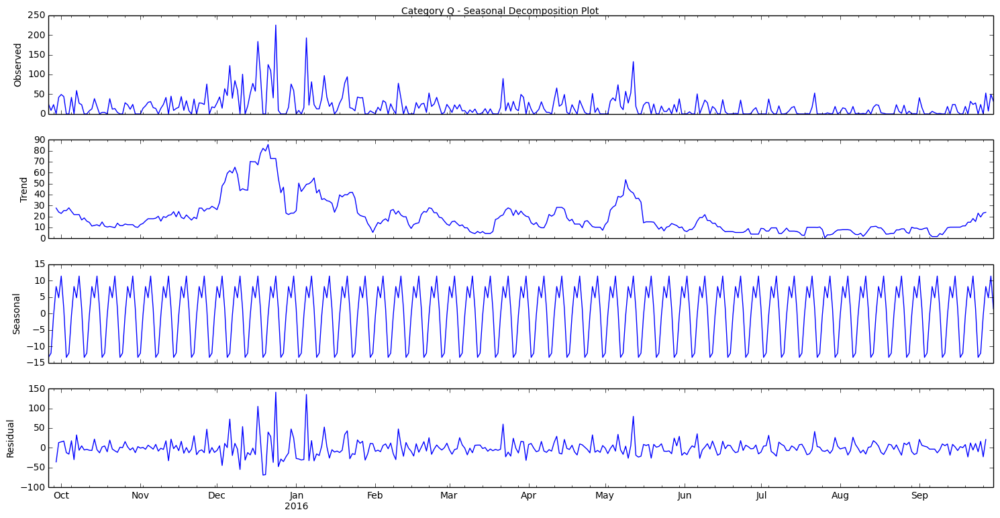

In [22]:
# Seasonal decomposition plots. Let's confirm the weekly seasonality.

def decomposition(timeseries, item):
    decomposition = seasonal_decompose(timeseries, freq=7)
    fig = plt.figure()  
    fig = decomposition.plot()  
    fig.set_size_inches(15, 8)
    fig.suptitle('Category {} - Seasonal Decomposition Plot'.format(item))

_ = map(decomposition, splitted_data, temp_list)

### - We can definitely see the weekly effect in the above graphs.
# Step 3) Data Processing & Statistical Testing
### - We will test the time series for stationarity
### - Transform them so they become stationary
### - Detrend them
### - Take care of the weekly seasonality observed previously

# Step 3.1) Stationarity Test

In [23]:
# We will use Dickey-Fuller Test to check the stationarity of our time series data.

def test_stationarity(timeseries, item):
    
    #Determing rolling statistics
    rol_mean = pd.rolling_mean(timeseries, window=12)
    rol_std = pd.rolling_std(timeseries, window=12)

    #Plot rolling statistics:
    original = plt.plot(timeseries, color='blue',label='Original')
    mean_ = plt.plot(rol_mean, color='red', label='Rolling Mean')
    std_ = plt.plot(rol_std, color='black', label = 'Rolling Std')
    plt.legend(loc='best')
    plt.title('Category {} - Rolling Mean & Standard Deviation'.format(item))
    plt.show(block=False)
    
    #Perform Dickey-Fuller test:
    print 'Results of Dickey-Fuller Test:'
    adf_test = adfuller(timeseries, autolag='AIC')
    adf_output = pd.Series(adf_test[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    
    for key,value in adf_test[4].items():
        adf_output['Critical Value (%s)'%key] = value
    print adf_output

/Library/Python/2.7/site-packages/ipykernel/__main__.py:6: FutureWarning: pd.rolling_mean is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).mean()
/Library/Python/2.7/site-packages/ipykernel/__main__.py:7: FutureWarning: pd.rolling_std is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).std()


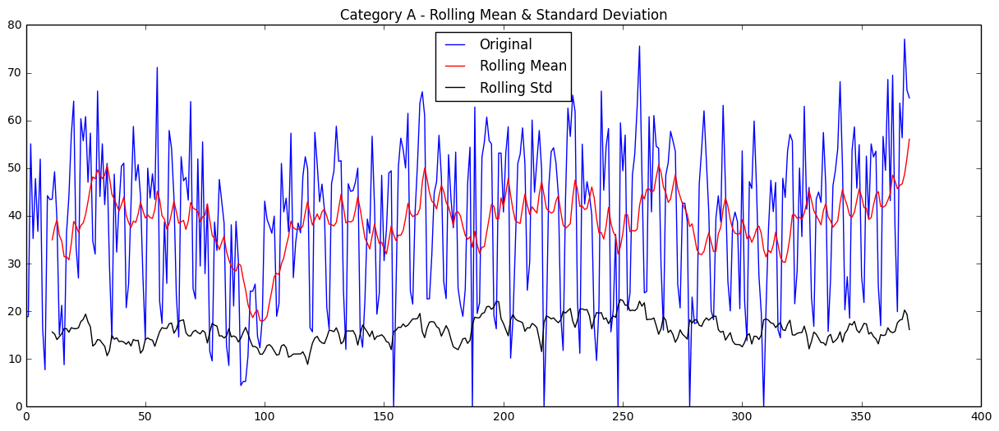

Results of Dickey-Fuller Test:
Test Statistic                  -3.623297
p-value                          0.005331
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


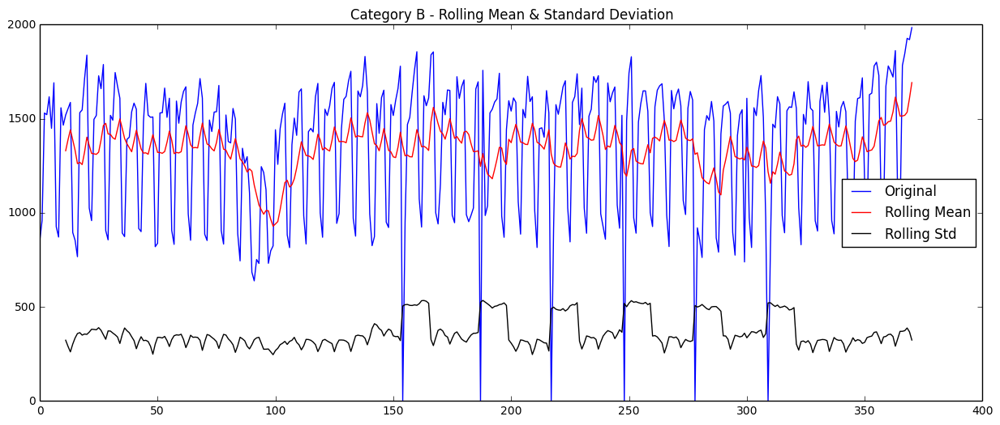

Results of Dickey-Fuller Test:
Test Statistic                  -3.194820
p-value                          0.020286
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


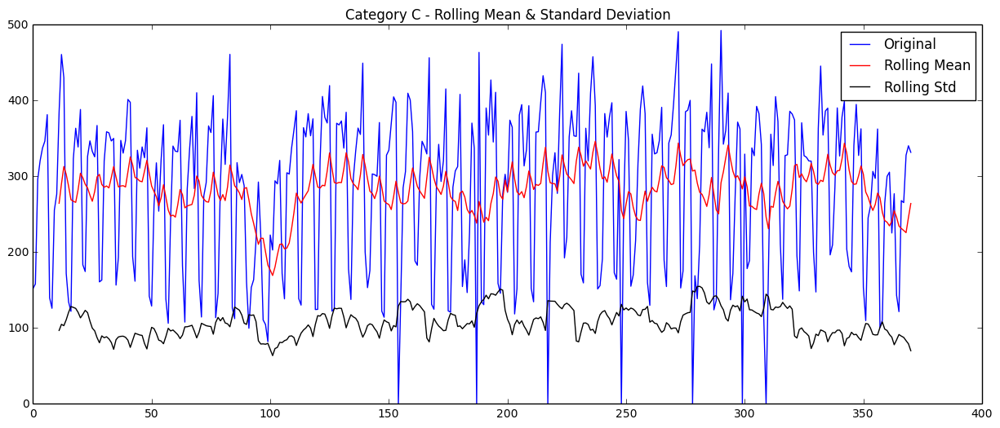

Results of Dickey-Fuller Test:
Test Statistic                  -4.457533
p-value                          0.000234
#Lags Used                      16.000000
Number of Observations Used    354.000000
Critical Value (5%)             -2.869739
Critical Value (1%)             -3.448958
Critical Value (10%)            -2.571138
dtype: float64


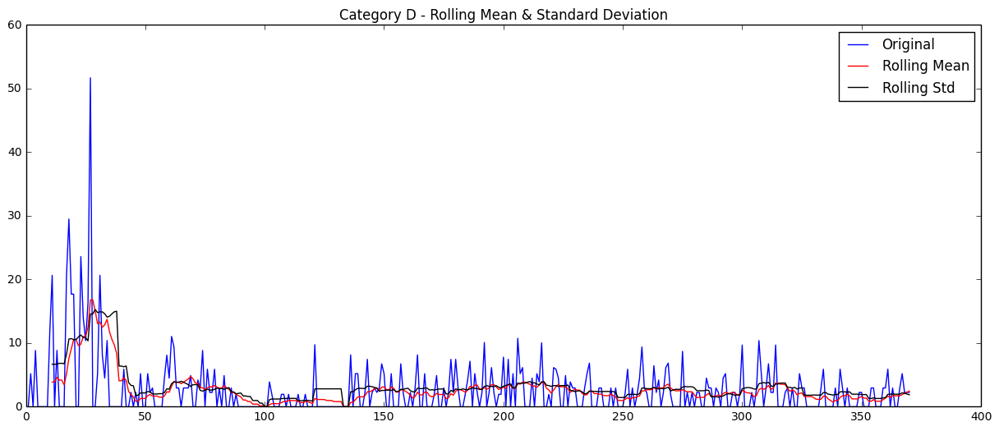

Results of Dickey-Fuller Test:
Test Statistic                  -3.789831
p-value                          0.003013
#Lags Used                      10.000000
Number of Observations Used    360.000000
Critical Value (5%)             -2.869602
Critical Value (1%)             -3.448646
Critical Value (10%)            -2.571065
dtype: float64


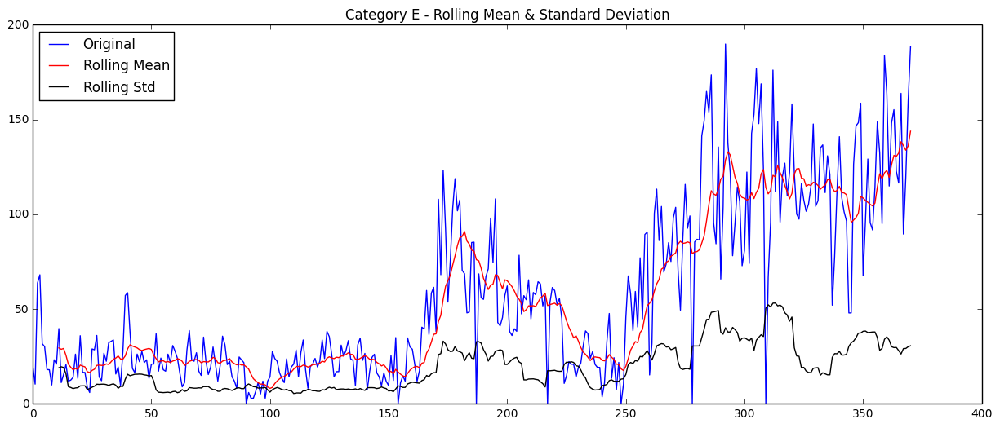

Results of Dickey-Fuller Test:
Test Statistic                  -0.251382
p-value                          0.932113
#Lags Used                      11.000000
Number of Observations Used    359.000000
Critical Value (5%)             -2.869625
Critical Value (1%)             -3.448697
Critical Value (10%)            -2.571077
dtype: float64


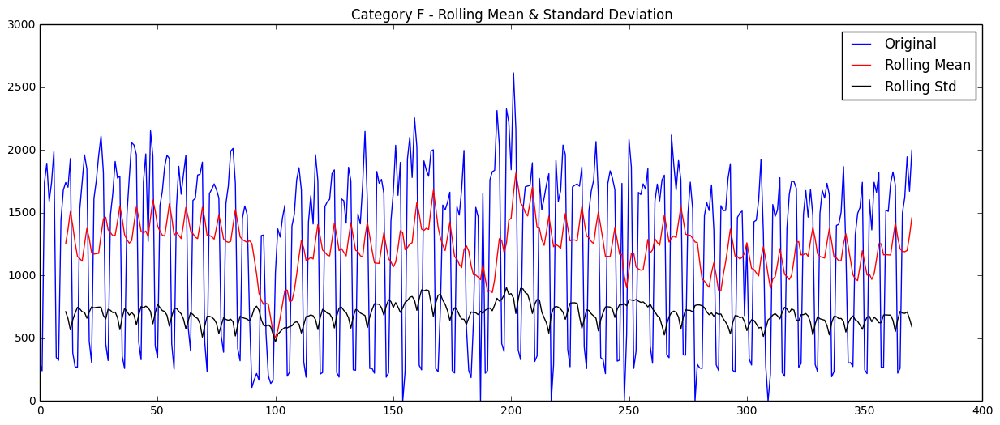

Results of Dickey-Fuller Test:
Test Statistic                  -4.211158
p-value                          0.000631
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


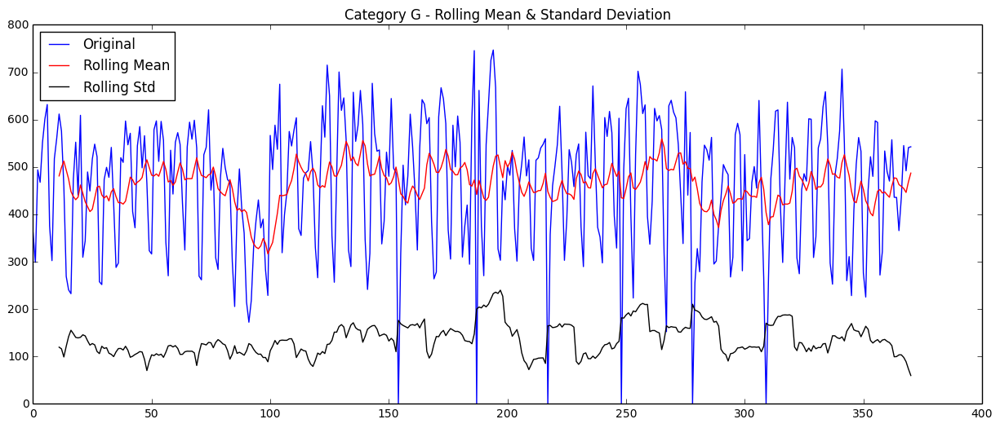

Results of Dickey-Fuller Test:
Test Statistic                  -4.073495
p-value                          0.001071
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


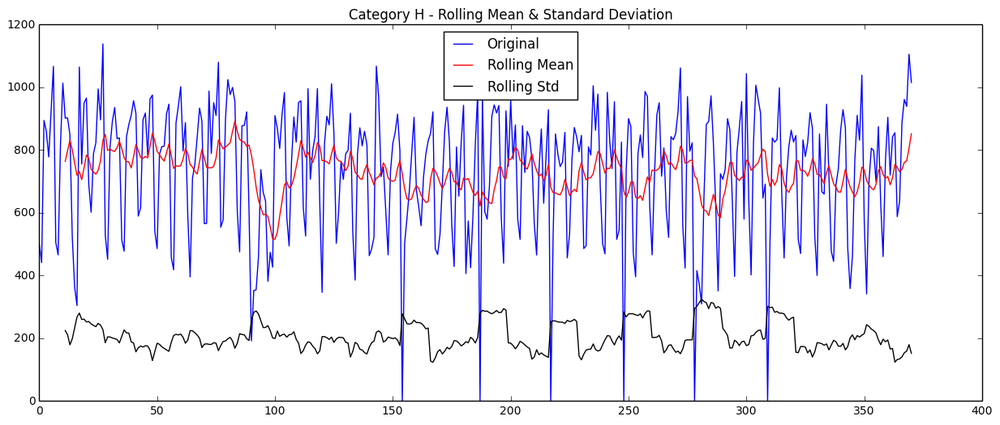

Results of Dickey-Fuller Test:
Test Statistic                  -4.746820
p-value                          0.000069
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


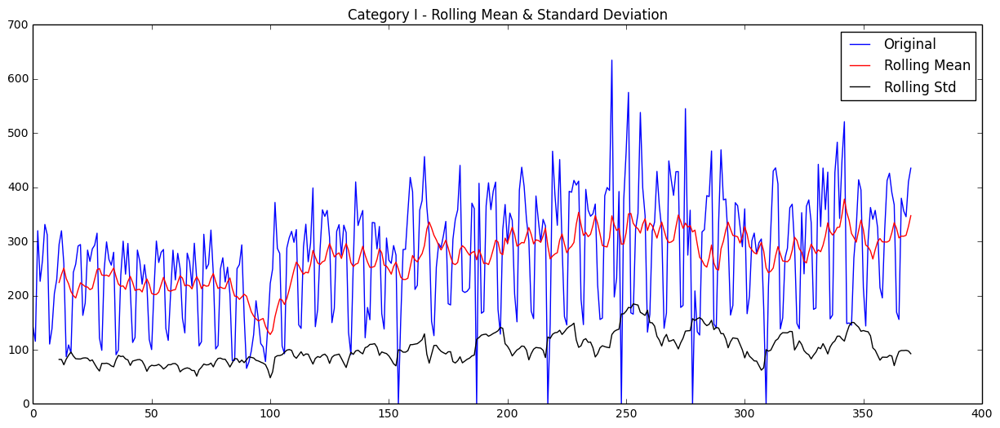

Results of Dickey-Fuller Test:
Test Statistic                  -2.007939
p-value                          0.283103
#Lags Used                      13.000000
Number of Observations Used    357.000000
Critical Value (5%)             -2.869670
Critical Value (1%)             -3.448801
Critical Value (10%)            -2.571101
dtype: float64


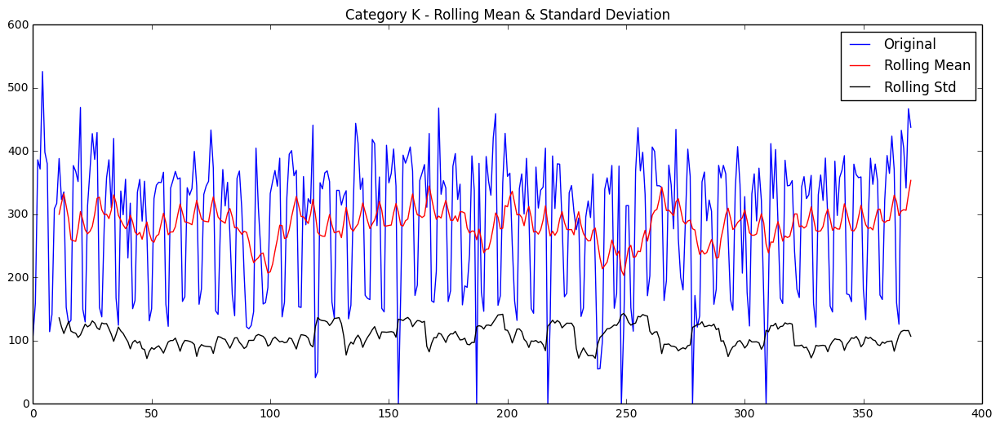

Results of Dickey-Fuller Test:
Test Statistic                  -4.908540
p-value                          0.000034
#Lags Used                      17.000000
Number of Observations Used    353.000000
Critical Value (5%)             -2.869763
Critical Value (1%)             -3.449011
Critical Value (10%)            -2.571151
dtype: float64


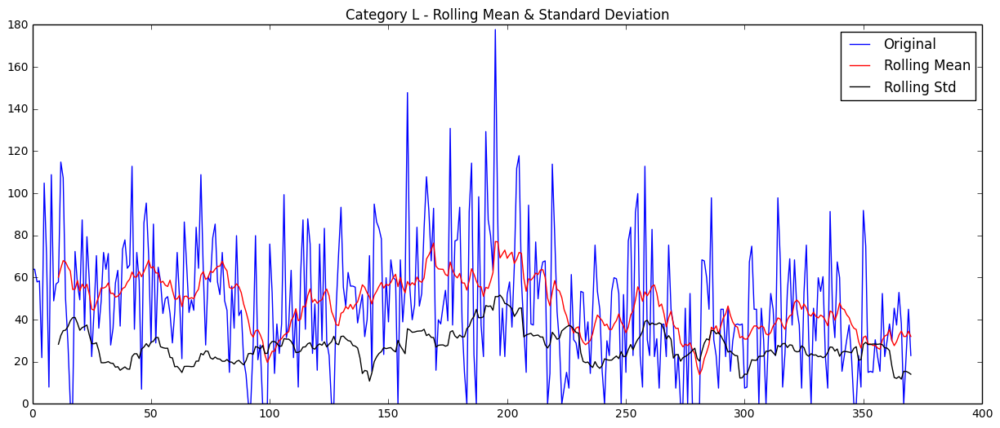

Results of Dickey-Fuller Test:
Test Statistic                  -4.866092
p-value                          0.000041
#Lags Used                       6.000000
Number of Observations Used    364.000000
Critical Value (5%)             -2.869513
Critical Value (1%)             -3.448443
Critical Value (10%)            -2.571018
dtype: float64


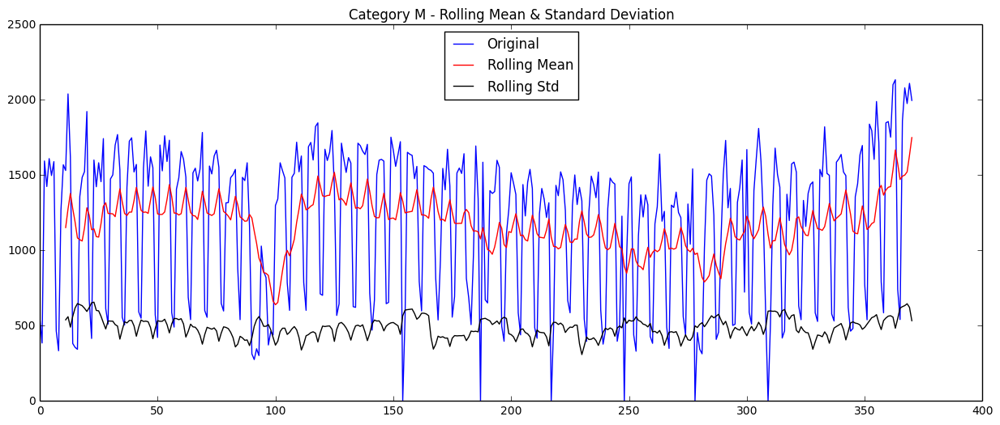

Results of Dickey-Fuller Test:
Test Statistic                  -2.444981
p-value                          0.129441
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


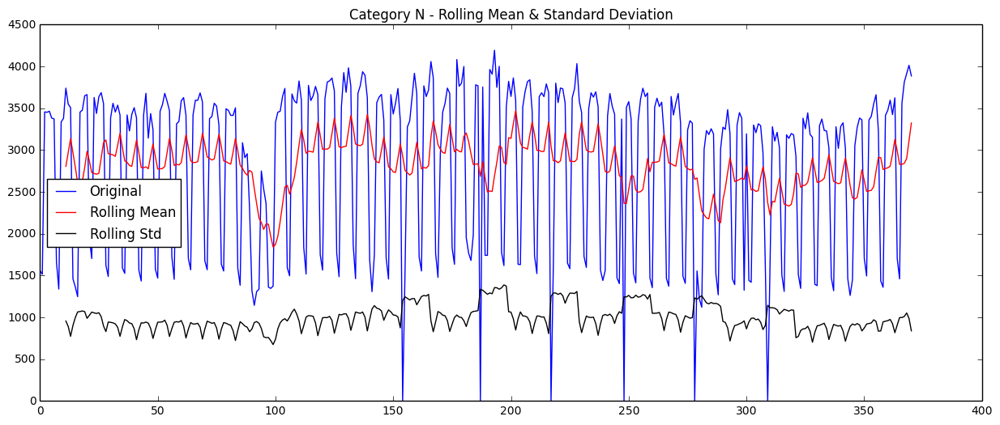

Results of Dickey-Fuller Test:
Test Statistic                  -3.980210
p-value                          0.001518
#Lags Used                      16.000000
Number of Observations Used    354.000000
Critical Value (5%)             -2.869739
Critical Value (1%)             -3.448958
Critical Value (10%)            -2.571138
dtype: float64


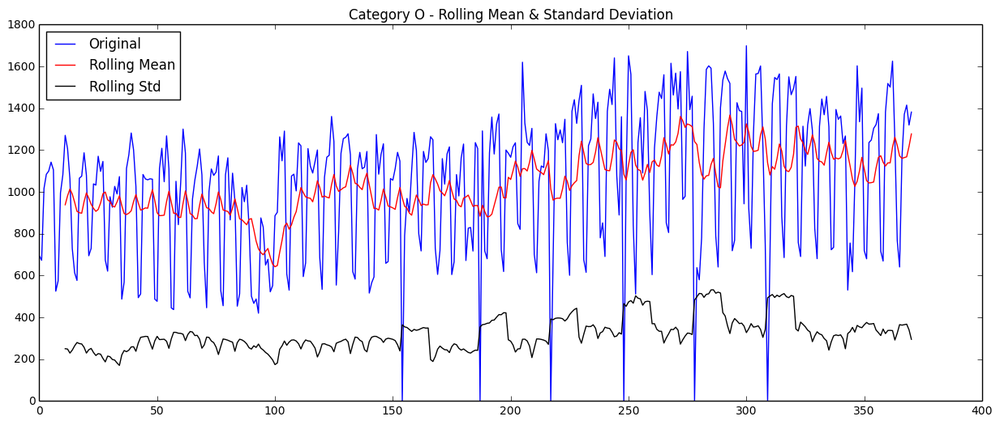

Results of Dickey-Fuller Test:
Test Statistic                  -2.040730
p-value                          0.269005
#Lags Used                      13.000000
Number of Observations Used    357.000000
Critical Value (5%)             -2.869670
Critical Value (1%)             -3.448801
Critical Value (10%)            -2.571101
dtype: float64


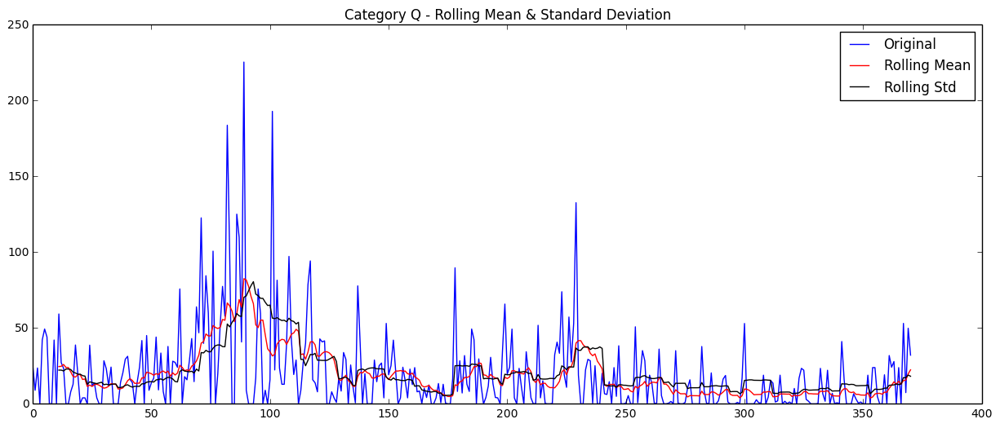

Results of Dickey-Fuller Test:
Test Statistic                  -3.195251
p-value                          0.020261
#Lags Used                       6.000000
Number of Observations Used    364.000000
Critical Value (5%)             -2.869513
Critical Value (1%)             -3.448443
Critical Value (10%)            -2.571018
dtype: float64


In [24]:
_ = map(test_stationarity, splitted_data, temp_list)

### We can see some categories have test statistics are larger than critical value (5%)
### while some categories are already stationary (test stats < critival value)
### Just to be on the safe side, we will make all categories stationary.
#### 1) Log it
#### 2) Diff(Log)
#### 3) Season_diff(Diff(Log))

In [25]:
# We will use this function repeatedly to make plots for -> Transformed Data vs. Original Data

def plot_data(original, trans_2, item, title, label_1, label_2):
    original.plot(label='{}'.format(label_1))
    trans_2.plot(label='{}'.format(label_2))
    plt.legend(loc='best')
    plt.title('Category {} - {}'.format(item, title))
    plt.show(block=False)

In [26]:
def log_data(timeseries, item):
#     logged_data = timeseries.apply(lambda x: np.log(x))
    return np.log(timeseries)

splitted_data_log = map(log_data, splitted_data, temp_list)
print splitted_data[0].head(), '\n', splitted_data_log[0].head()

2015-09-26    18.70
2015-09-27    18.95
2015-09-28    55.09
2015-09-29    35.25
2015-09-30    47.80
Freq: D, Name: sales, dtype: float64 
2015-09-26    2.928524
2015-09-27    2.941804
2015-09-28    4.008968
2015-09-29    3.562466
2015-09-30    3.867026
Freq: D, Name: sales, dtype: float64


/Library/Python/2.7/site-packages/ipykernel/__main__.py:3: RuntimeWarning: divide by zero encountered in log
  app.launch_new_instance()


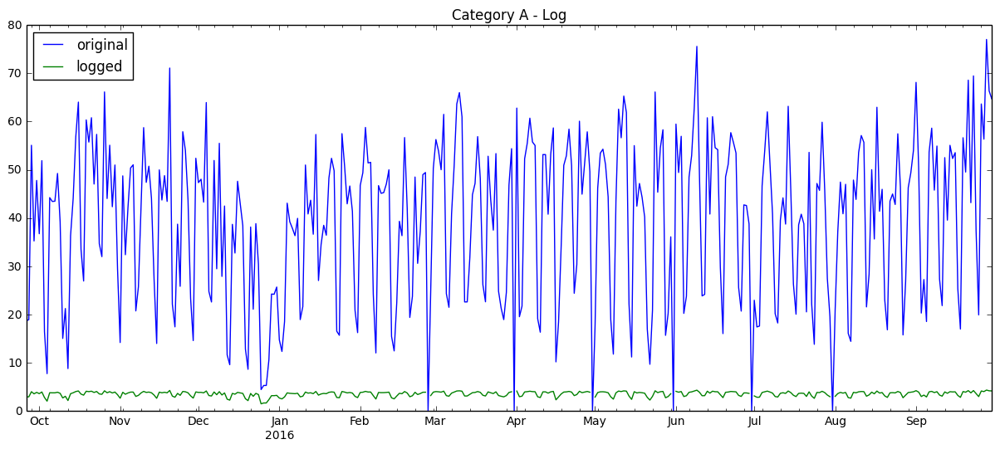

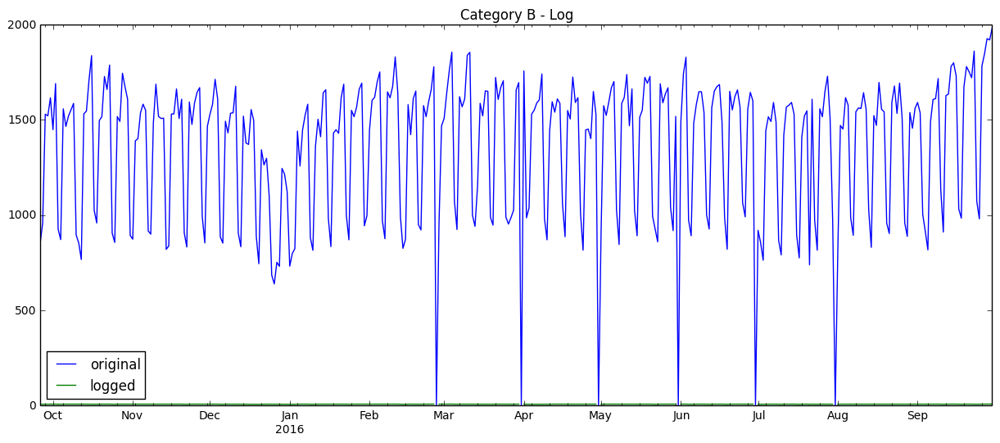

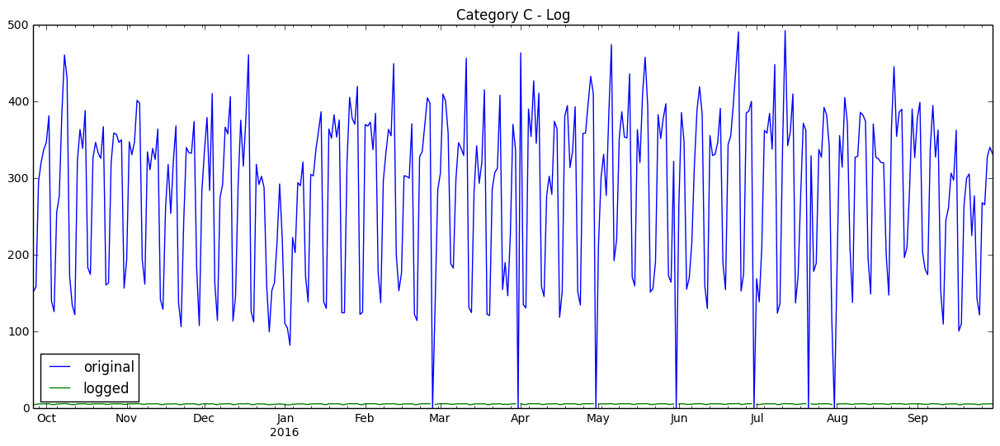

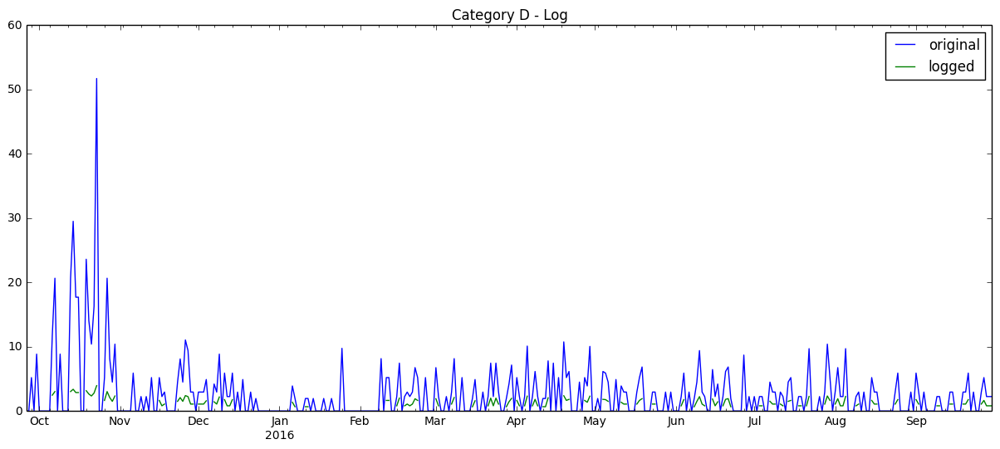

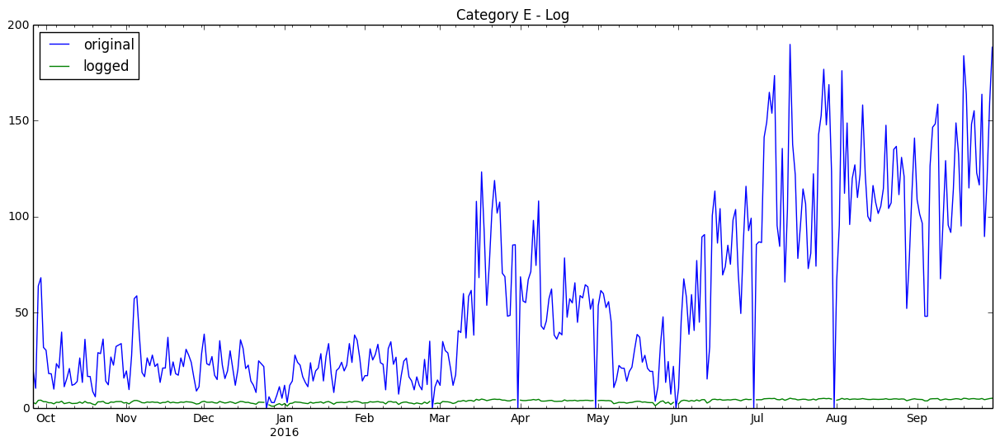

...

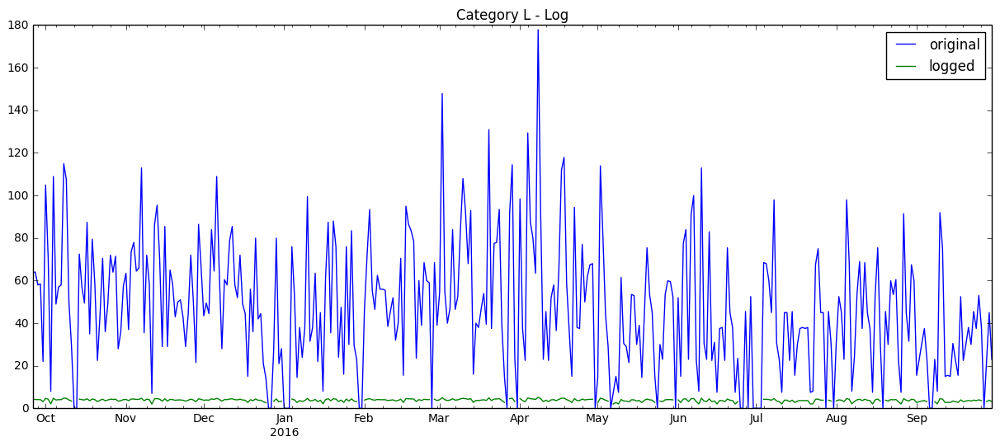

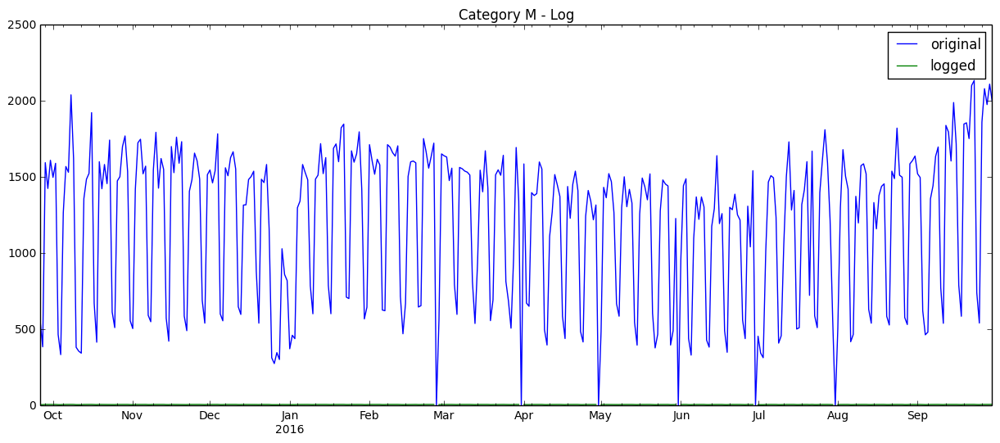

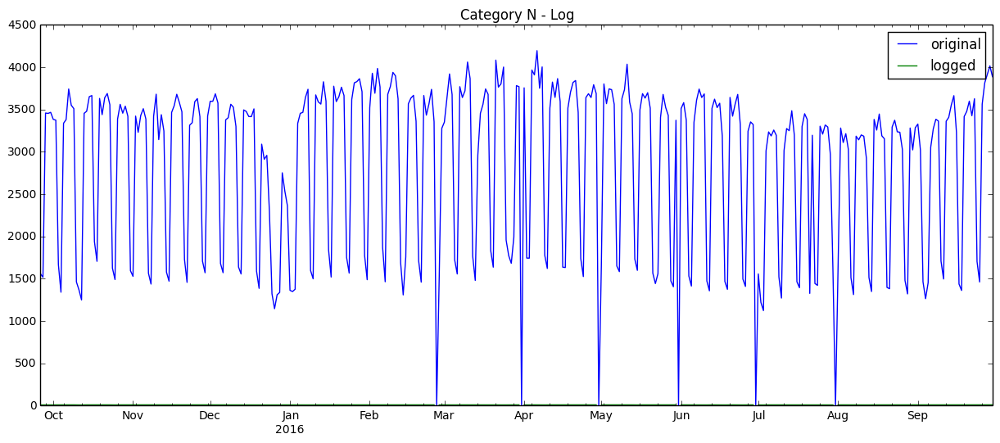

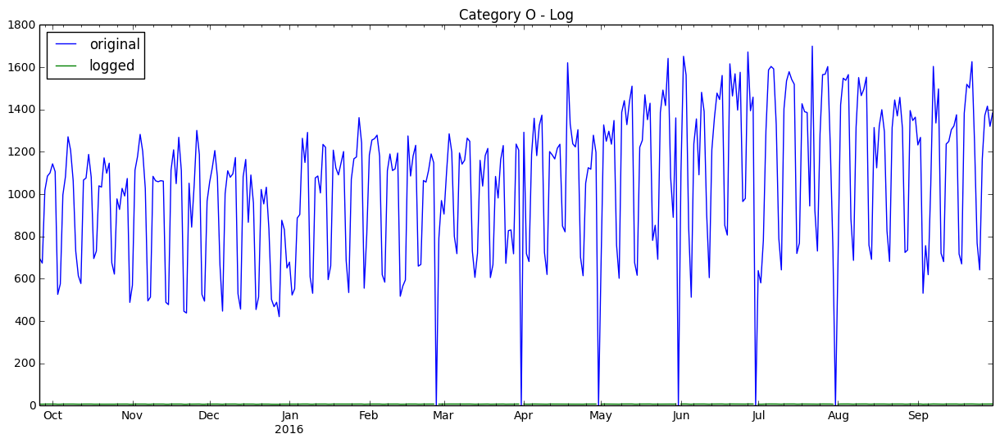

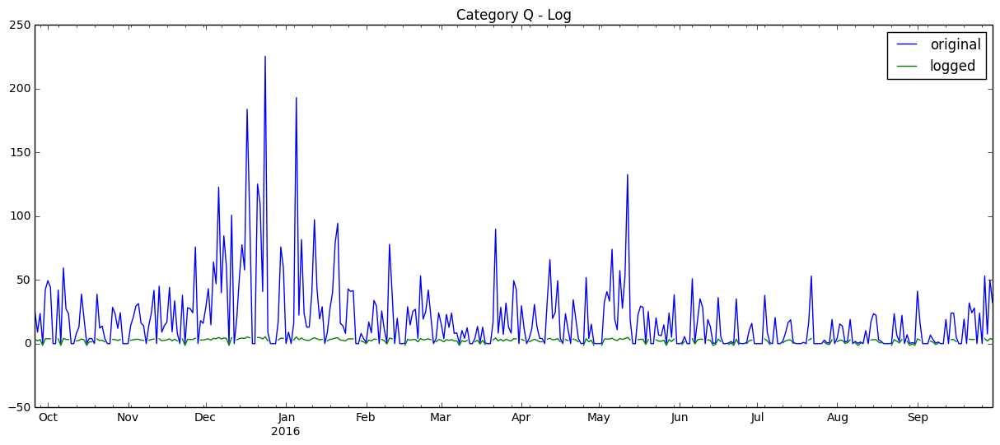

In [27]:
# Let's see the log plot.

_ = map(plot_data, splitted_data, splitted_data_log, temp_list, \
        ['Log']*len(temp_list), ['original']*len(temp_list), ['logged']*len(temp_list))

In [28]:
# Replace inf, -inf with 0...because after we log(0), we got inf values

print splitted_data_log[14]['2015-12-20']
replace_inf = lambda x: x.replace([np.inf, -np.inf], 0)
splitted_data_log = map(replace_inf, splitted_data_log)
print splitted_data_log[14]['2015-12-20']

-inf
0.0


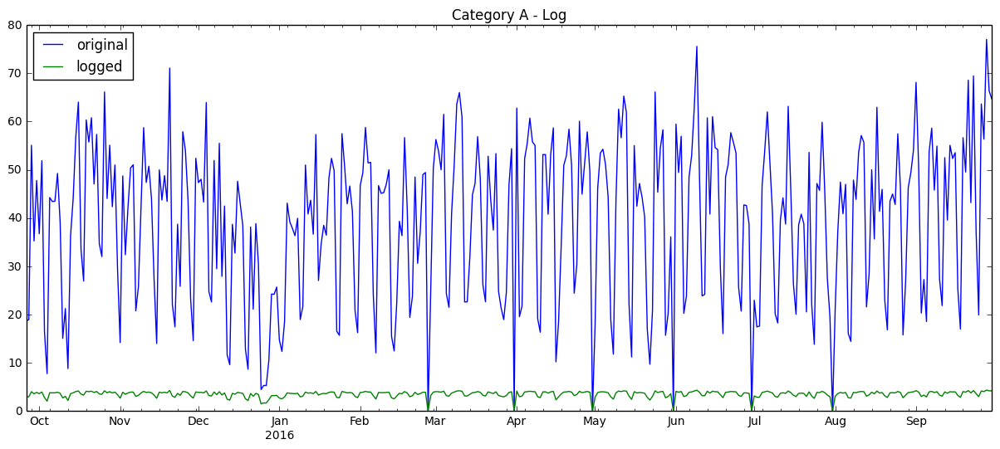

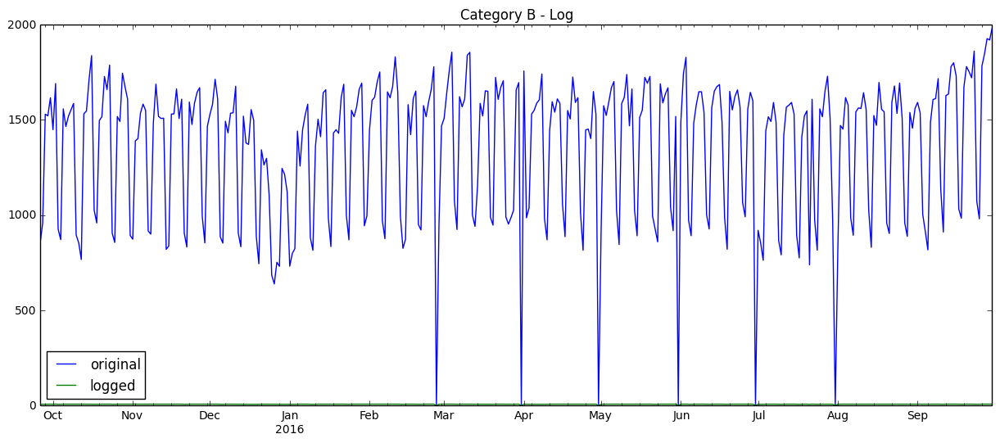

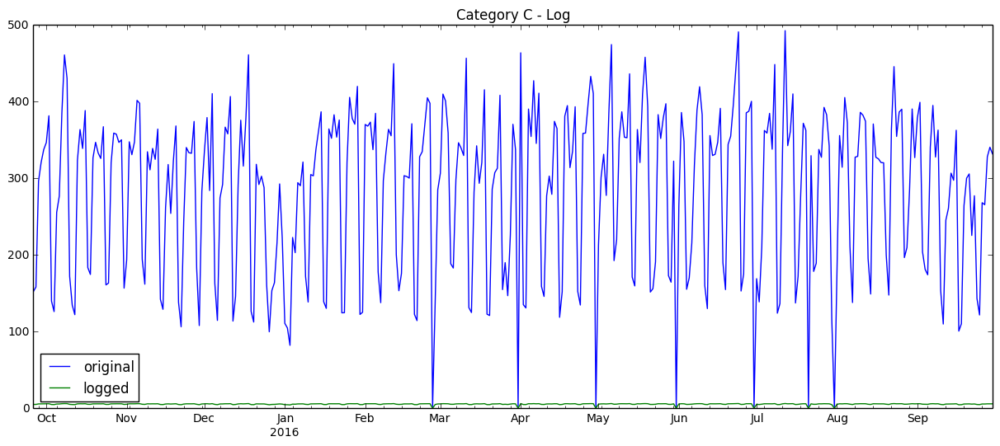

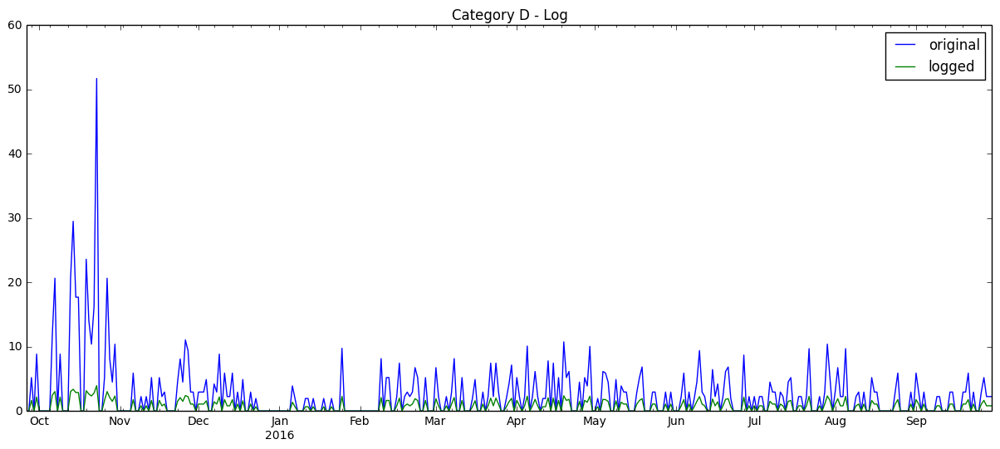

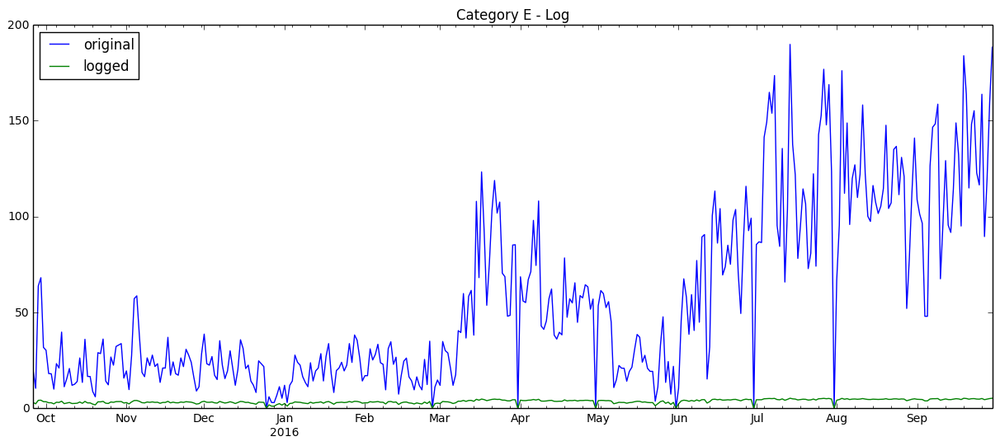

...

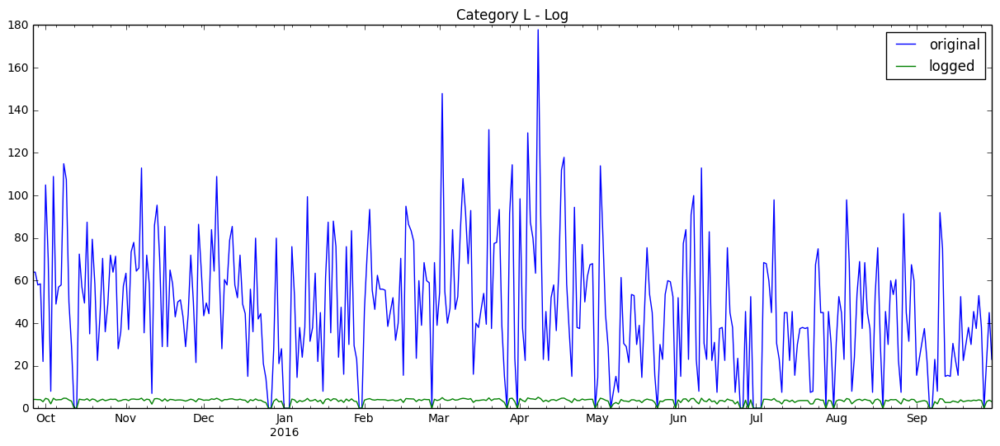

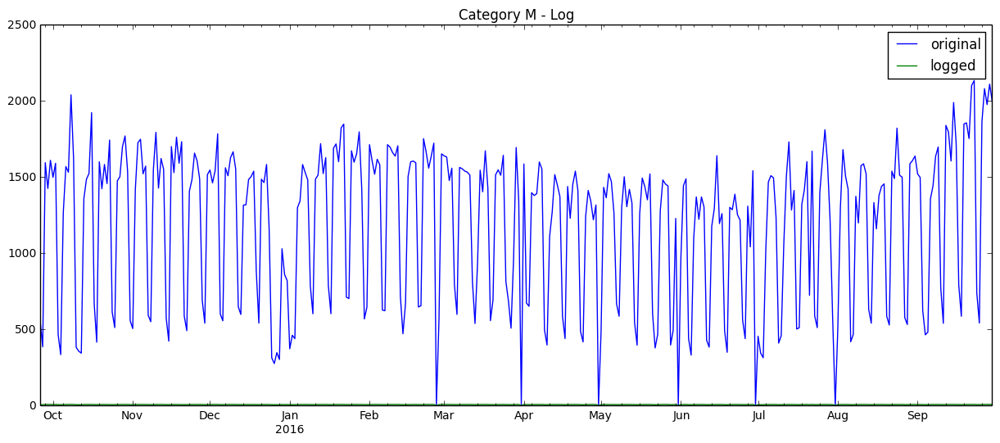

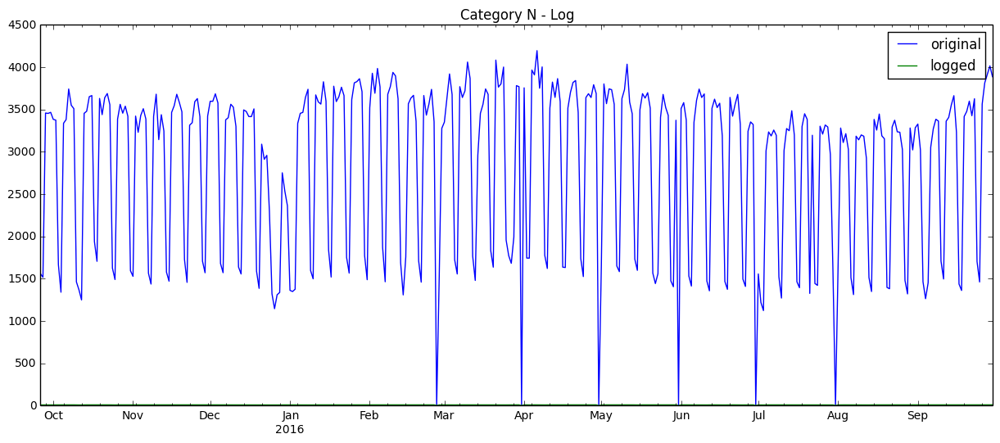

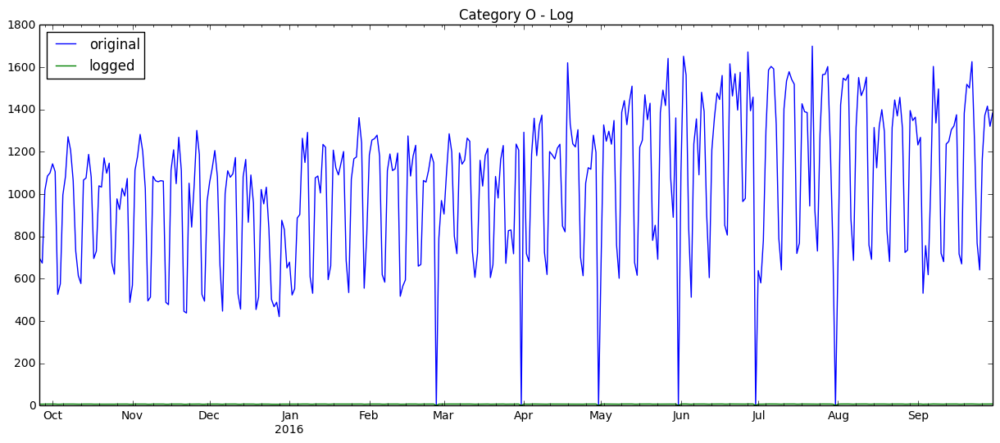

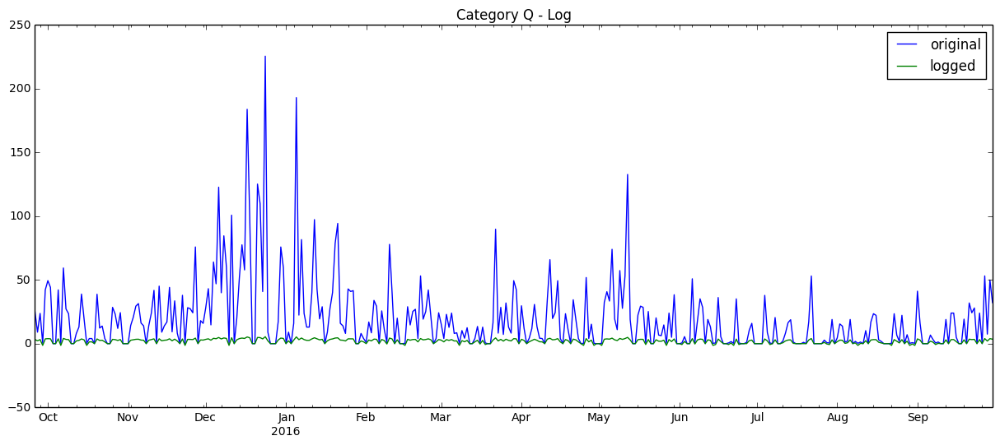

In [29]:
# Plot the log again after we replaced inf, -inf with 0.

_ = map(plot_data, splitted_data, splitted_data_log, temp_list, \
        ['Log']*len(temp_list), ['original']*len(temp_list), ['logged']*len(temp_list))

In [30]:
# Differencing to deal with the trend.
# Log first difference

def diff_data(timeseries, item):
    timeseries_diff = timeseries - timeseries.shift()
    return timeseries_diff

splitted_data_log_diff = map(diff_data, splitted_data_log, temp_list)

In [31]:
print splitted_data_log_diff[0].head()

2015-09-26         NaN
2015-09-27    0.013280
2015-09-28    1.067164
2015-09-29   -0.446503
2015-09-30    0.304560
Freq: D, Name: sales, dtype: float64


### Because we've taken a shift in the time series, the first day becomes NaN.
### We must drop the NaN for Dickey-Fuller Test to work.

/Library/Python/2.7/site-packages/ipykernel/__main__.py:6: FutureWarning: pd.rolling_mean is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).mean()
/Library/Python/2.7/site-packages/ipykernel/__main__.py:7: FutureWarning: pd.rolling_std is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).std()


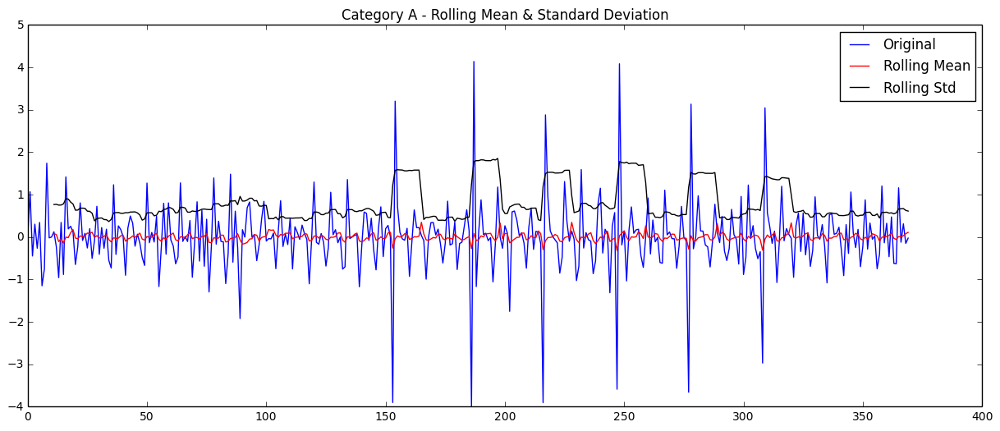

Results of Dickey-Fuller Test:
Test Statistic                -1.003329e+01
p-value                        1.564383e-17
#Lags Used                     1.200000e+01
Number of Observations Used    3.570000e+02
Critical Value (5%)           -2.869670e+00
Critical Value (1%)           -3.448801e+00
Critical Value (10%)          -2.571101e+00
dtype: float64


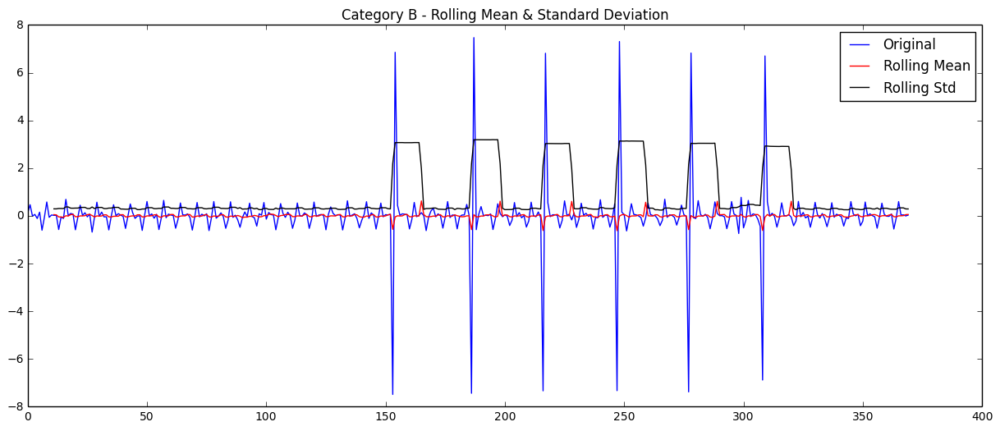

Results of Dickey-Fuller Test:
Test Statistic                -9.357712e+00
p-value                        7.976100e-16
#Lags Used                     1.200000e+01
Number of Observations Used    3.570000e+02
Critical Value (5%)           -2.869670e+00
Critical Value (1%)           -3.448801e+00
Critical Value (10%)          -2.571101e+00
dtype: float64


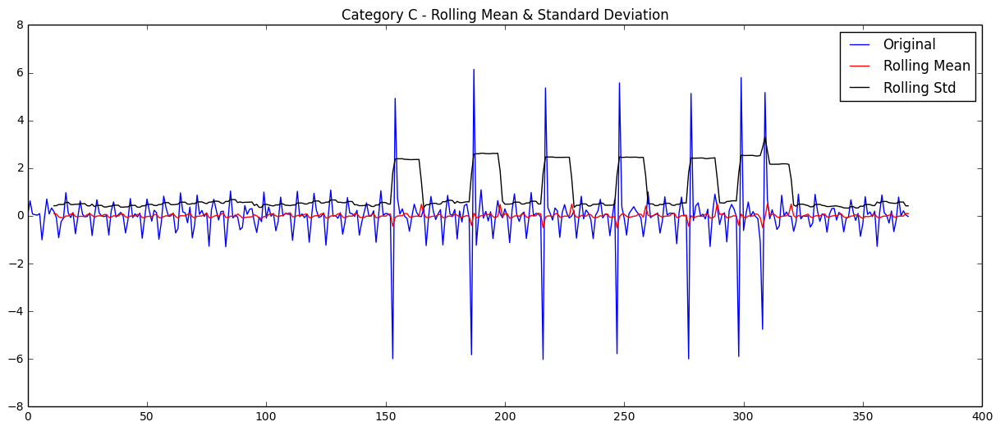

Results of Dickey-Fuller Test:
Test Statistic                -1.020148e+01
p-value                        5.954378e-18
#Lags Used                     1.200000e+01
Number of Observations Used    3.570000e+02
Critical Value (5%)           -2.869670e+00
Critical Value (1%)           -3.448801e+00
Critical Value (10%)          -2.571101e+00
dtype: float64


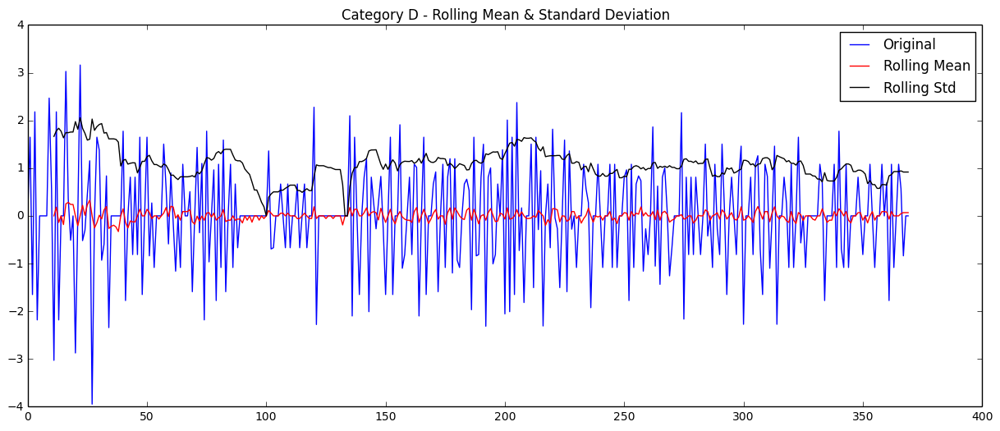

Results of Dickey-Fuller Test:
Test Statistic                -7.598689e+00
p-value                        2.421630e-11
#Lags Used                     1.200000e+01
Number of Observations Used    3.570000e+02
Critical Value (5%)           -2.869670e+00
Critical Value (1%)           -3.448801e+00
Critical Value (10%)          -2.571101e+00
dtype: float64


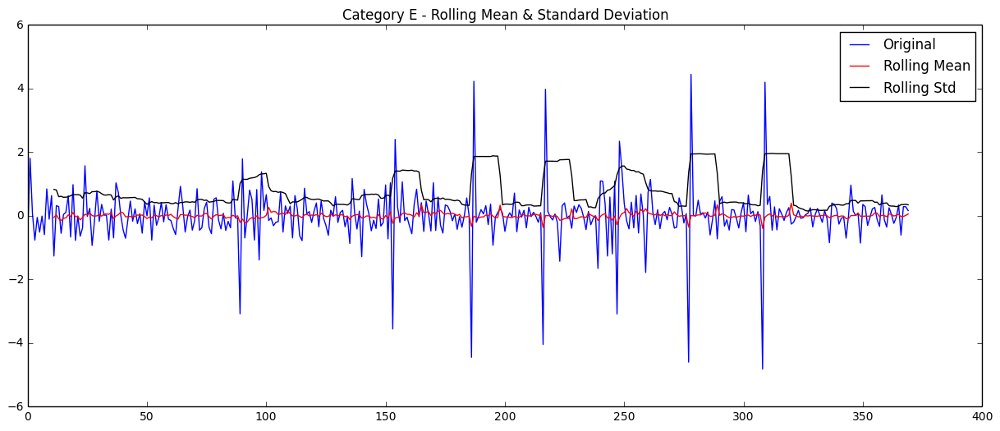

Results of Dickey-Fuller Test:
Test Statistic                -1.233968e+01
p-value                        6.158886e-23
#Lags Used                     6.000000e+00
Number of Observations Used    3.630000e+02
Critical Value (5%)           -2.869535e+00
Critical Value (1%)           -3.448494e+00
Critical Value (10%)          -2.571029e+00
dtype: float64


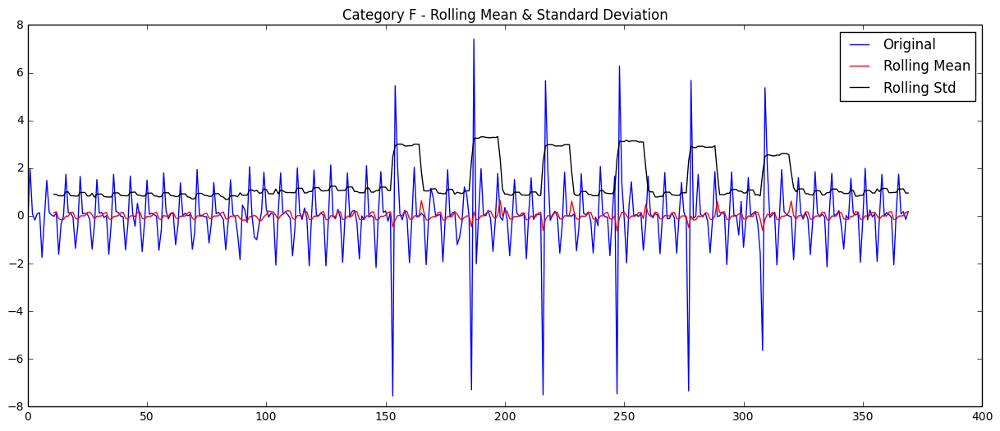

Results of Dickey-Fuller Test:
Test Statistic                -1.009398e+01
p-value                        1.103226e-17
#Lags Used                     1.200000e+01
Number of Observations Used    3.570000e+02
Critical Value (5%)           -2.869670e+00
Critical Value (1%)           -3.448801e+00
Critical Value (10%)          -2.571101e+00
dtype: float64


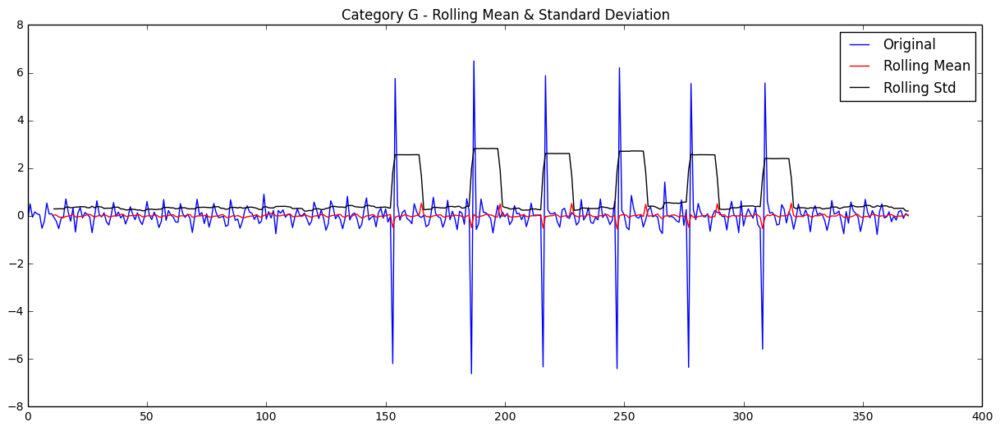

Results of Dickey-Fuller Test:
Test Statistic                -9.743463e+00
p-value                        8.375639e-17
#Lags Used                     1.200000e+01
Number of Observations Used    3.570000e+02
Critical Value (5%)           -2.869670e+00
Critical Value (1%)           -3.448801e+00
Critical Value (10%)          -2.571101e+00
dtype: float64


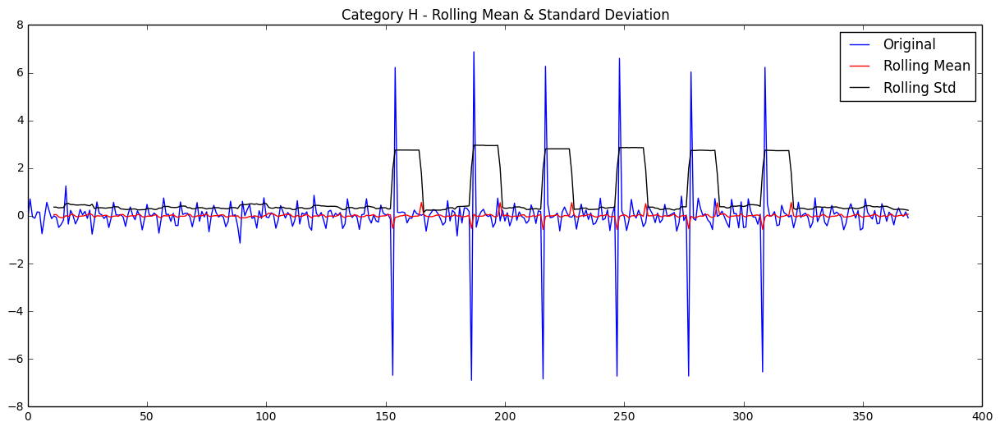

Results of Dickey-Fuller Test:
Test Statistic                -9.392599e+00
p-value                        6.500420e-16
#Lags Used                     1.200000e+01
Number of Observations Used    3.570000e+02
Critical Value (5%)           -2.869670e+00
Critical Value (1%)           -3.448801e+00
Critical Value (10%)          -2.571101e+00
dtype: float64


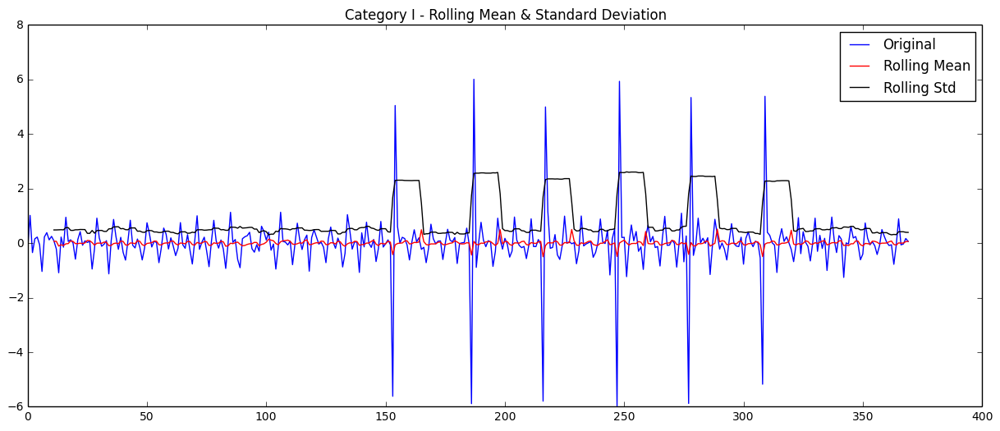

Results of Dickey-Fuller Test:
Test Statistic                -1.009561e+01
p-value                        1.092944e-17
#Lags Used                     1.200000e+01
Number of Observations Used    3.570000e+02
Critical Value (5%)           -2.869670e+00
Critical Value (1%)           -3.448801e+00
Critical Value (10%)          -2.571101e+00
dtype: float64


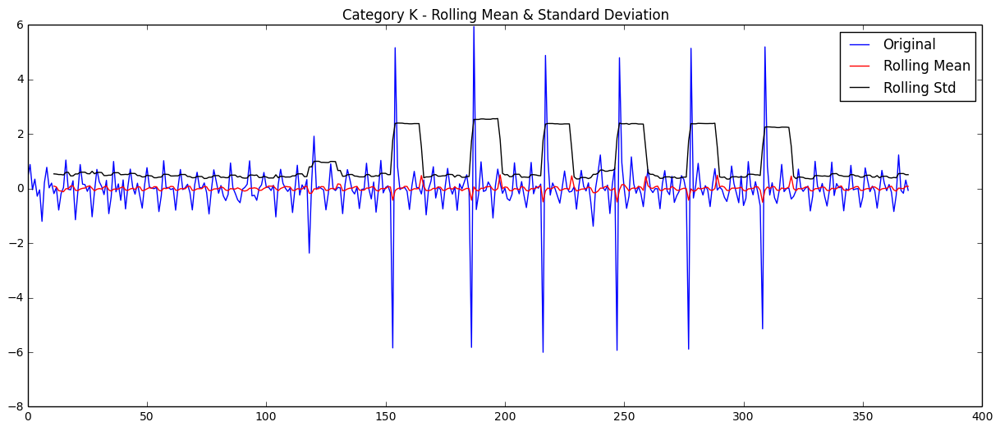

Results of Dickey-Fuller Test:
Test Statistic                -9.934086e+00
p-value                        2.773230e-17
#Lags Used                     1.200000e+01
Number of Observations Used    3.570000e+02
Critical Value (5%)           -2.869670e+00
Critical Value (1%)           -3.448801e+00
Critical Value (10%)          -2.571101e+00
dtype: float64


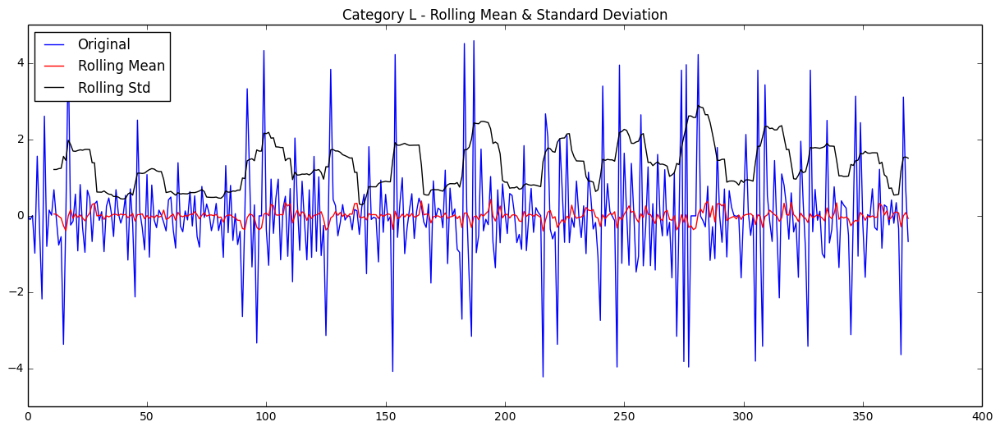

Results of Dickey-Fuller Test:
Test Statistic                -1.469026e+01
p-value                        3.057415e-27
#Lags Used                     5.000000e+00
Number of Observations Used    3.640000e+02
Critical Value (5%)           -2.869513e+00
Critical Value (1%)           -3.448443e+00
Critical Value (10%)          -2.571018e+00
dtype: float64


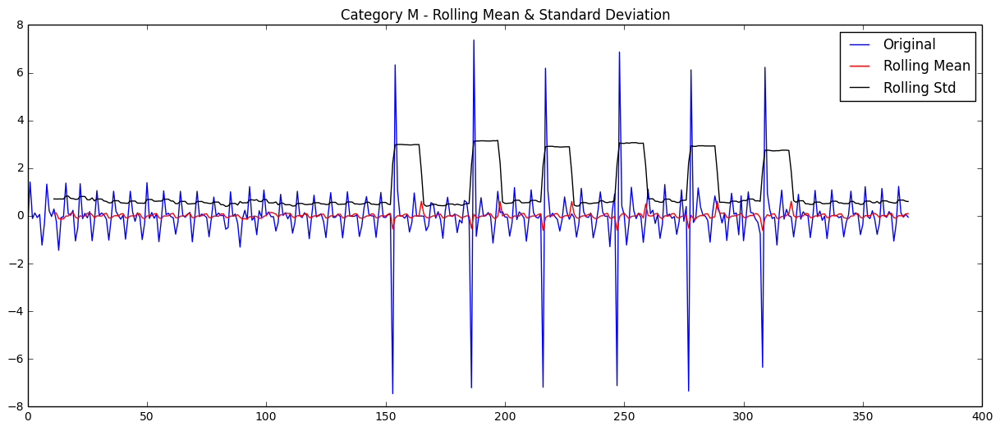

Results of Dickey-Fuller Test:
Test Statistic                -9.828106e+00
p-value                        5.122964e-17
#Lags Used                     1.200000e+01
Number of Observations Used    3.570000e+02
Critical Value (5%)           -2.869670e+00
Critical Value (1%)           -3.448801e+00
Critical Value (10%)          -2.571101e+00
dtype: float64


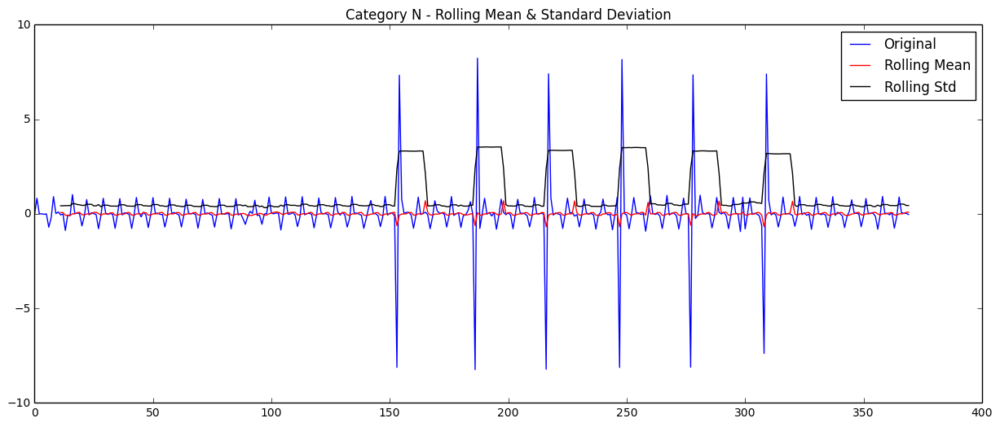

Results of Dickey-Fuller Test:
Test Statistic                -9.583085e+00
p-value                        2.132526e-16
#Lags Used                     1.200000e+01
Number of Observations Used    3.570000e+02
Critical Value (5%)           -2.869670e+00
Critical Value (1%)           -3.448801e+00
Critical Value (10%)          -2.571101e+00
dtype: float64


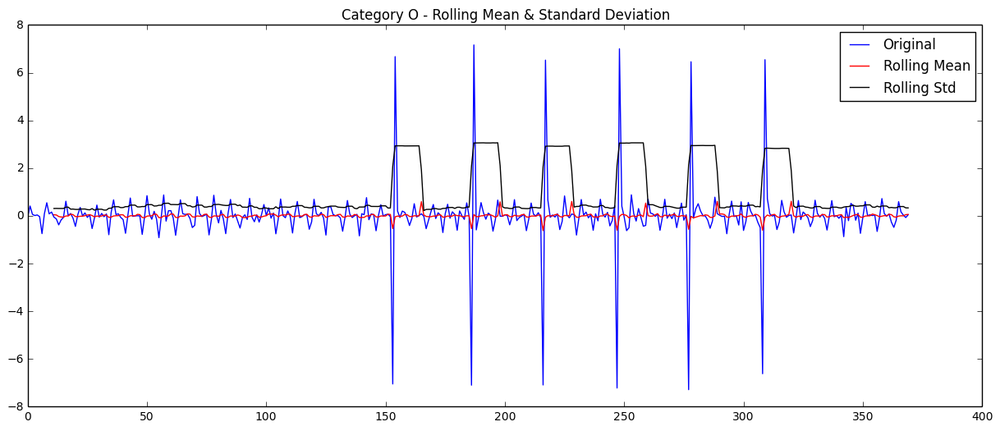

Results of Dickey-Fuller Test:
Test Statistic                -9.528090e+00
p-value                        2.940639e-16
#Lags Used                     1.200000e+01
Number of Observations Used    3.570000e+02
Critical Value (5%)           -2.869670e+00
Critical Value (1%)           -3.448801e+00
Critical Value (10%)          -2.571101e+00
dtype: float64


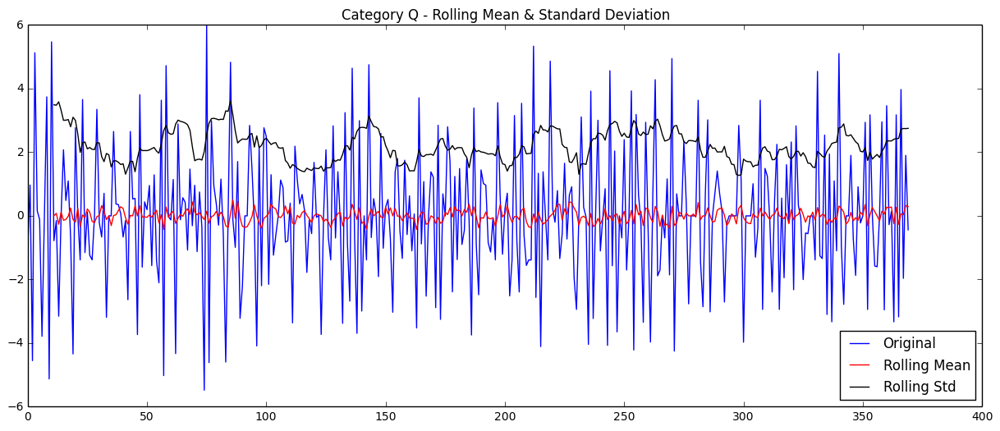

Results of Dickey-Fuller Test:
Test Statistic                -8.593633e+00
p-value                        7.174509e-14
#Lags Used                     1.300000e+01
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


In [32]:
_ = map(lambda x: x.dropna(inplace=True), splitted_data_log_diff)
_ = map(test_stationarity, splitted_data_log_diff, temp_list)

### - Mostly looks good, and mostly becomes stationary at least 95% confidence!
### - Now let's deal with seasonality

In [33]:
# Differencing to deal with seasonality...
# Log seasonal difference

splitted_data_log_diff_season = map(lambda x: x - x.shift(7), splitted_data_log_diff)
_ = map(lambda x: x.dropna(inplace=True), splitted_data_log_diff_season)

/Library/Python/2.7/site-packages/ipykernel/__main__.py:6: FutureWarning: pd.rolling_mean is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).mean()
/Library/Python/2.7/site-packages/ipykernel/__main__.py:7: FutureWarning: pd.rolling_std is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).std()


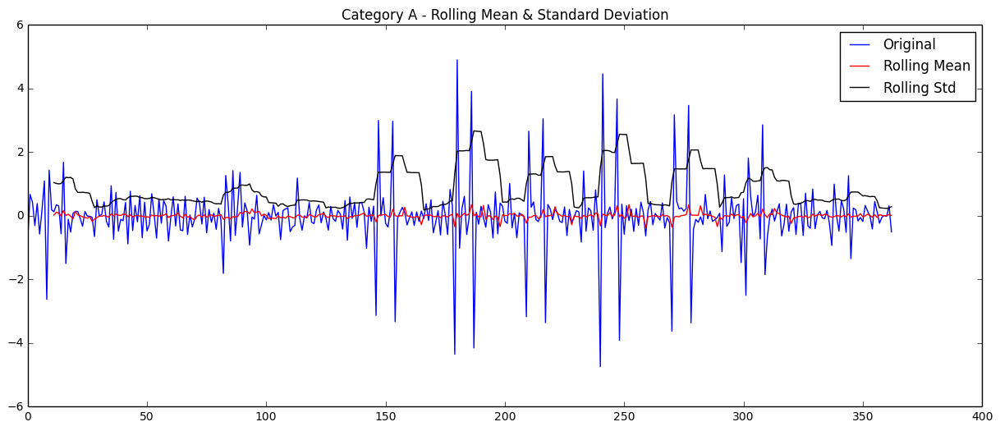

Results of Dickey-Fuller Test:
Test Statistic                -9.521145e+00
p-value                        3.062506e-16
#Lags Used                     1.500000e+01
Number of Observations Used    3.470000e+02
Critical Value (5%)           -2.869906e+00
Critical Value (1%)           -3.449337e+00
Critical Value (10%)          -2.571227e+00
dtype: float64


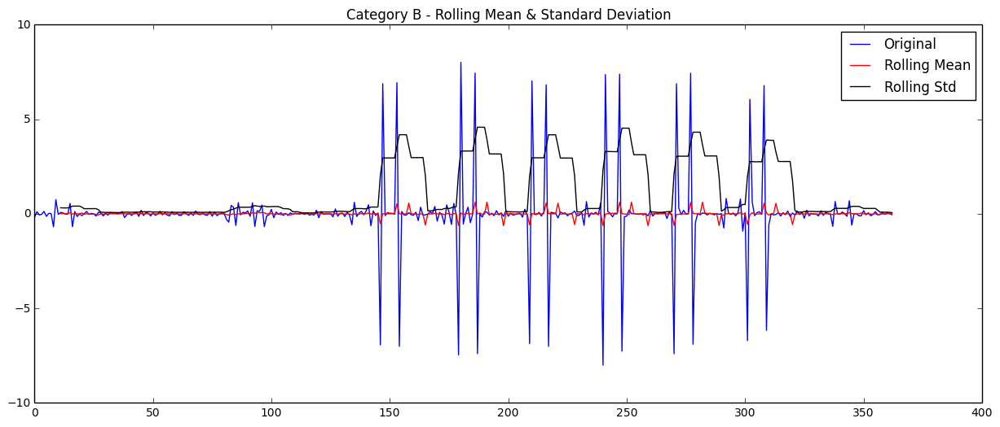

Results of Dickey-Fuller Test:
Test Statistic                -8.986612e+00
p-value                        7.072954e-15
#Lags Used                     1.700000e+01
Number of Observations Used    3.450000e+02
Critical Value (5%)           -2.869954e+00
Critical Value (1%)           -3.449447e+00
Critical Value (10%)          -2.571253e+00
dtype: float64


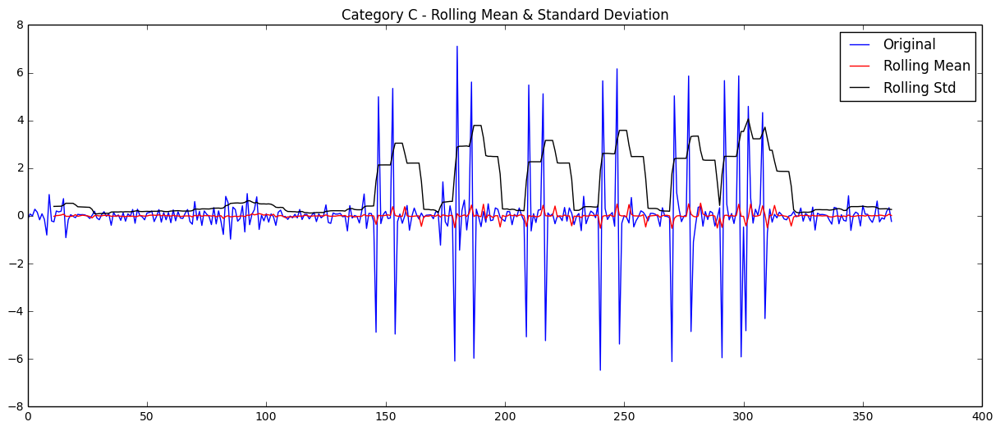

Results of Dickey-Fuller Test:
Test Statistic                -9.184246e+00
p-value                        2.209532e-15
#Lags Used                     1.700000e+01
Number of Observations Used    3.450000e+02
Critical Value (5%)           -2.869954e+00
Critical Value (1%)           -3.449447e+00
Critical Value (10%)          -2.571253e+00
dtype: float64


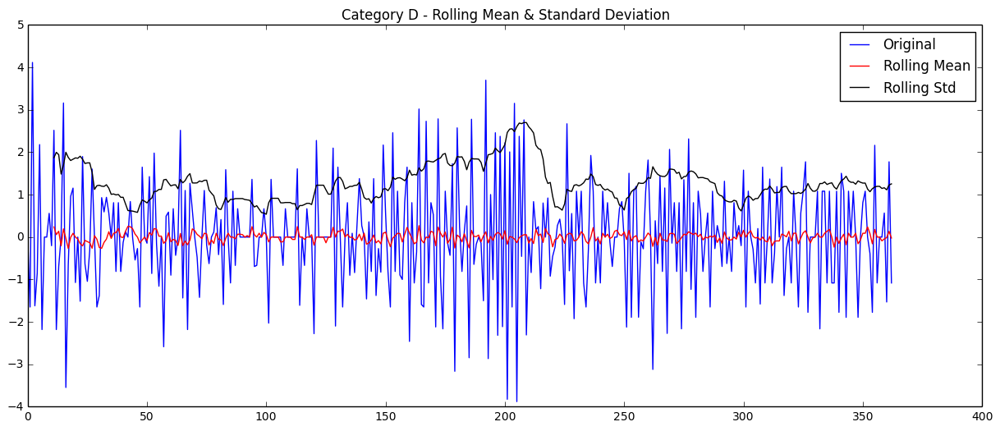

Results of Dickey-Fuller Test:
Test Statistic                -8.509649e+00
p-value                        1.176899e-13
#Lags Used                     1.500000e+01
Number of Observations Used    3.470000e+02
Critical Value (5%)           -2.869906e+00
Critical Value (1%)           -3.449337e+00
Critical Value (10%)          -2.571227e+00
dtype: float64


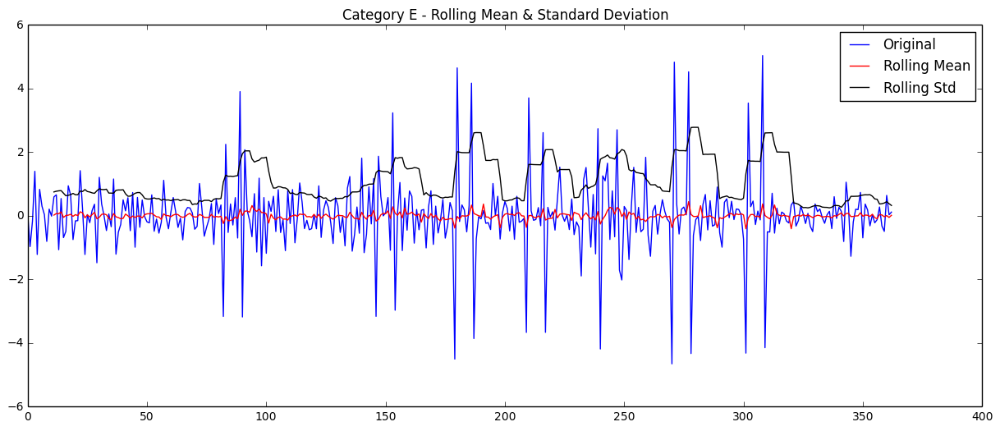

Results of Dickey-Fuller Test:
Test Statistic                -8.333474e+00
p-value                        3.320172e-13
#Lags Used                     1.700000e+01
Number of Observations Used    3.450000e+02
Critical Value (5%)           -2.869954e+00
Critical Value (1%)           -3.449447e+00
Critical Value (10%)          -2.571253e+00
dtype: float64


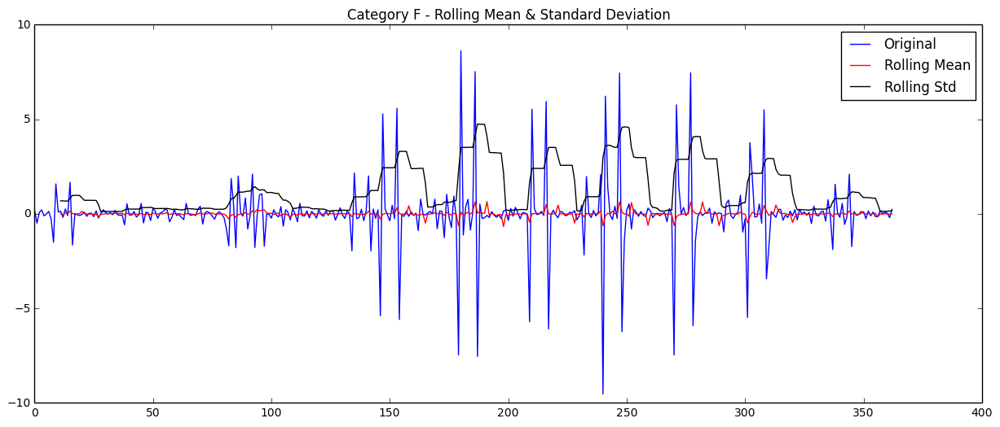

Results of Dickey-Fuller Test:
Test Statistic                -8.691044e+00
p-value                        4.039933e-14
#Lags Used                     1.700000e+01
Number of Observations Used    3.450000e+02
Critical Value (5%)           -2.869954e+00
Critical Value (1%)           -3.449447e+00
Critical Value (10%)          -2.571253e+00
dtype: float64


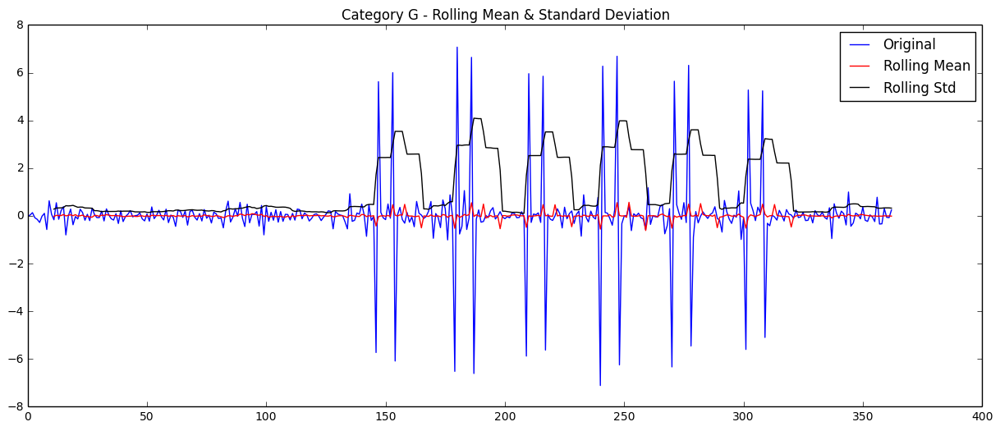

Results of Dickey-Fuller Test:
Test Statistic                -9.290724e+00
p-value                        1.181792e-15
#Lags Used                     1.700000e+01
Number of Observations Used    3.450000e+02
Critical Value (5%)           -2.869954e+00
Critical Value (1%)           -3.449447e+00
Critical Value (10%)          -2.571253e+00
dtype: float64


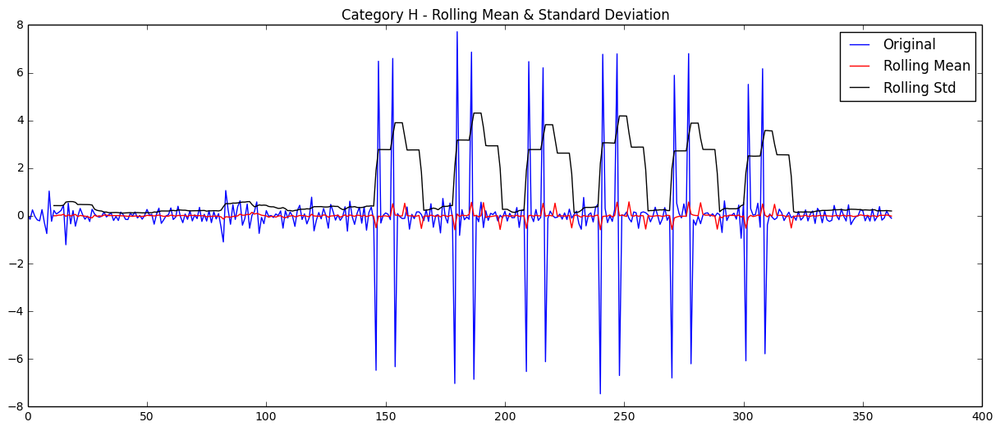

Results of Dickey-Fuller Test:
Test Statistic                -8.780907e+00
p-value                        2.378179e-14
#Lags Used                     1.700000e+01
Number of Observations Used    3.450000e+02
Critical Value (5%)           -2.869954e+00
Critical Value (1%)           -3.449447e+00
Critical Value (10%)          -2.571253e+00
dtype: float64


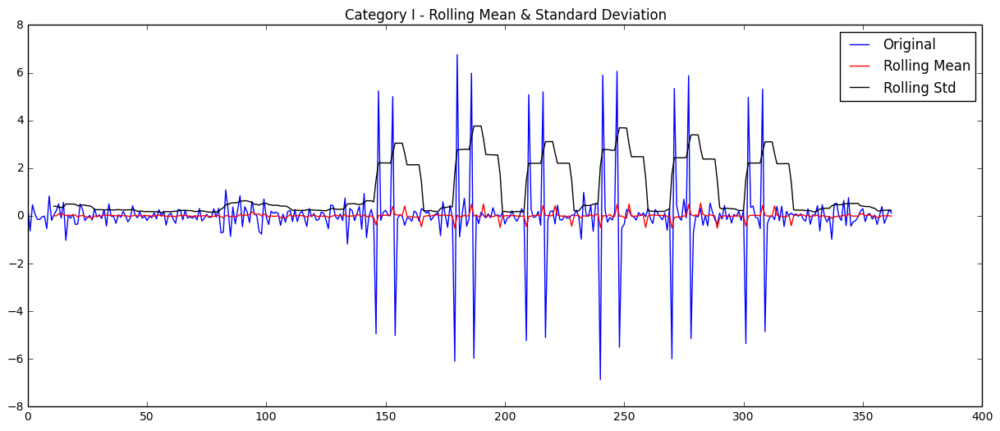

Results of Dickey-Fuller Test:
Test Statistic                -9.205941e+00
p-value                        1.944904e-15
#Lags Used                     1.700000e+01
Number of Observations Used    3.450000e+02
Critical Value (5%)           -2.869954e+00
Critical Value (1%)           -3.449447e+00
Critical Value (10%)          -2.571253e+00
dtype: float64


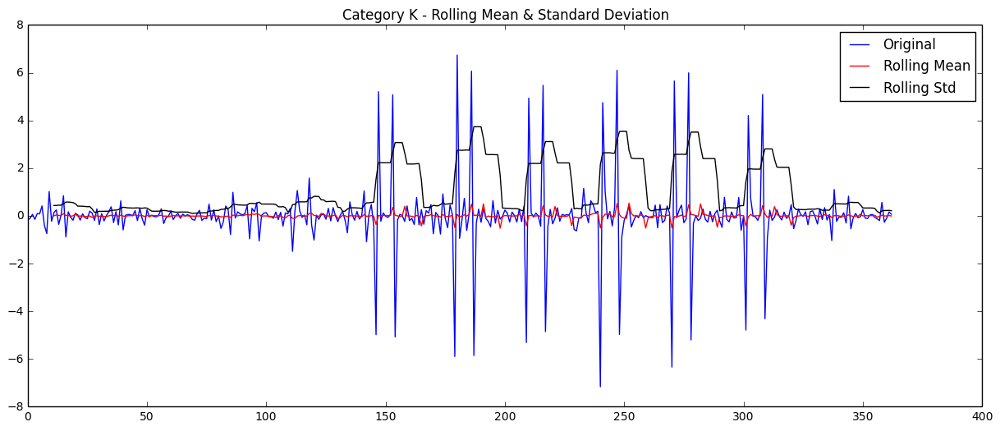

Results of Dickey-Fuller Test:
Test Statistic                -8.647180e+00
p-value                        5.232352e-14
#Lags Used                     1.700000e+01
Number of Observations Used    3.450000e+02
Critical Value (5%)           -2.869954e+00
Critical Value (1%)           -3.449447e+00
Critical Value (10%)          -2.571253e+00
dtype: float64


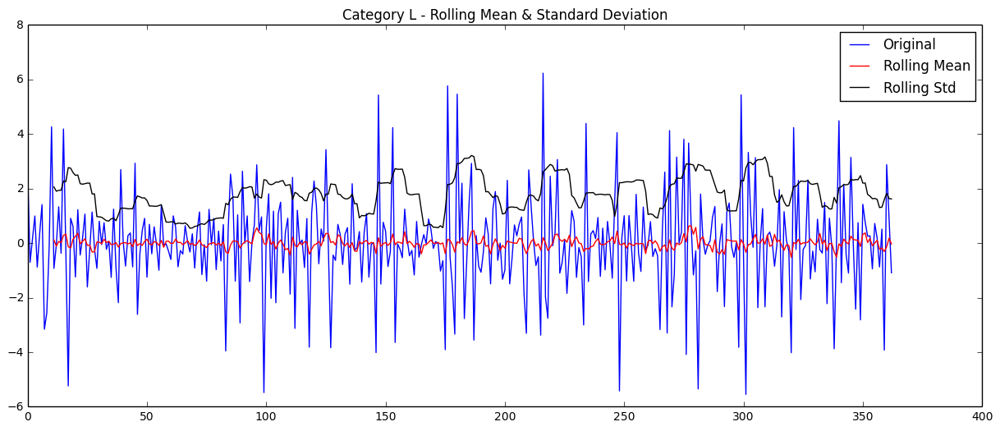

Results of Dickey-Fuller Test:
Test Statistic                -8.647264e+00
p-value                        5.229746e-14
#Lags Used                     1.700000e+01
Number of Observations Used    3.450000e+02
Critical Value (5%)           -2.869954e+00
Critical Value (1%)           -3.449447e+00
Critical Value (10%)          -2.571253e+00
dtype: float64


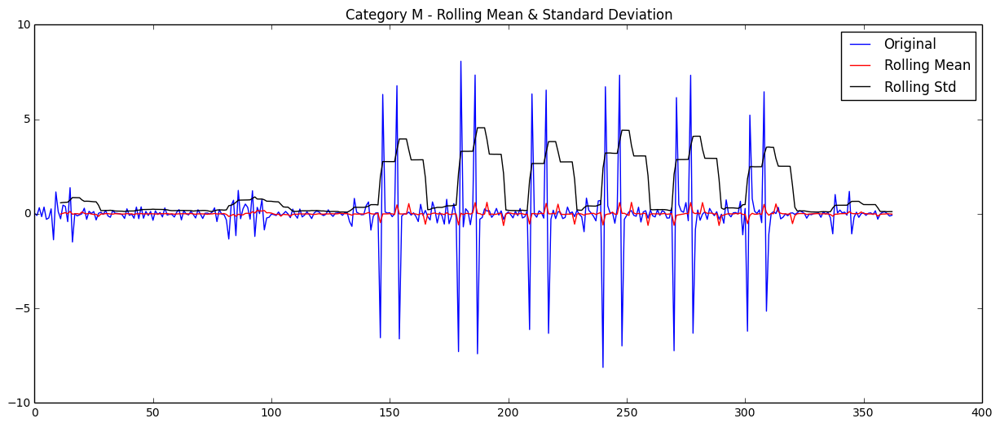

Results of Dickey-Fuller Test:
Test Statistic                -8.979364e+00
p-value                        7.381581e-15
#Lags Used                     1.700000e+01
Number of Observations Used    3.450000e+02
Critical Value (5%)           -2.869954e+00
Critical Value (1%)           -3.449447e+00
Critical Value (10%)          -2.571253e+00
dtype: float64


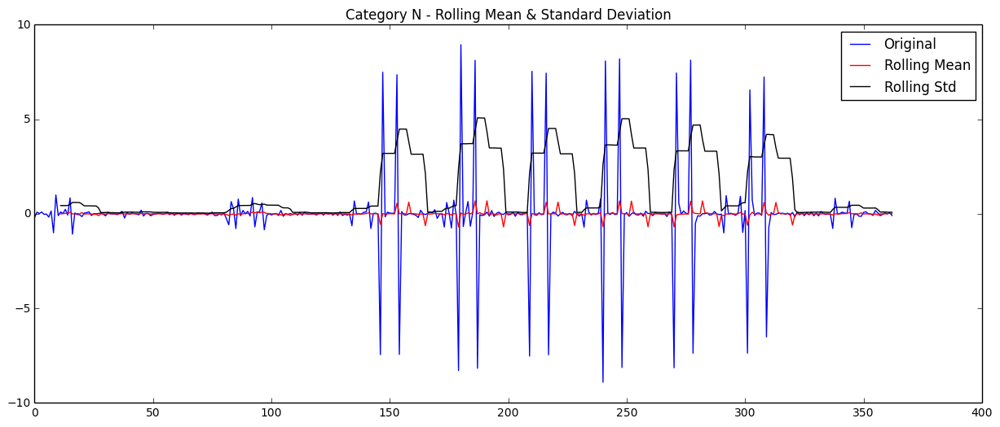

Results of Dickey-Fuller Test:
Test Statistic                -8.921127e+00
p-value                        1.040413e-14
#Lags Used                     1.700000e+01
Number of Observations Used    3.450000e+02
Critical Value (5%)           -2.869954e+00
Critical Value (1%)           -3.449447e+00
Critical Value (10%)          -2.571253e+00
dtype: float64


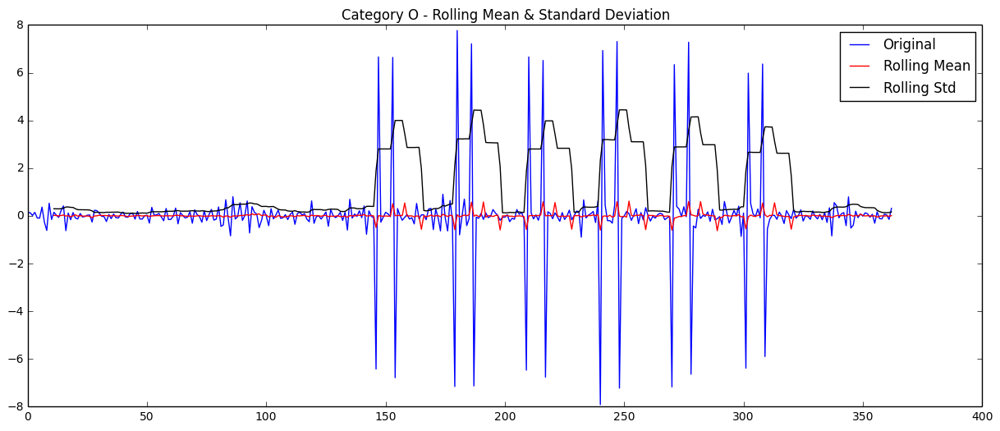

Results of Dickey-Fuller Test:
Test Statistic                -9.013231e+00
p-value                        6.046341e-15
#Lags Used                     1.700000e+01
Number of Observations Used    3.450000e+02
Critical Value (5%)           -2.869954e+00
Critical Value (1%)           -3.449447e+00
Critical Value (10%)          -2.571253e+00
dtype: float64


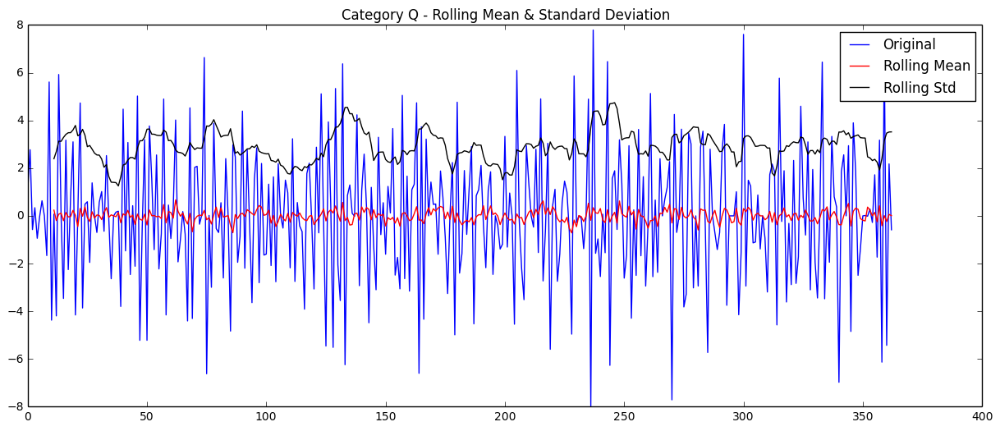

Results of Dickey-Fuller Test:
Test Statistic                -8.826796e+00
p-value                        1.814389e-14
#Lags Used                     1.700000e+01
Number of Observations Used    3.450000e+02
Critical Value (5%)           -2.869954e+00
Critical Value (1%)           -3.449447e+00
Critical Value (10%)          -2.571253e+00
dtype: float64


In [34]:
# Let's see the Dickey-Fuller test after taking the log, diff, & season diff...

_ = map(test_stationarity, splitted_data_log_diff_season, temp_list)

### All the test statistics look really good.
### Next step is to visualize the ACF/PACF plots to determine we will use MA, AR, or ARIMA model.

# Step 3.2) ACF/PACF Plots for
## - Observed data
## - Log transformed data
## - Diff Log transformed data
## - Seasonal Diff Log transformed data

In [35]:
def acf_pacf_plot(timeseries, title, item, lags=30):
    fig = plt.figure(figsize=(12,8))
    ax1 = fig.add_subplot(211)
    fig = sm.graphics.tsa.plot_acf(timeseries, lags=lags, ax=ax1)
    ax2 = fig.add_subplot(212)
    fig = sm.graphics.tsa.plot_pacf(timeseries, lags=lags, ax=ax2)
    fig.suptitle('Category {} - {} ACF/PACF Plot'.format(item, title), fontsize=20)

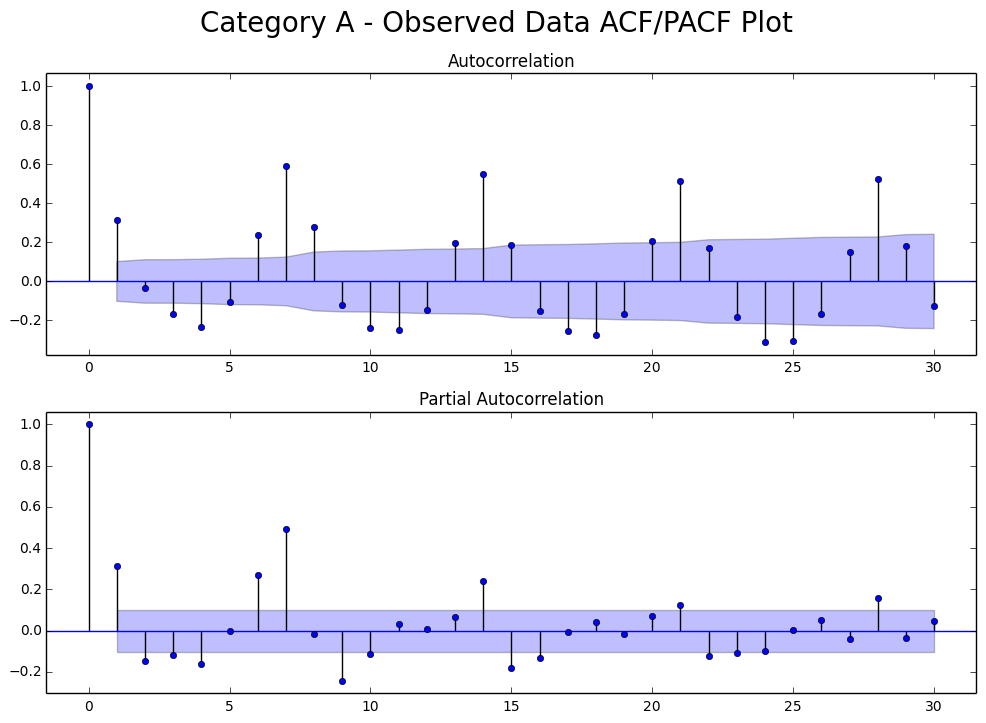

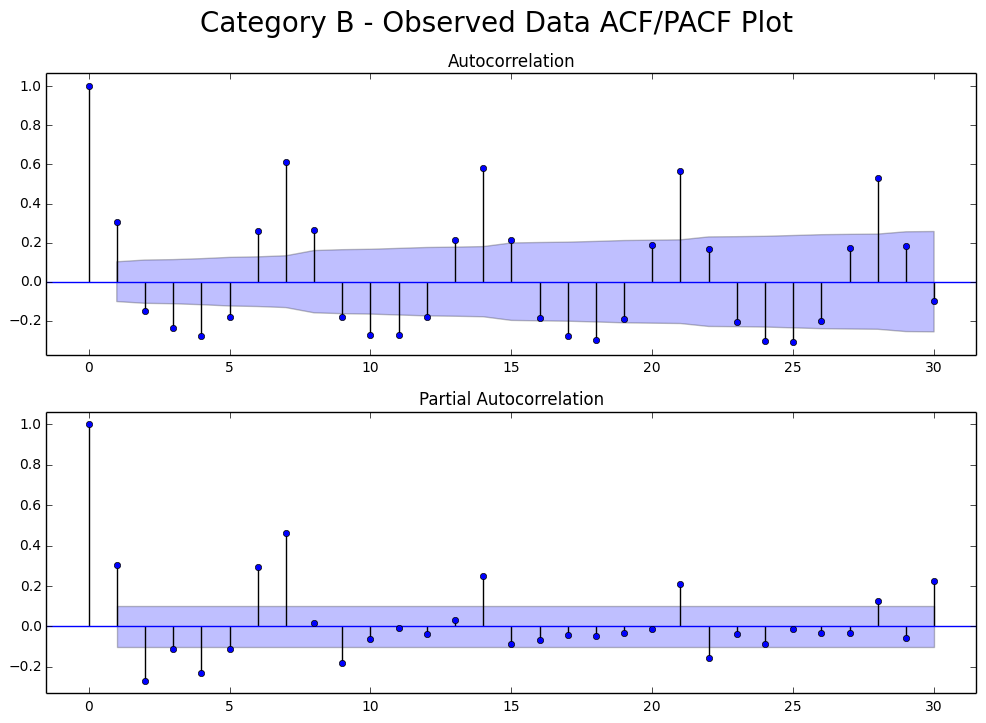

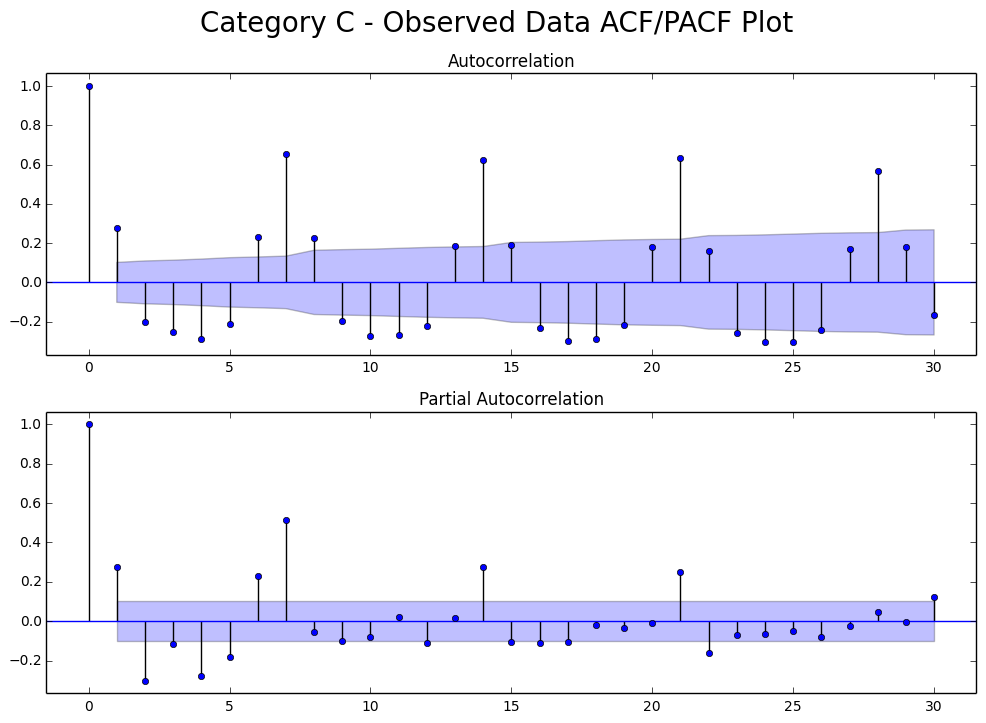

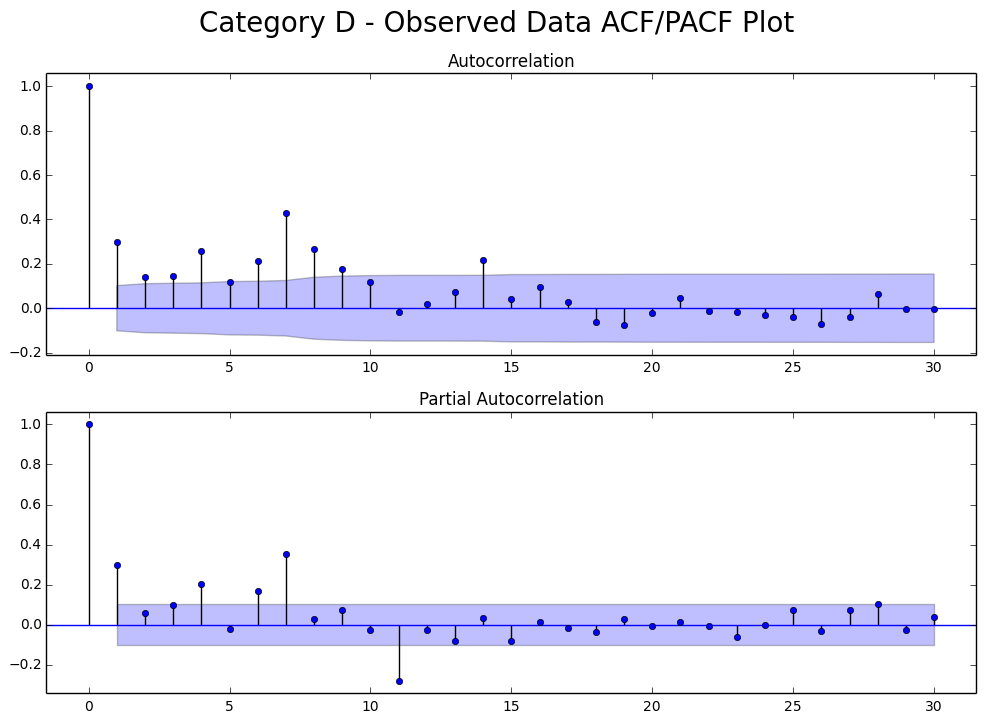

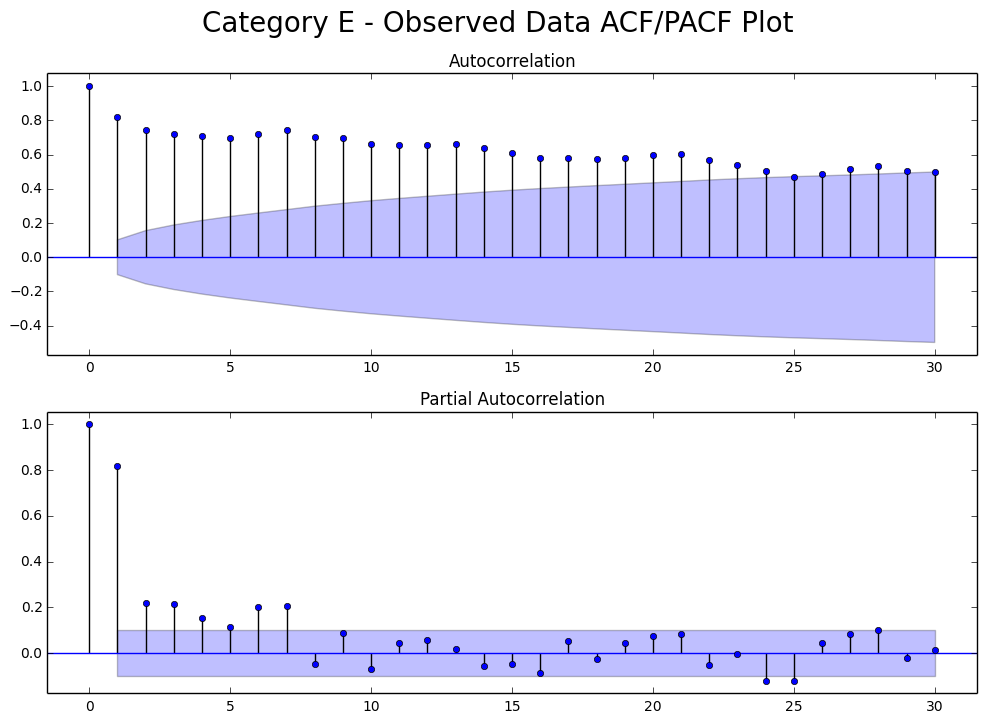

...

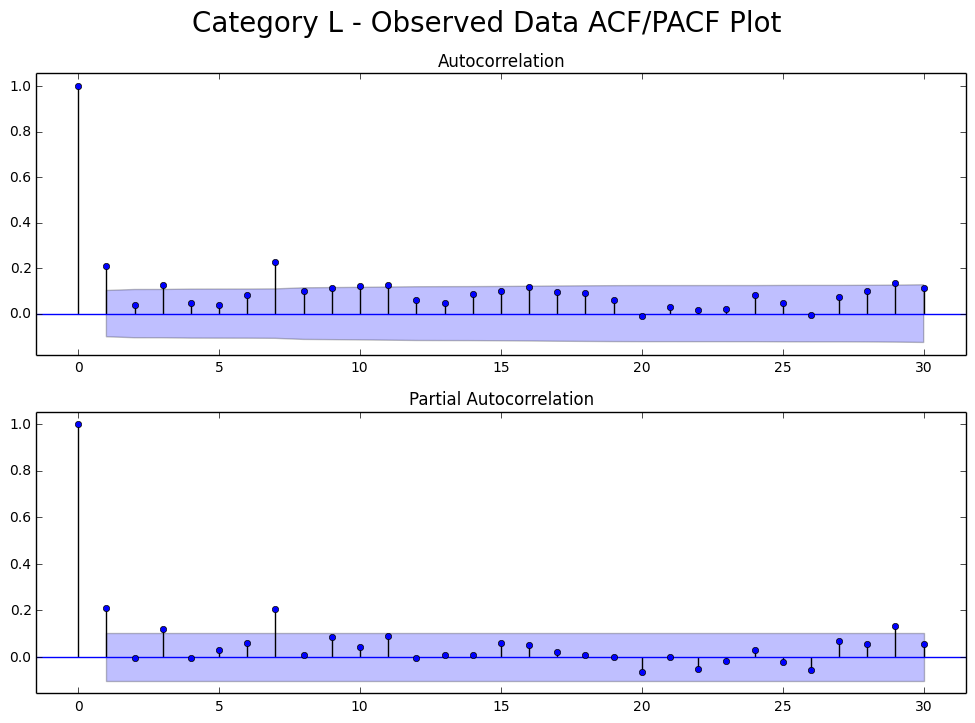

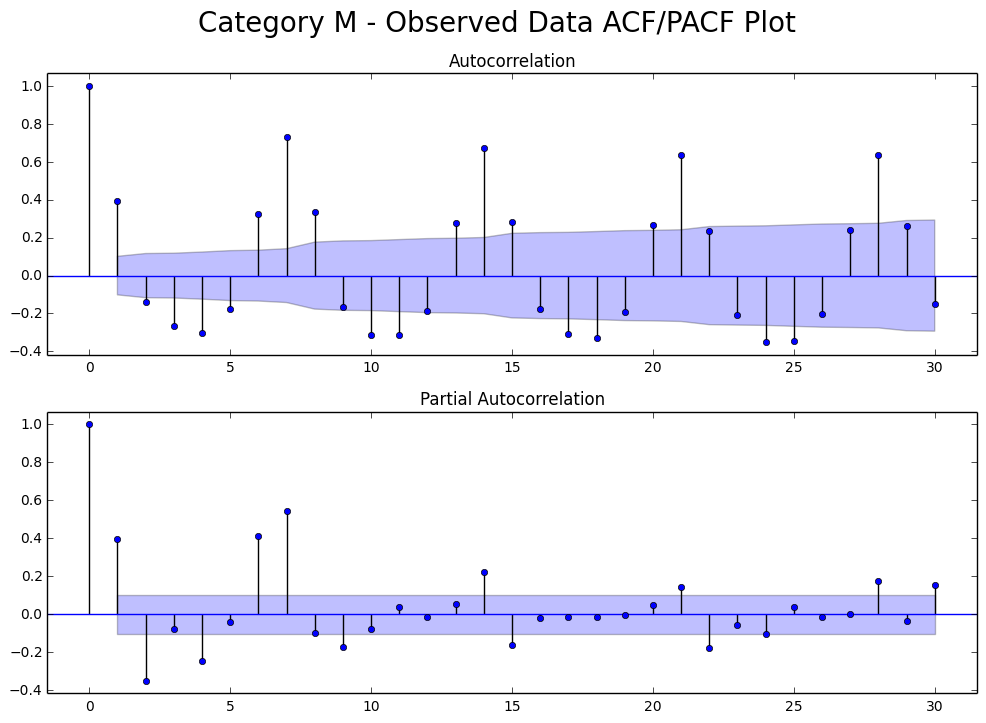

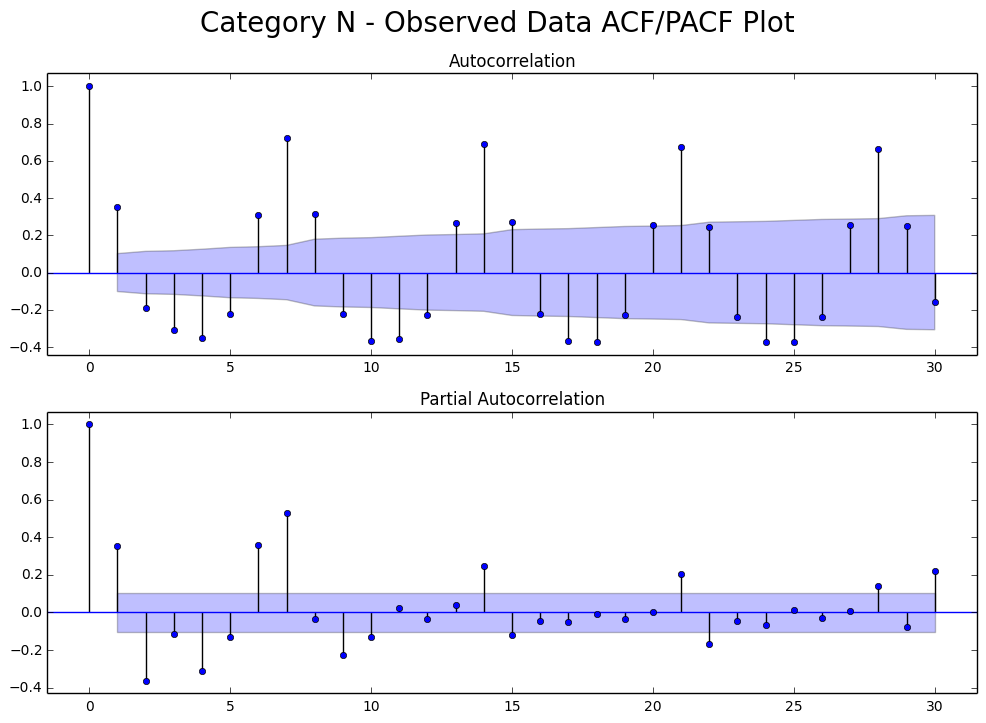

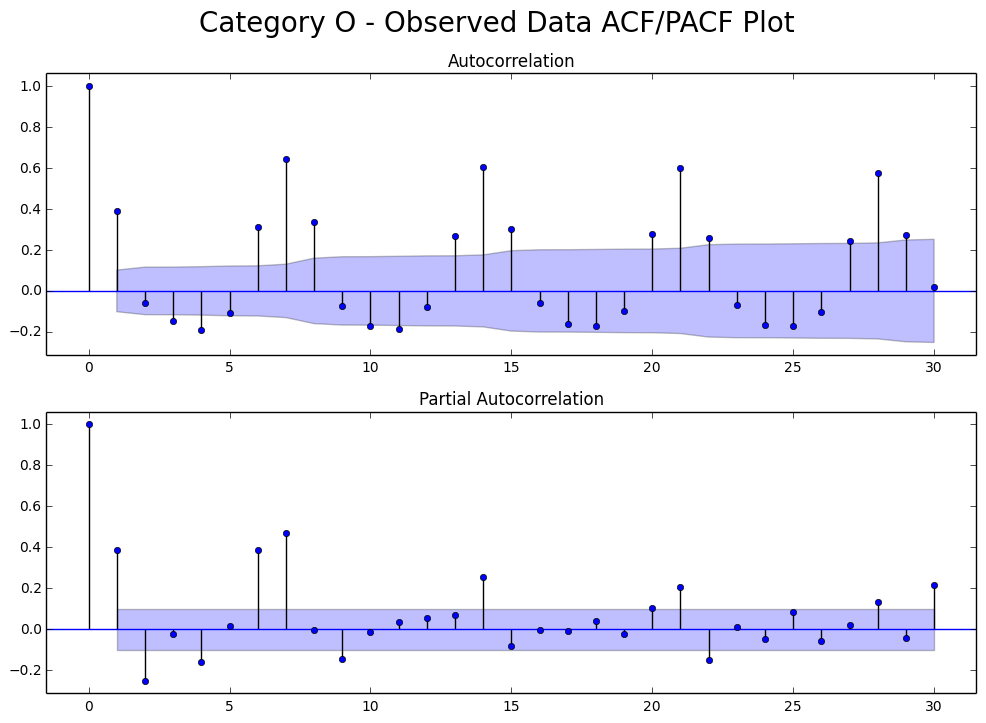

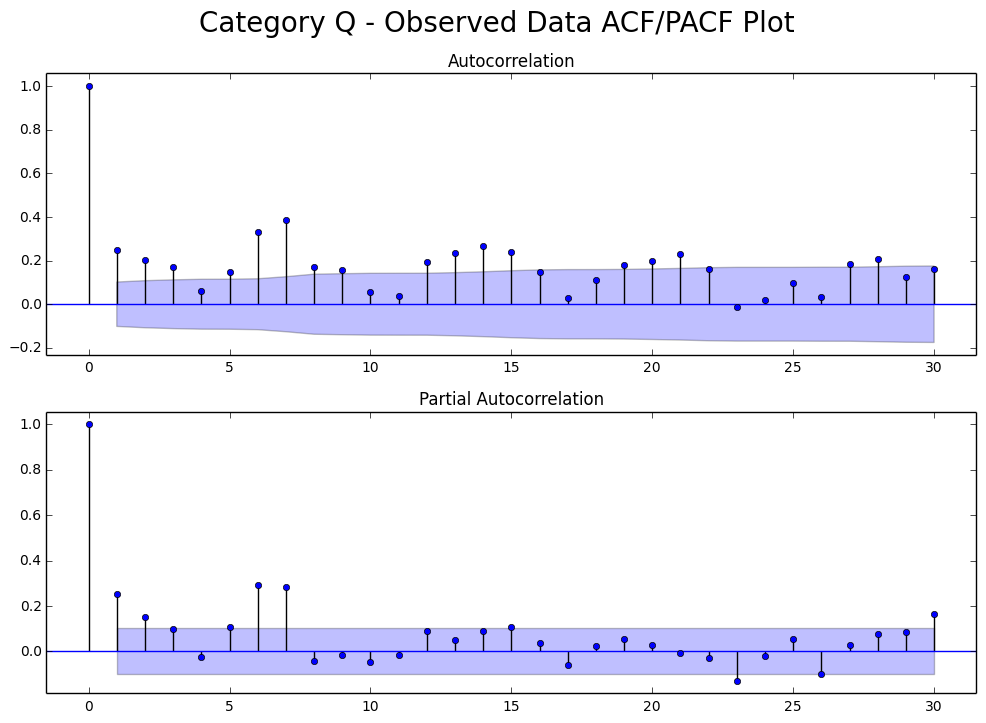

In [37]:
# Observed data ACF/PACF plot.

_ = map(acf_pacf_plot, splitted_data, ['Observed Data']*len(temp_list), temp_list)

## We observe all categories have both ACF/PACF tails off
### - It's really hard to tell if there is any cut off.
### - Maybe ARIMA(1, 1, 1)?
### - We will try to log it and detrend it.

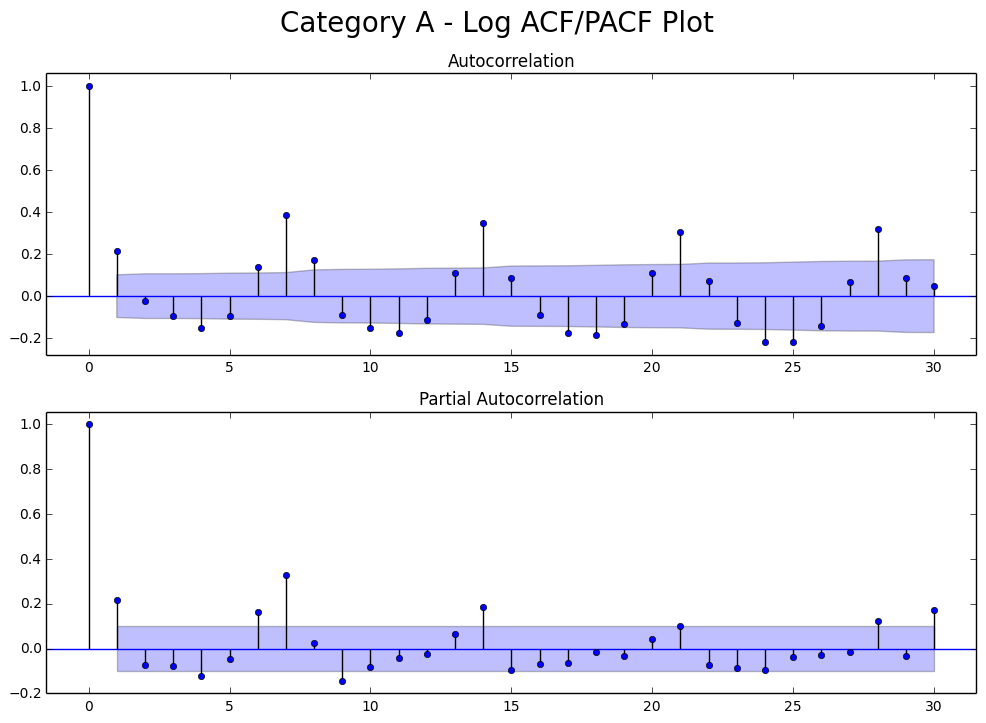

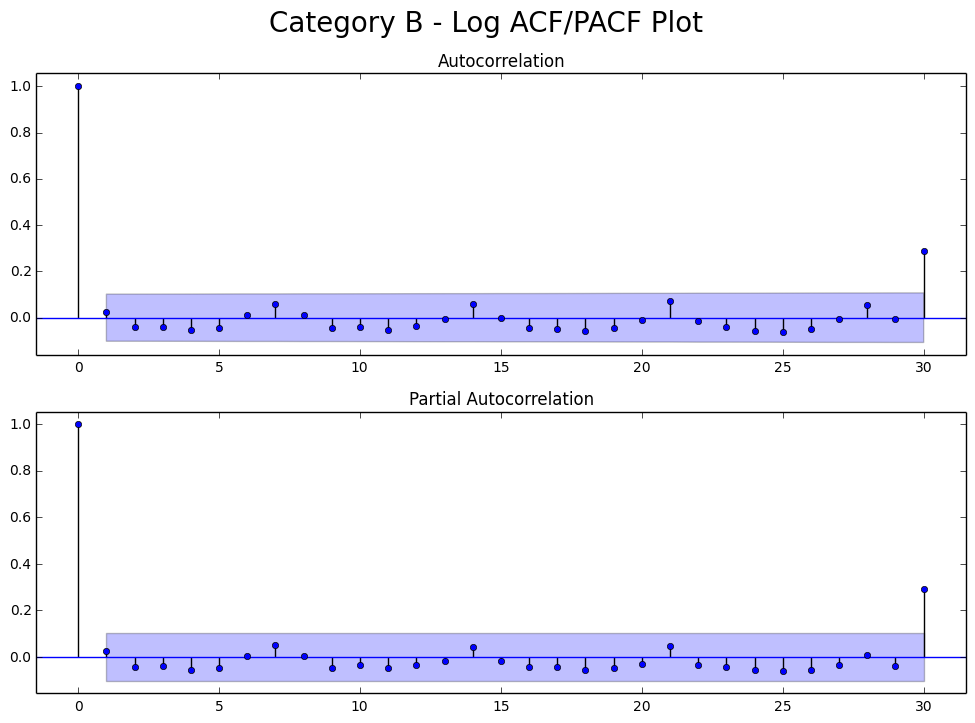

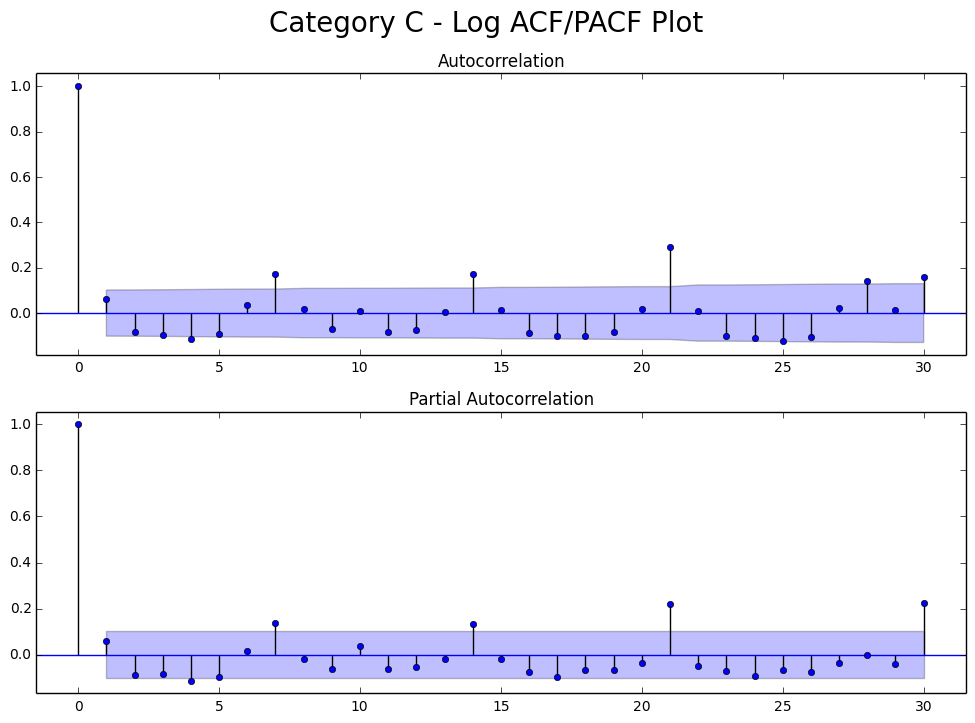

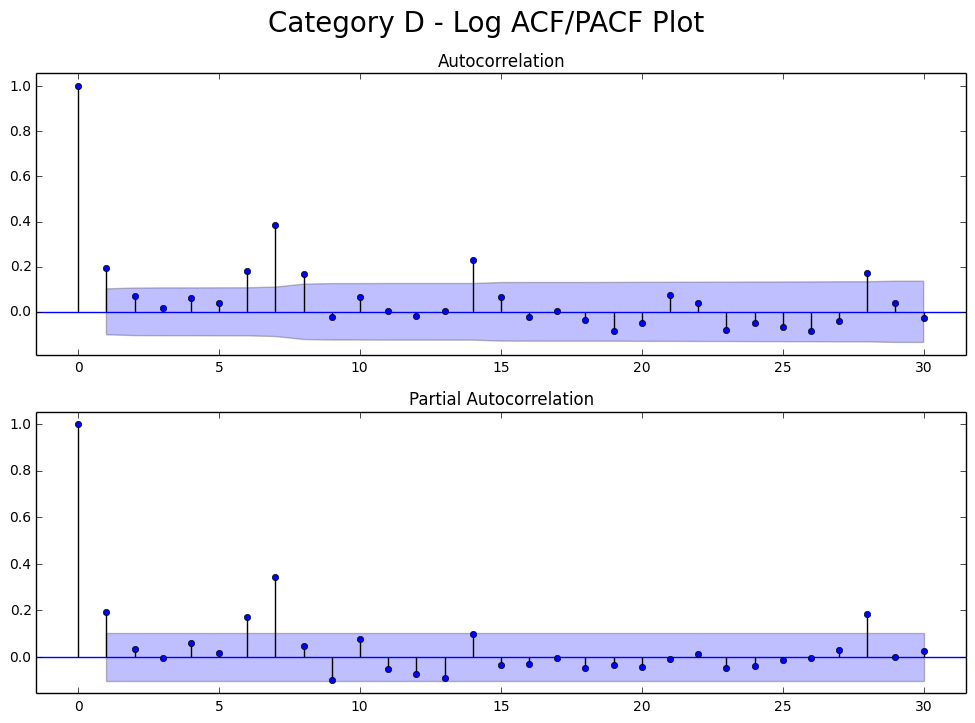

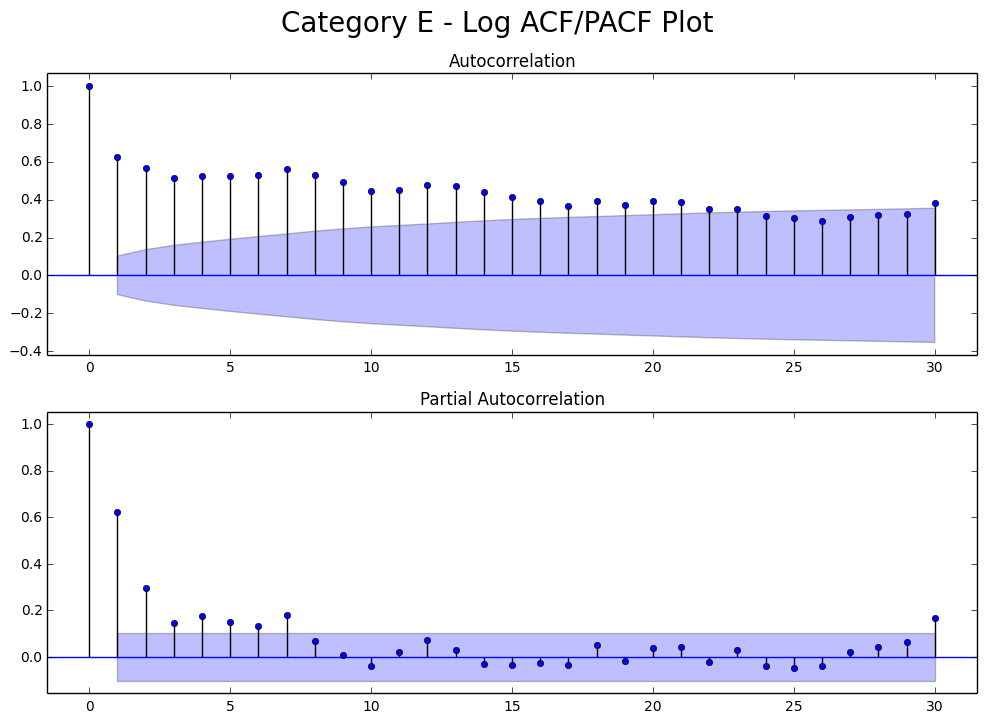

...

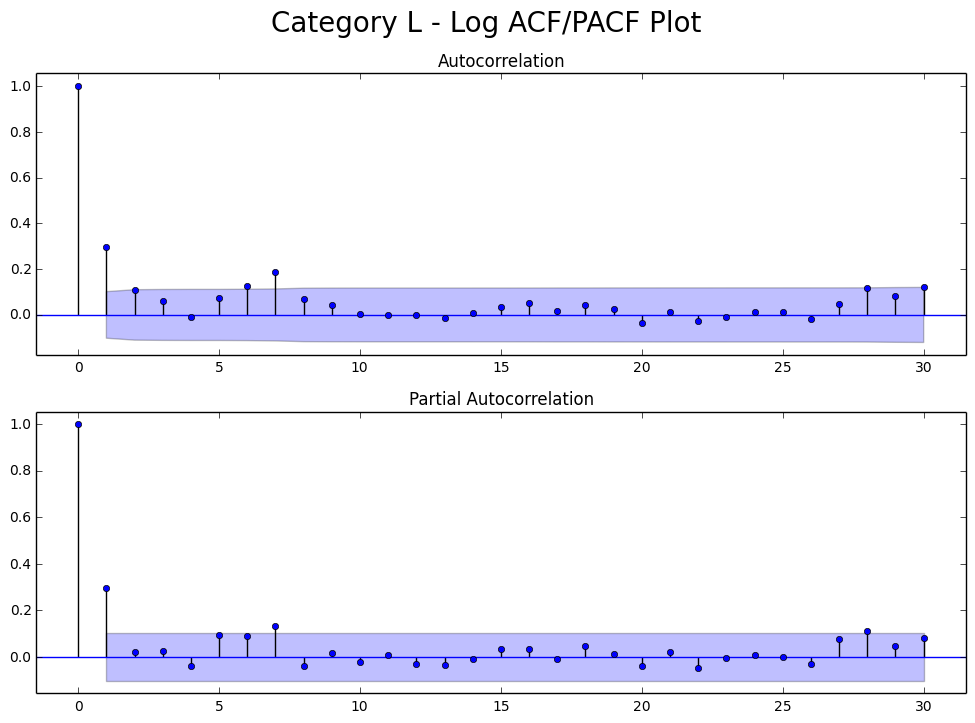

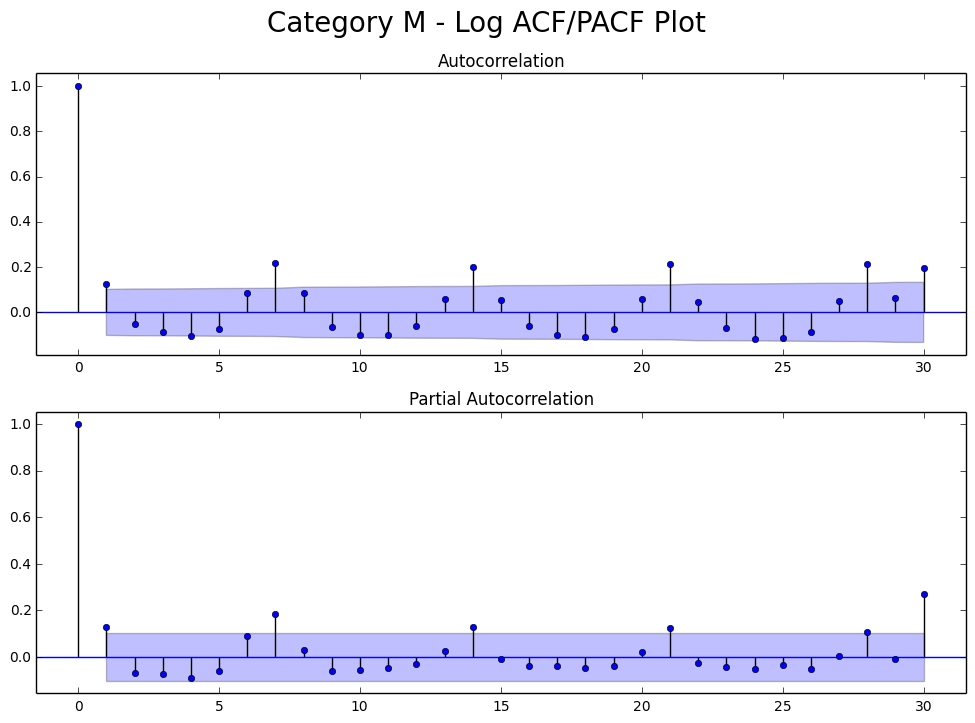

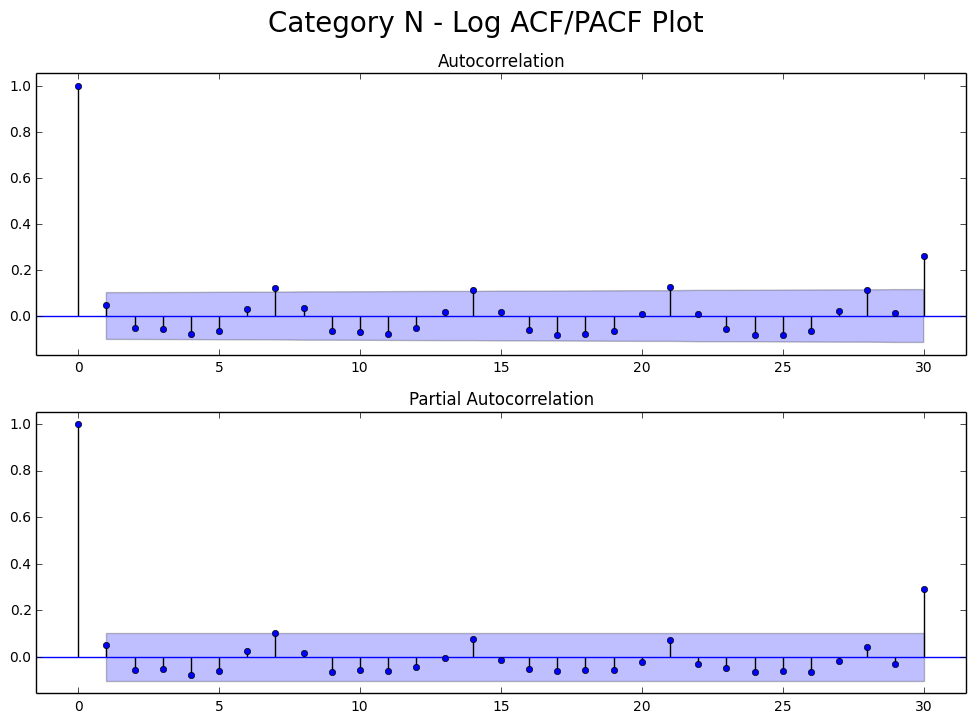

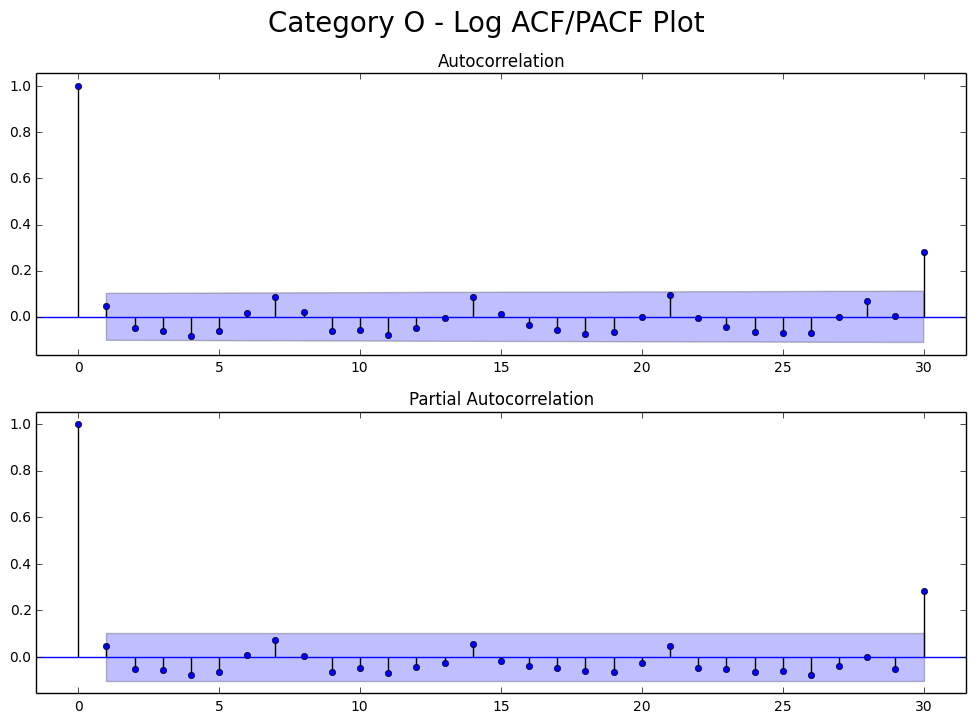

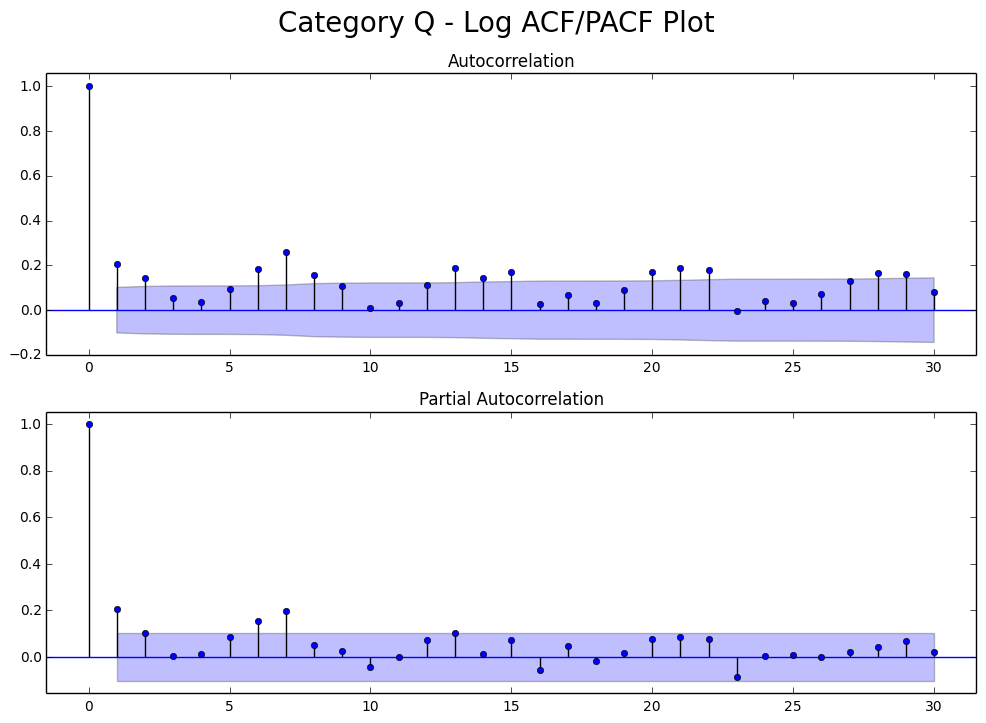

In [39]:
# Let's see the log transformed ACF/PACF plot.

_ = map(acf_pacf_plot, splitted_data_log, ['Log']*len(temp_list), temp_list)

## We observe these:
### E) PACF cut 2
### L) PACF cut 1
### The rest is really hard to tell, I am leaving them as both tails off for now

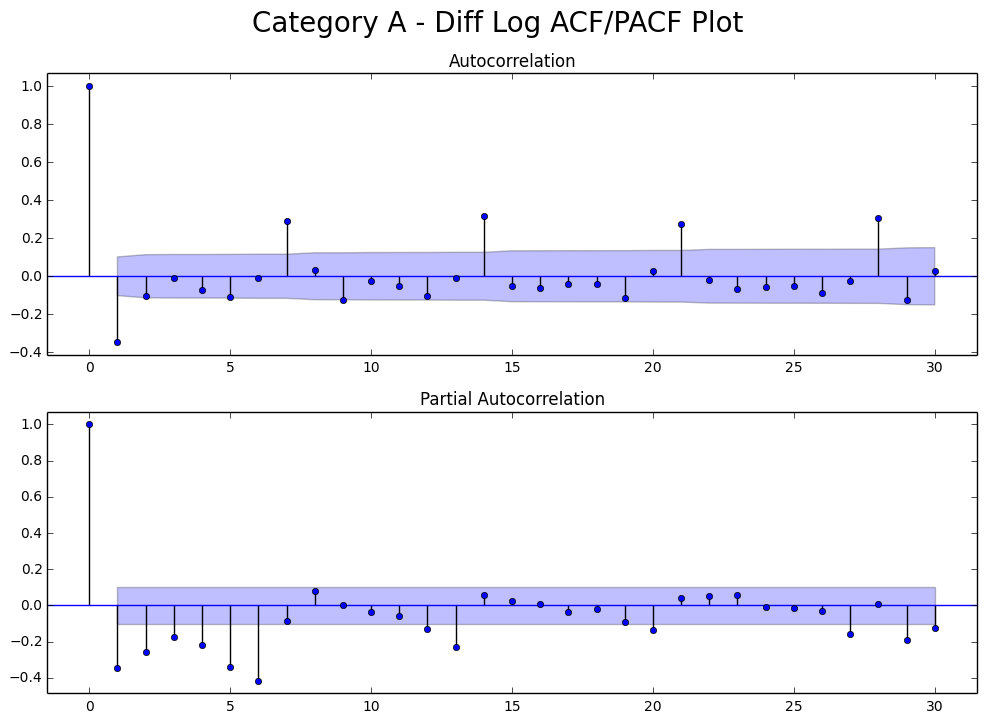

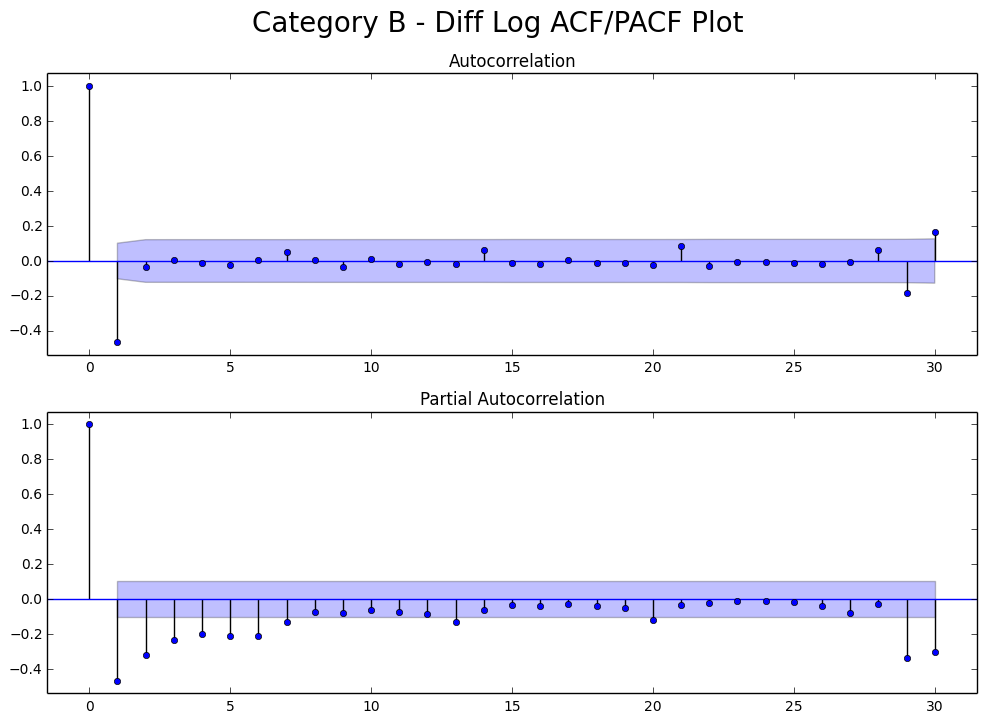

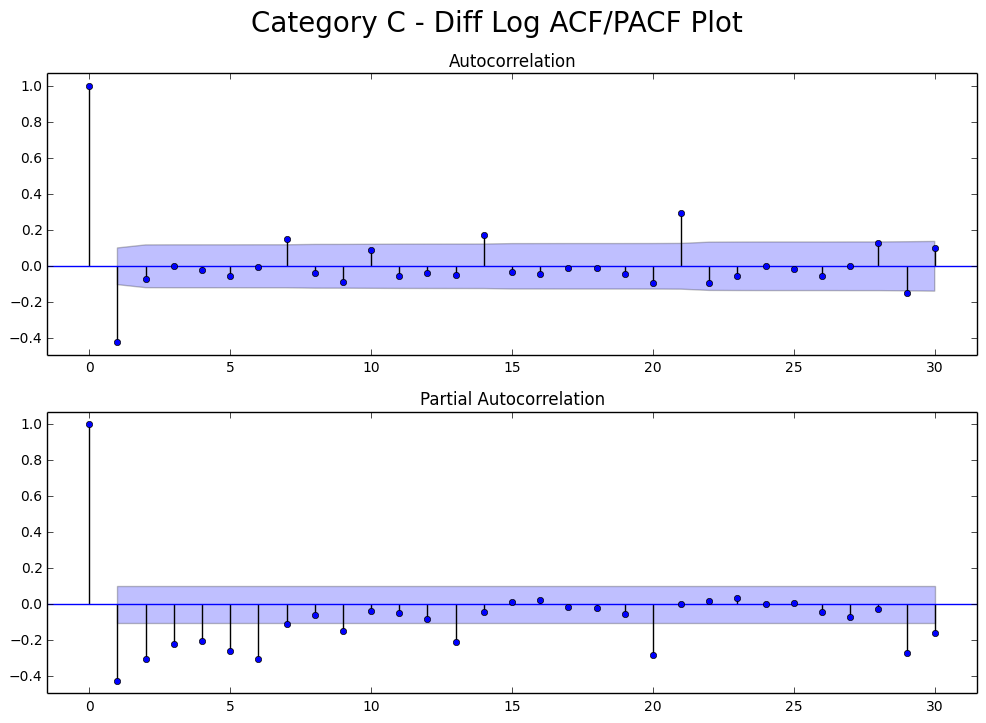

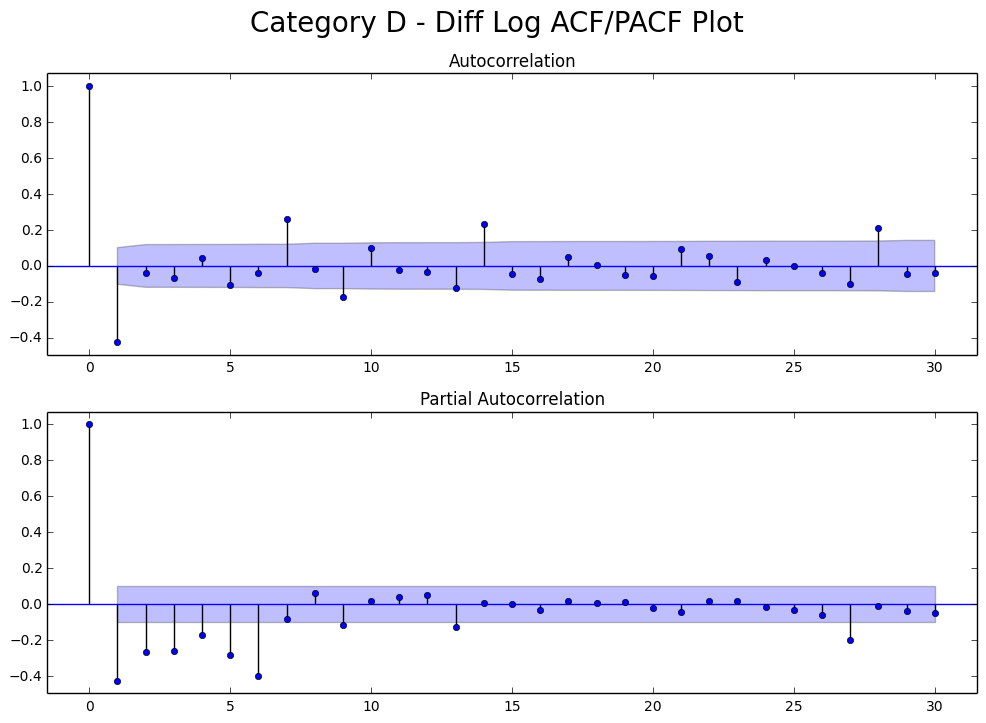

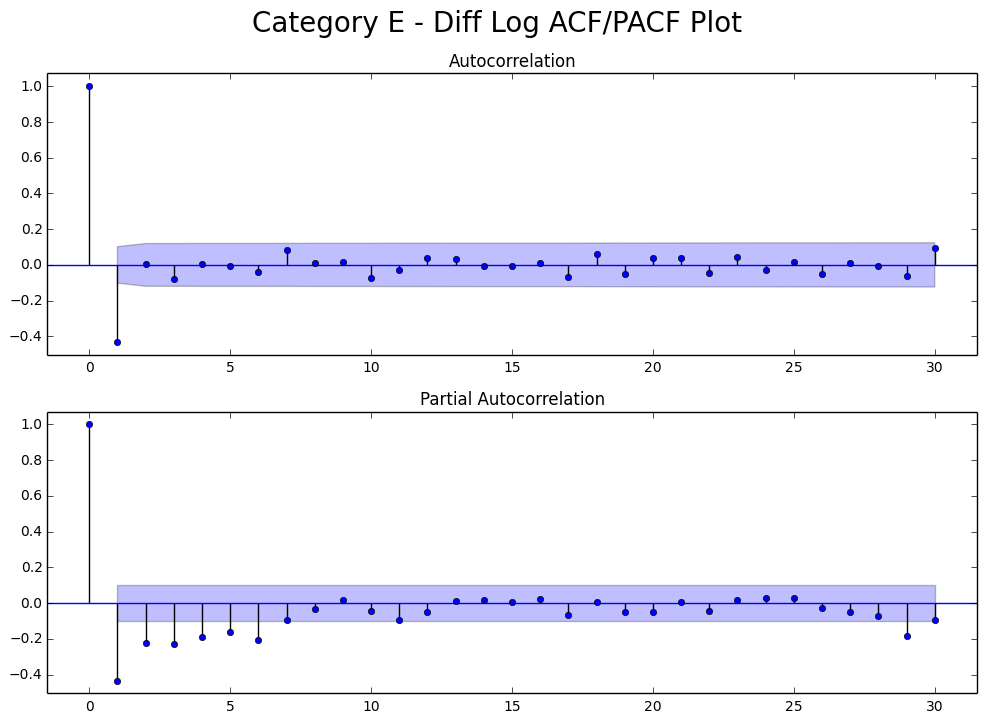

...

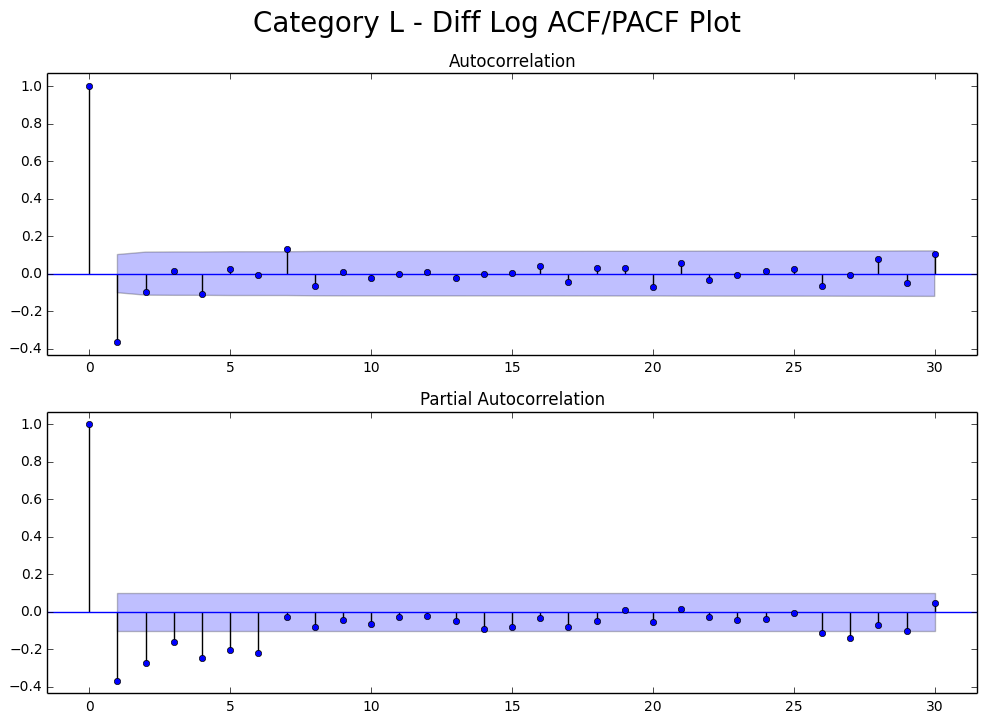

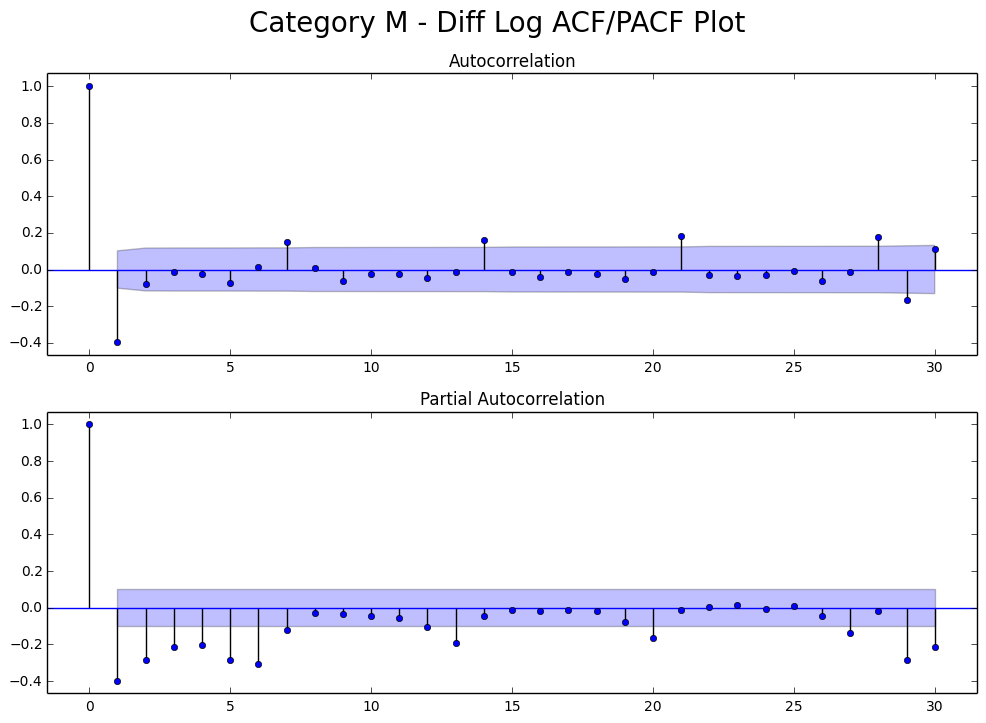

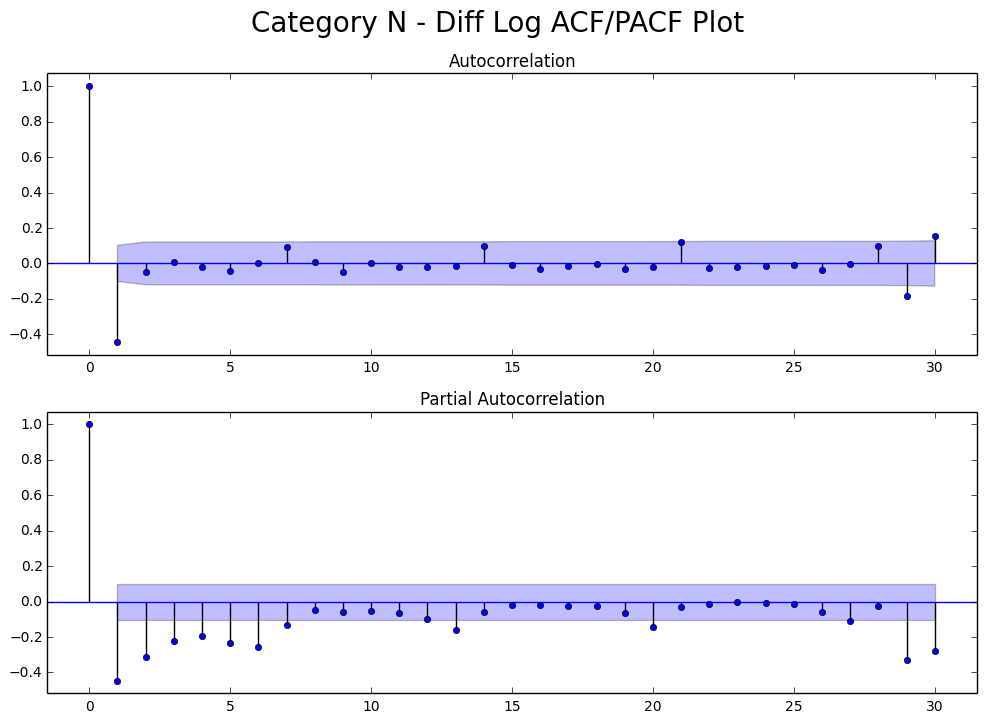

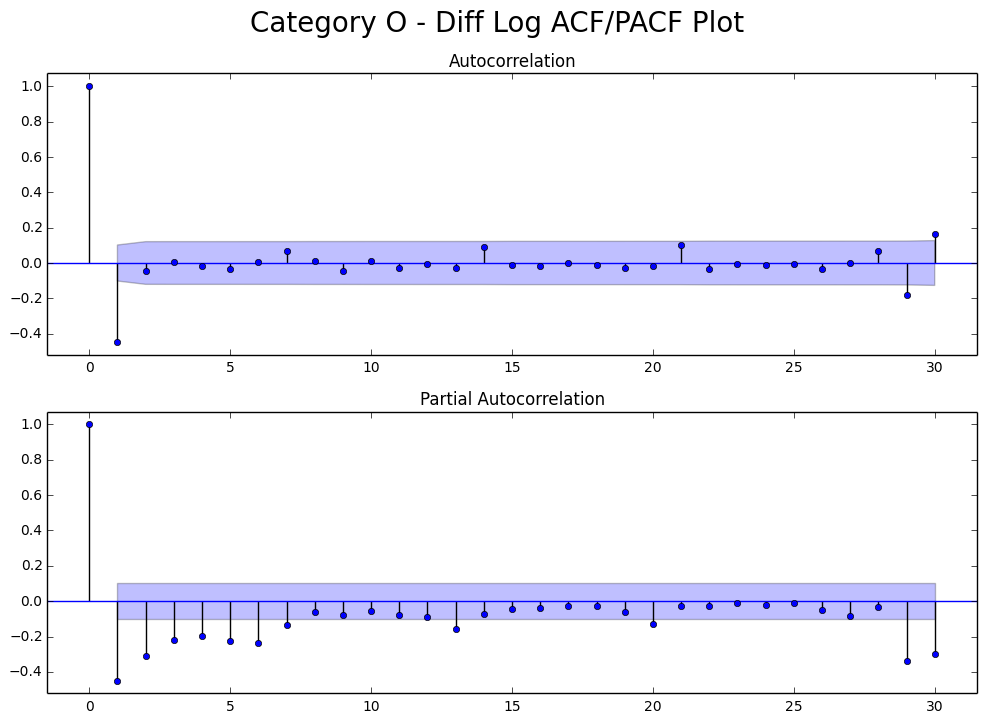

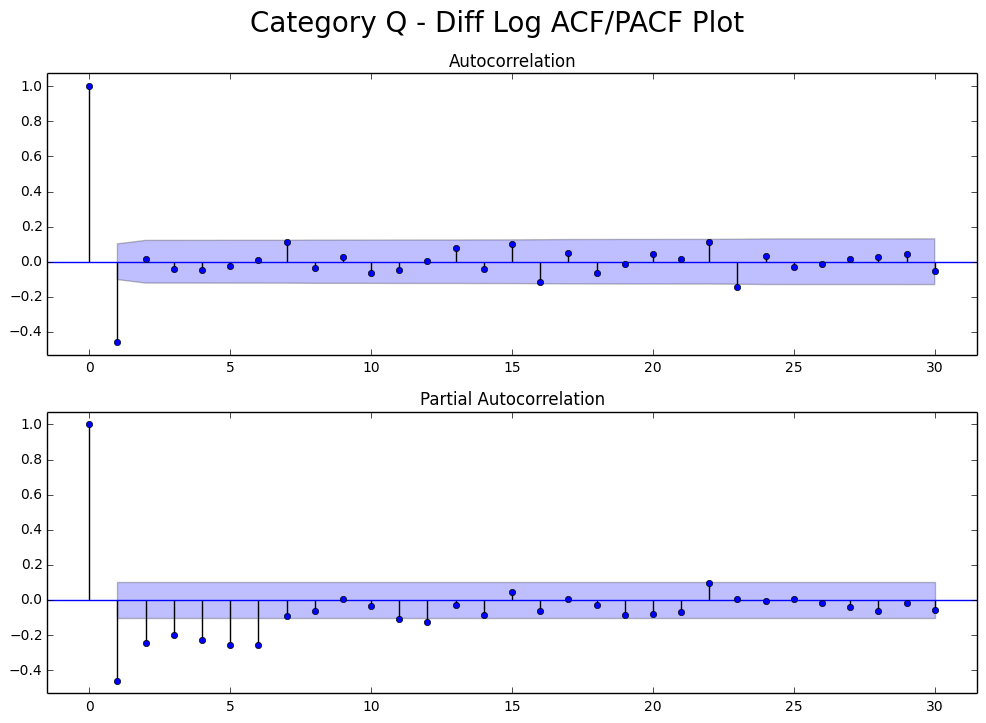

In [41]:
# Diff log ACF/PACF plot.

_ = map(acf_pacf_plot, splitted_data_log_diff, ['Diff Log']*len(temp_list), temp_list)

## We observed:
### B), C), E), G), H), I), L), M), N), O), Q) AC cut 1 -> MA(1) model?
### - The rest have both tails off, so, the may be fitted using the ARIMA model.

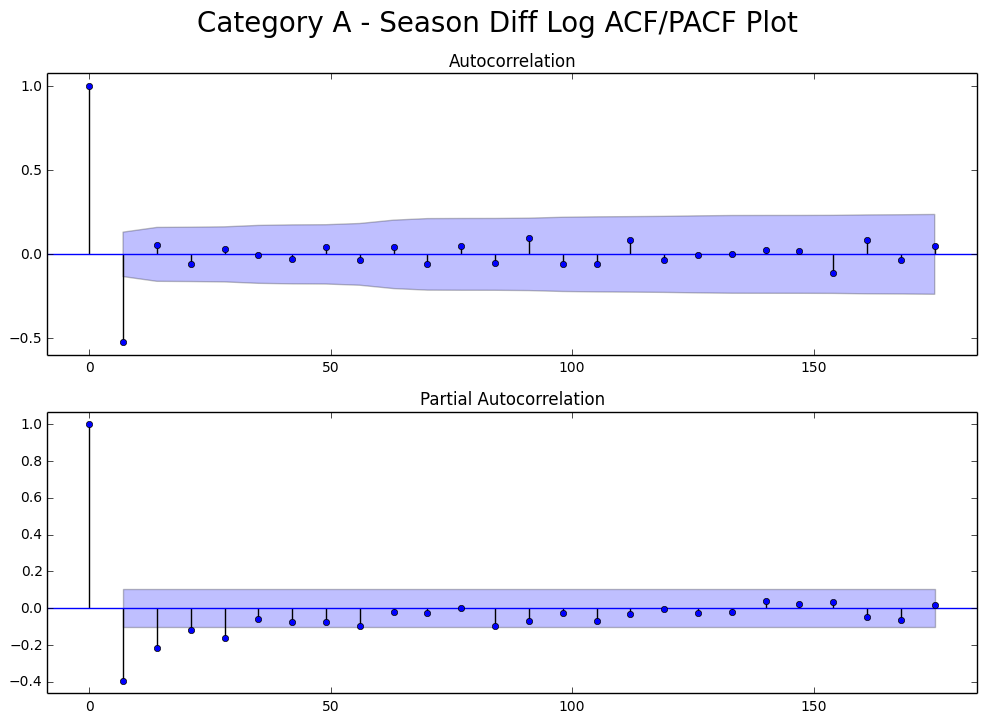

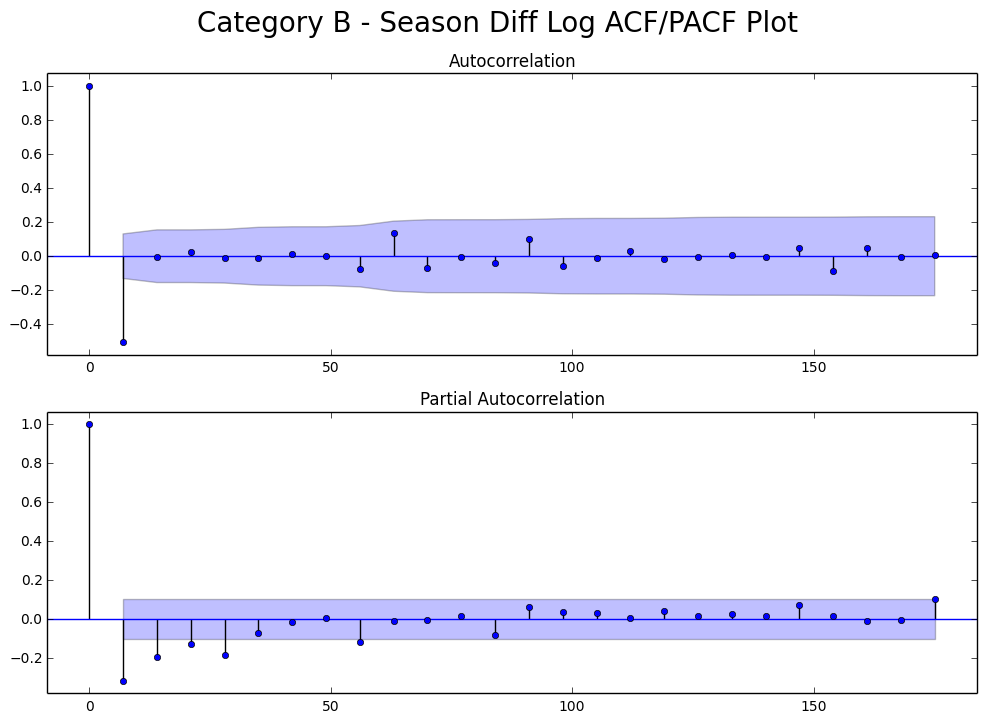

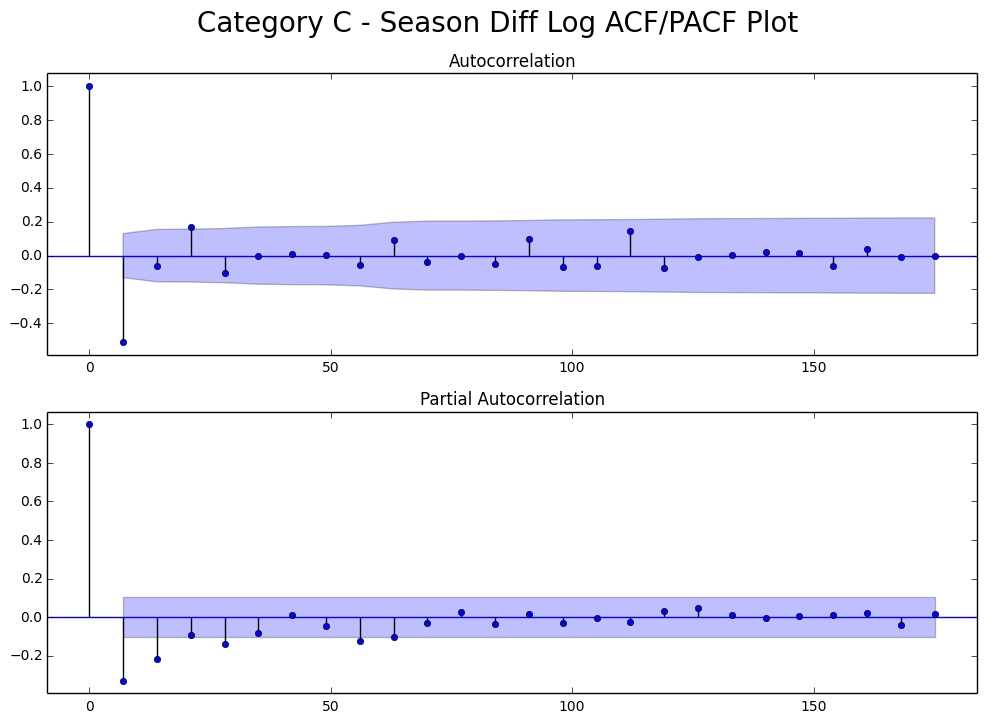

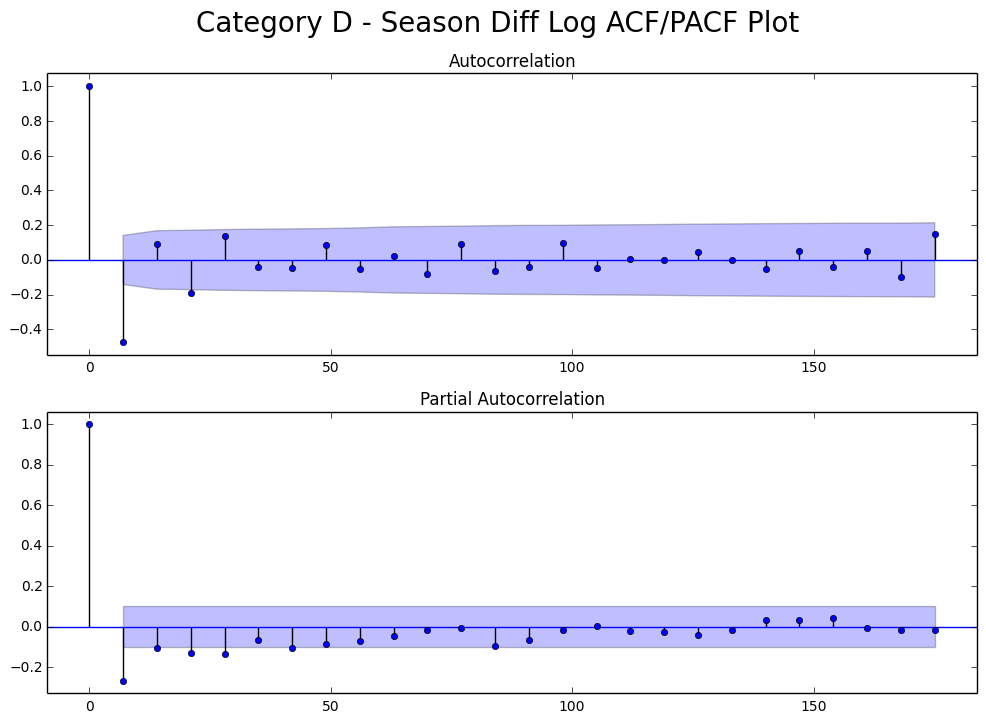

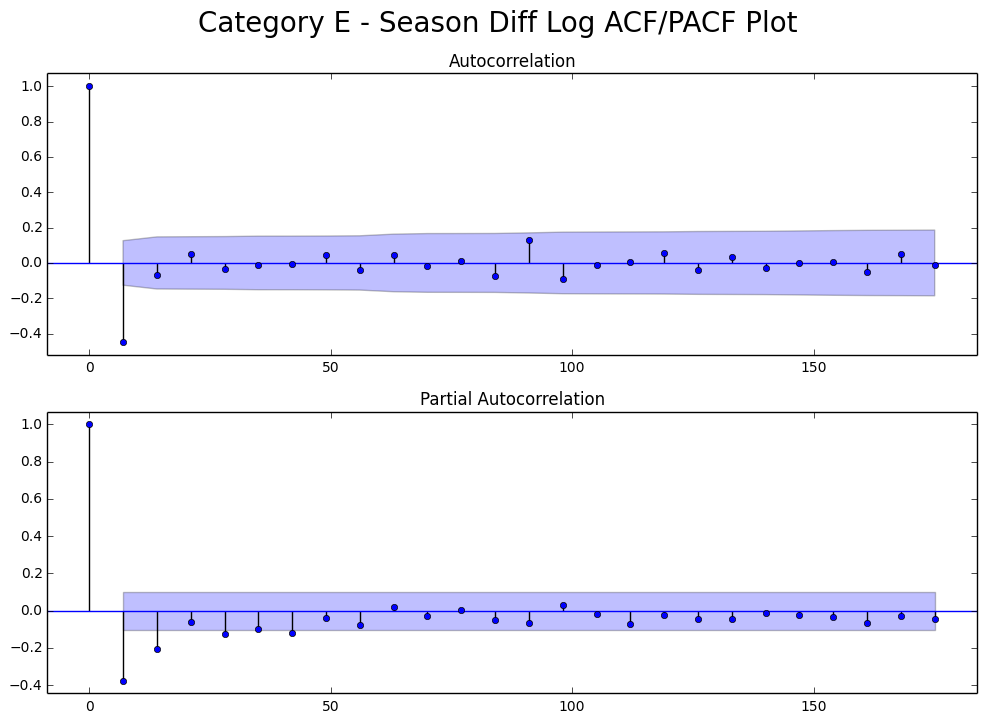

...

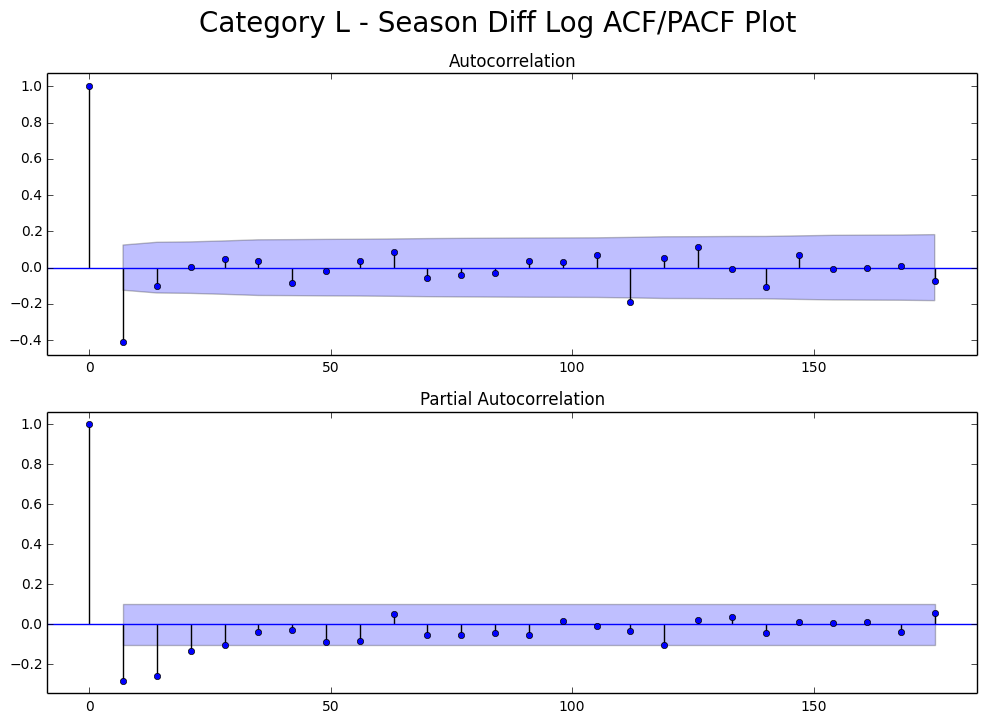

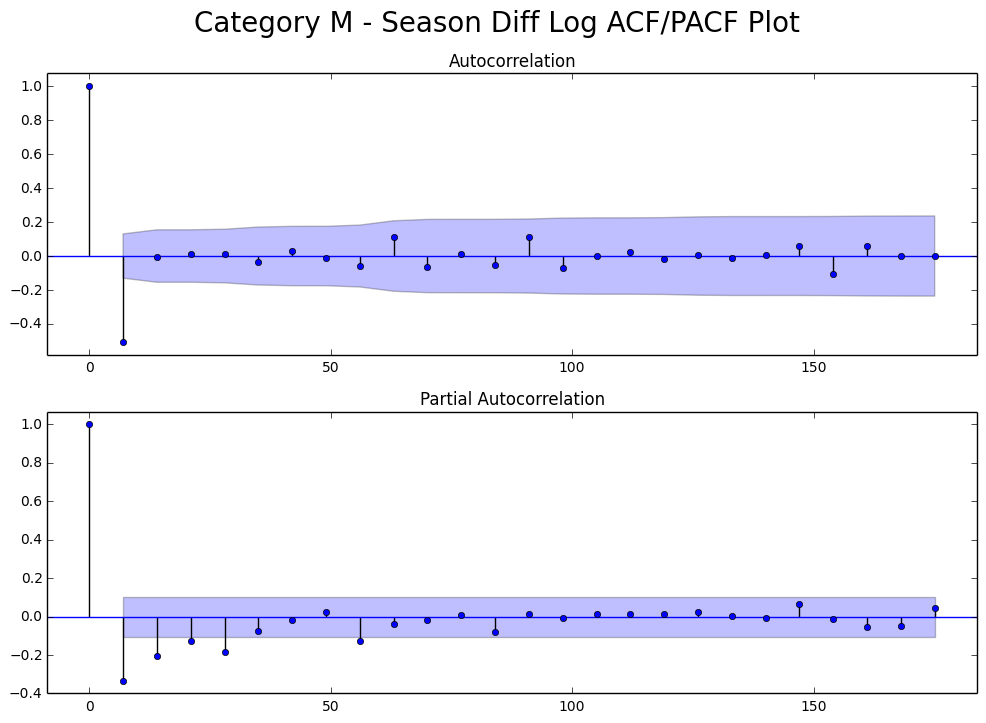

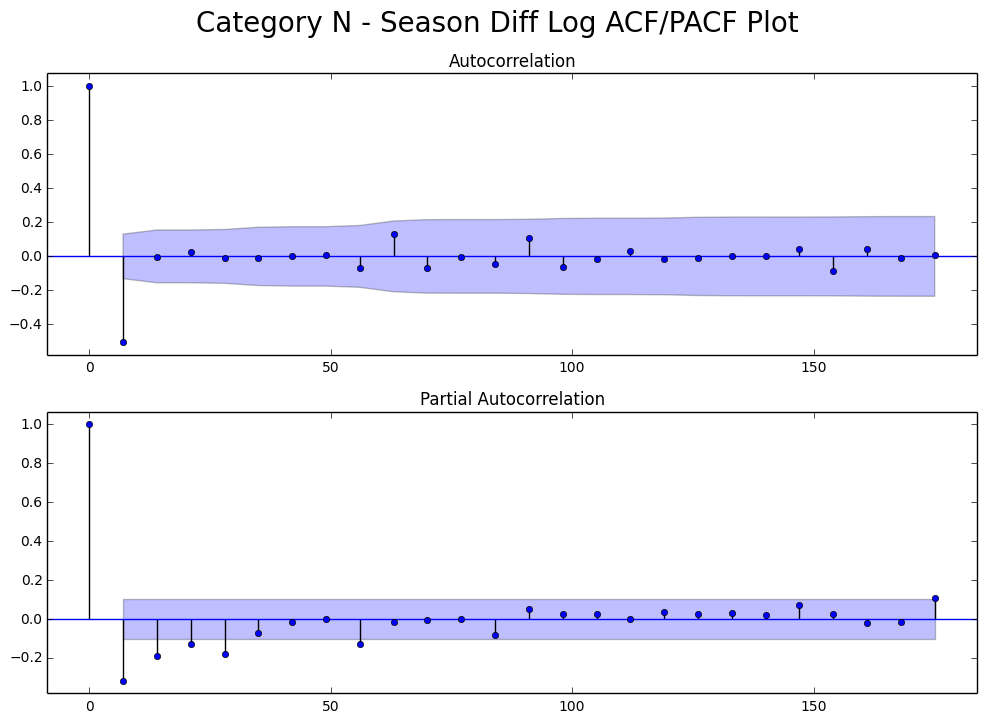

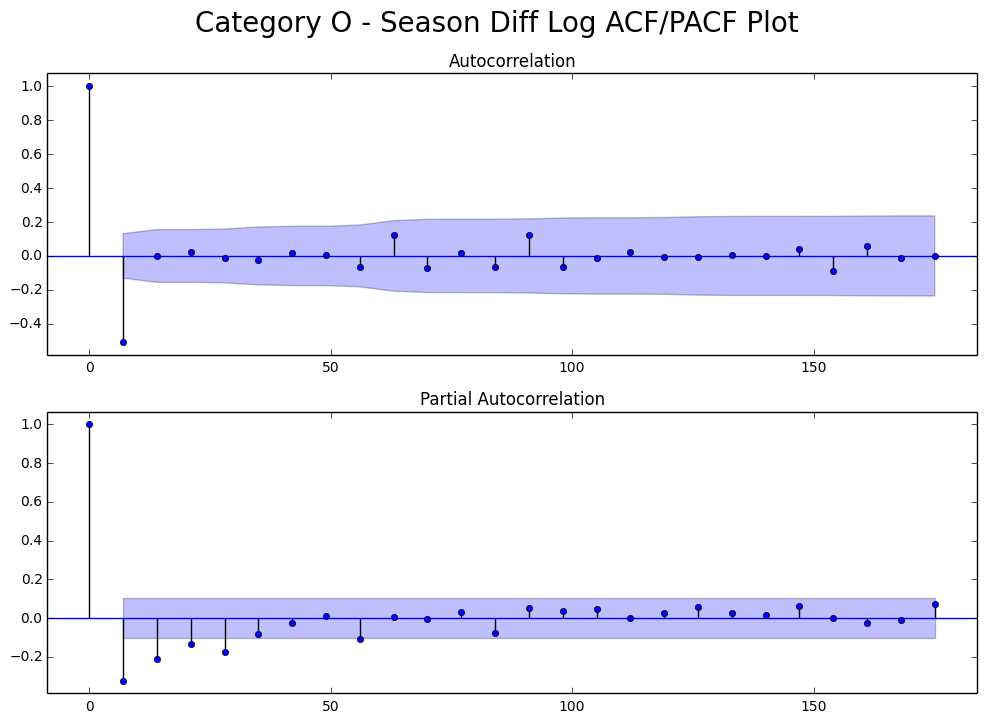

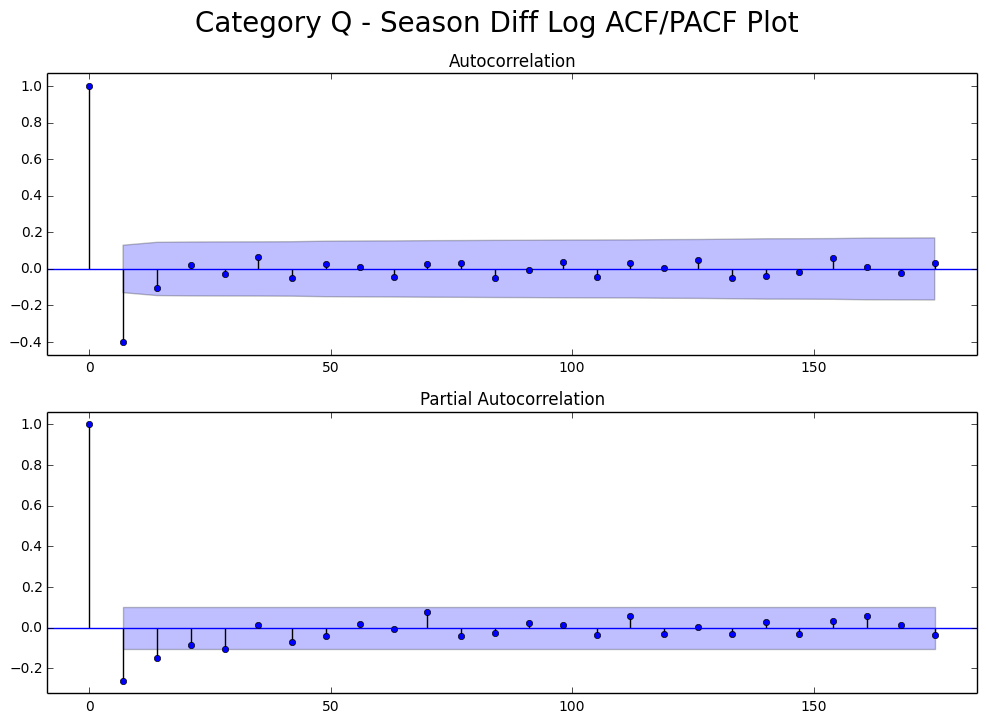

In [43]:
# Finally, let's see the Season Diff Log transformed ACF/PACF plot.

_ = map(acf_pacf_plot, splitted_data_log_diff_season, ['Season Diff Log']*len(temp_list), temp_list, [range(0, 182, 7)]*len(temp_list))

### We observed:
### All - ACF cut 1...SMA(1)? -> SARIMA(0, 1, 1).
### Some are rather not clear, but the SMA(1) is quite clear.
### We will use grid search to help us find the optimized model!

# Step 4) Model Building
### - At this point we are sure we need MA and SMA models.
### - The AR and SAR models are uncertain.
### - The difference is 1 in both normal and seasonal lag.
### - We will use grid search to find out the AR & SAR order.

In [47]:
# We will use this function to help us search the best p & q values, and seasonal P & Q values.
# Four for loops is a lot, but we will be using it mostly for 1 or 2 values in each p, q, P & Q values.
# Because we already have a good idea these values won't be more than 2.

def evaluate_models(dataset, p_values, q_values, P_values, Q_values):
    best_score, best_cfg, best_season = float("inf"), None, None
    for p in p_values:
        for q in q_values:
            for P in P_values:
                for Q in Q_values:
                    order = (p,1,q)
                    season_order = (P, 1, Q, 7)
                    try:
                        mod = sm.tsa.statespace.SARIMAX(dataset, trend='n', order=order, \
                                                           seasonal_order=season_order)
                        result = mod.fit()
                        aic = result.aic
                        if aic < best_score:
                            best_score, best_cfg, best_season = aic, order, season_order
                        print('SARIMA%s %s AIC=%.3f' % (order, season_order, aic))
                    except:
                        continue

    print('Best SARIMA%s %s AIC=%.3f' % (best_cfg, best_season, best_score))
    return [best_cfg, best_season]

In [48]:
def model_building(timeseries, item, p=range(0,2), q=range(1, 2), P=range(0,2), Q=range(1, 2)):
    orders = evaluate_models(timeseries, p, q, P, Q)
    mod = sm.tsa.statespace.SARIMAX(timeseries, trend='n', order=orders[0], seasonal_order=orders[1])
    results_1 = mod.fit()
    
    print 'Category {}: '.format(item), results_1.summary()
    return results_1

In [49]:
results_1 = map(model_building, splitted_data, temp_list)

SARIMA(0, 1, 1) (0, 1, 1, 7) AIC=2758.751
SARIMA(0, 1, 1) (1, 1, 1, 7) AIC=2757.863
SARIMA(1, 1, 1) (0, 1, 1, 7) AIC=2760.562
SARIMA(1, 1, 1) (1, 1, 1, 7) AIC=2759.734
Best SARIMA(0, 1, 1) (1, 1, 1, 7) AIC=2757.863
Category A:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(0, 1, 1)x(1, 1, 1, 7)   Log Likelihood               -1374.932
Date:                           Fri, 17 Feb 2017   AIC                           2757.863
Time:                                   04:29:31   BIC                           2773.528
Sample:                               09-26-2015   HQIC                          2764.085
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|

## Results
### Category A, D, Q: (0, 1, 1)x(1, 1, 1, 7)
### Category B, E, F, G, H, K, M, N, O: (1, 1, 1)x(0, 1, 1, 7)
### Category C, I, L: (1, 1, 1)x(1, 1, 1, 7)

In [50]:
# Next step: check the residual plots to see the models are good.

def get_residuals(timeseries_results):
    residuals = pd.DataFrame(timeseries_results.resid)
    
    return residuals

In [51]:
residuals = map(get_residuals, results_1)

In [52]:
def residual_analysis(residuals, item):
    fig = plt.figure(figsize=(12,12))

    ax1 = fig.add_subplot(411)
    ax1 = sm.graphics.tsa.plot_acf(residuals, lags=30, ax=ax1, title='Category {} - ACF of Residual'.format(item))

    ax2 = fig.add_subplot(412)
    ax2.title.set_text('Category {} - Q-Q Plot of Std Residuals'.format(item))
    ax2 = qqplot(residuals, line='r', ax=plt.gca())

    # Plot residual errors.
    ax3 = fig.add_subplot(413)
    ax3.title.set_text('Category {} - Standardized Residuals'.format(item))
    ax3 = plt.plot(residuals)
    # residuals.plot(kind='kde')

    temp_q_stat = sm.stats.diagnostic.acorr_ljungbox(residuals, lags=30)
    ax4 = fig.add_subplot(414)
    ax4.title.set_text('Category {} - P value for Ljung-Box Statistics'.format(item))
    ax4 = plt.plot(temp_q_stat[1], 'o')
    # print temp_q_stat[0]

    plt.tight_layout()

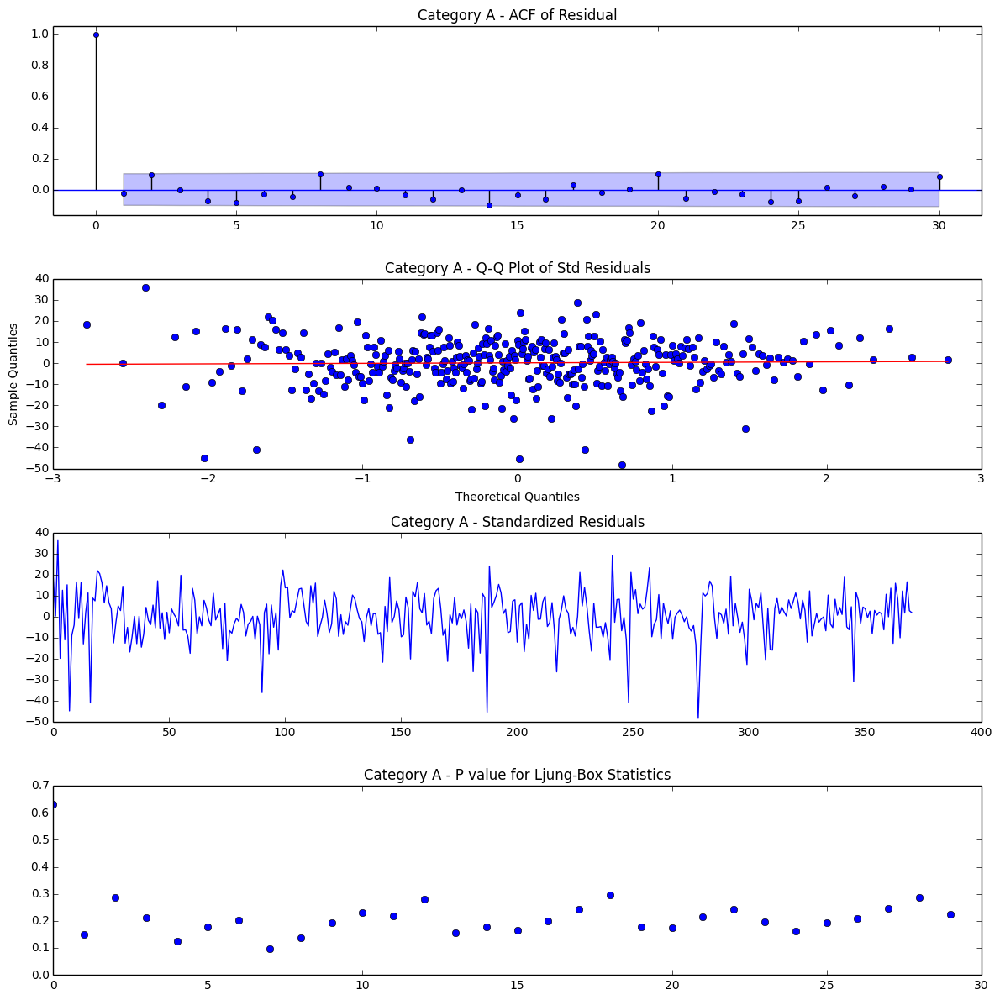

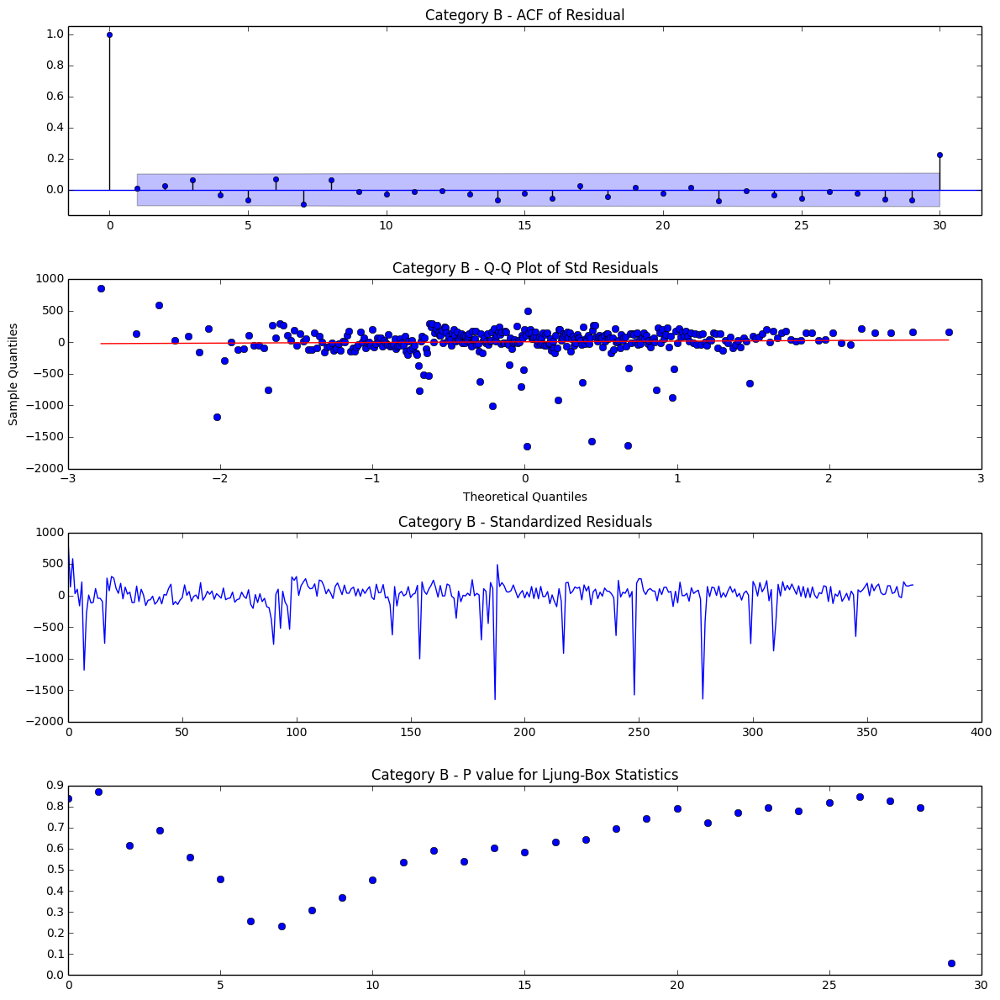

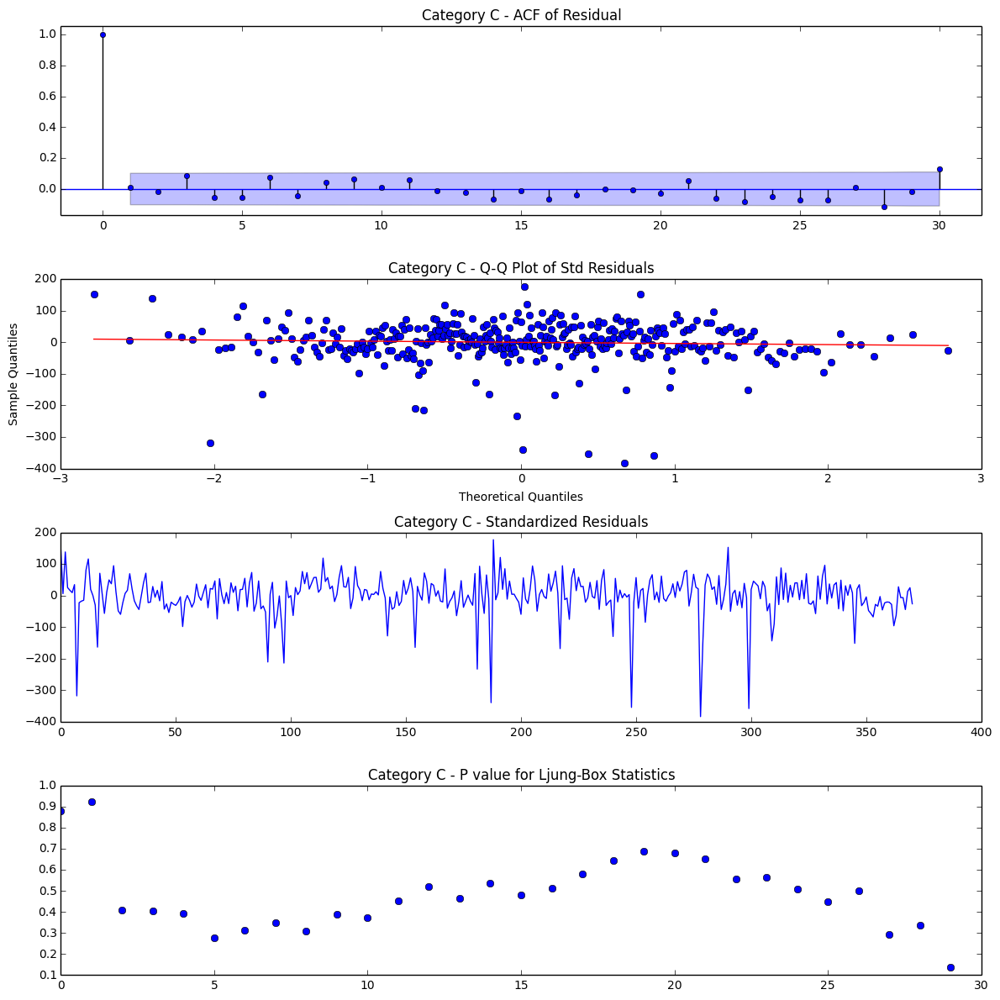

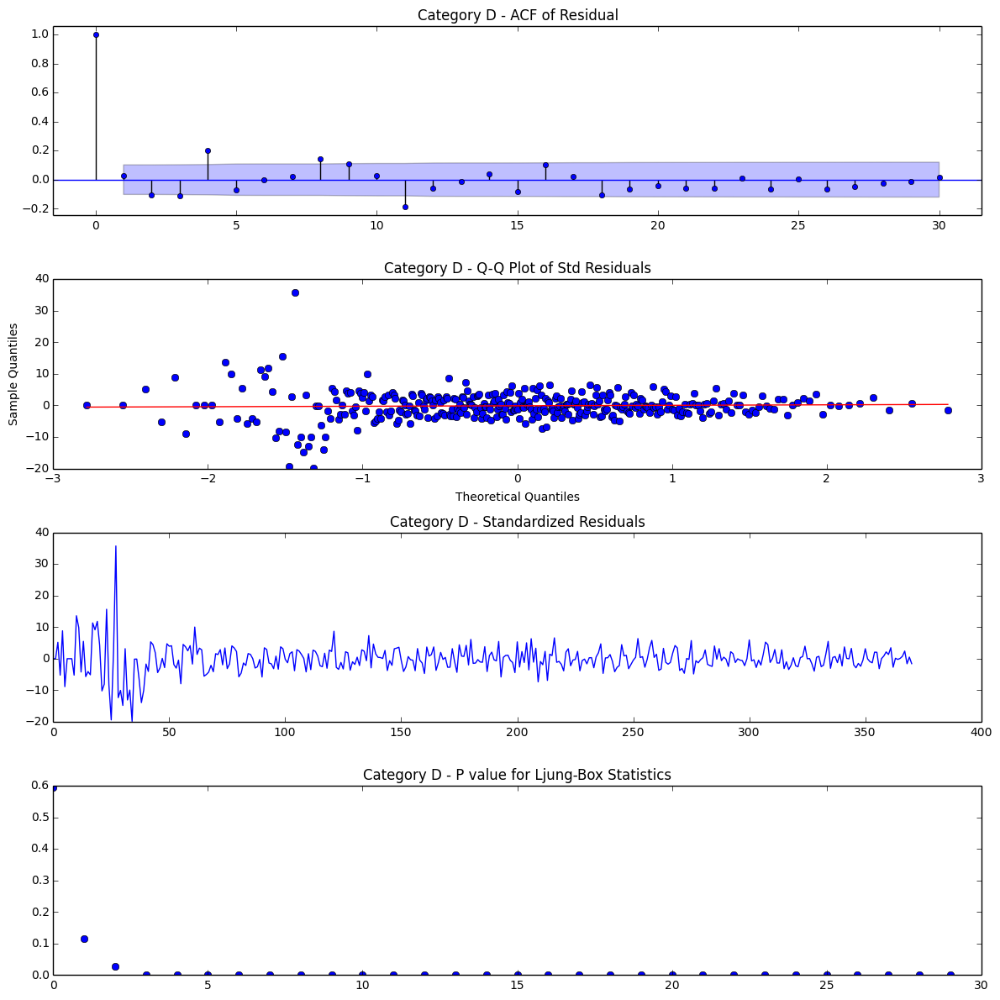

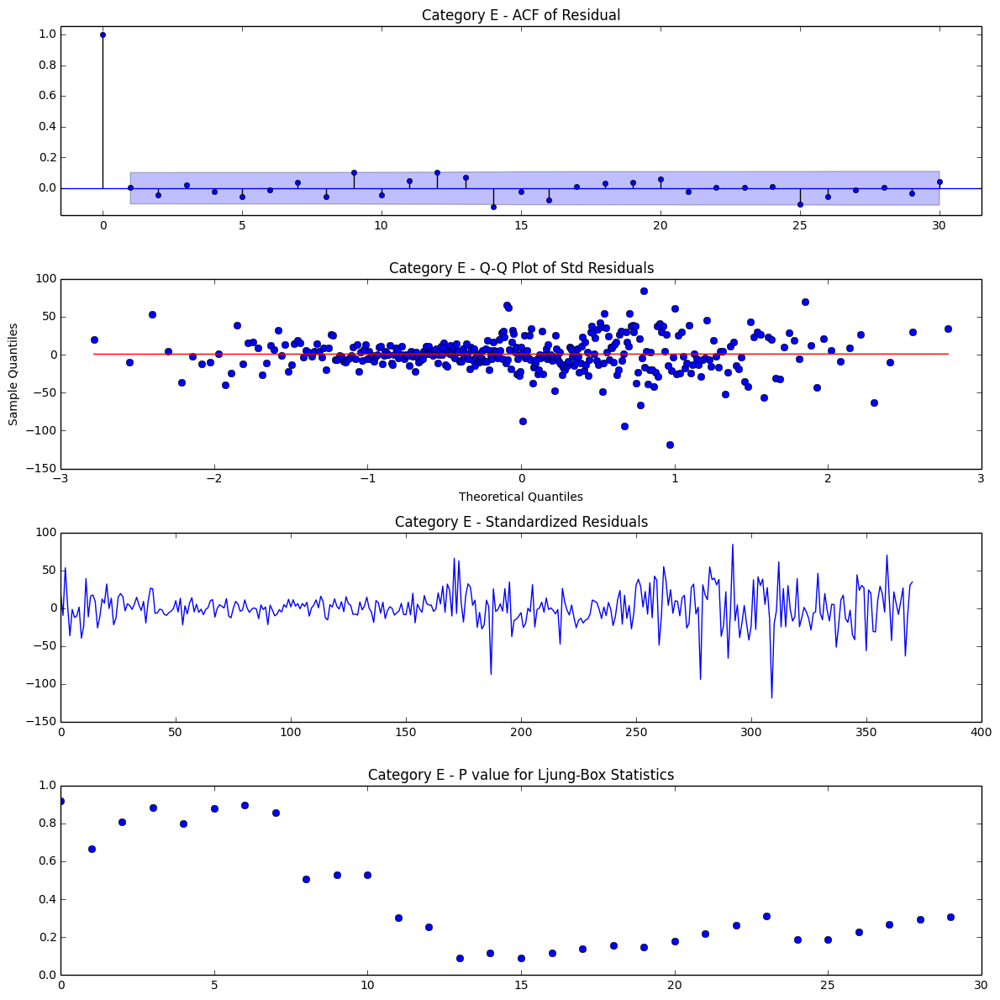

...

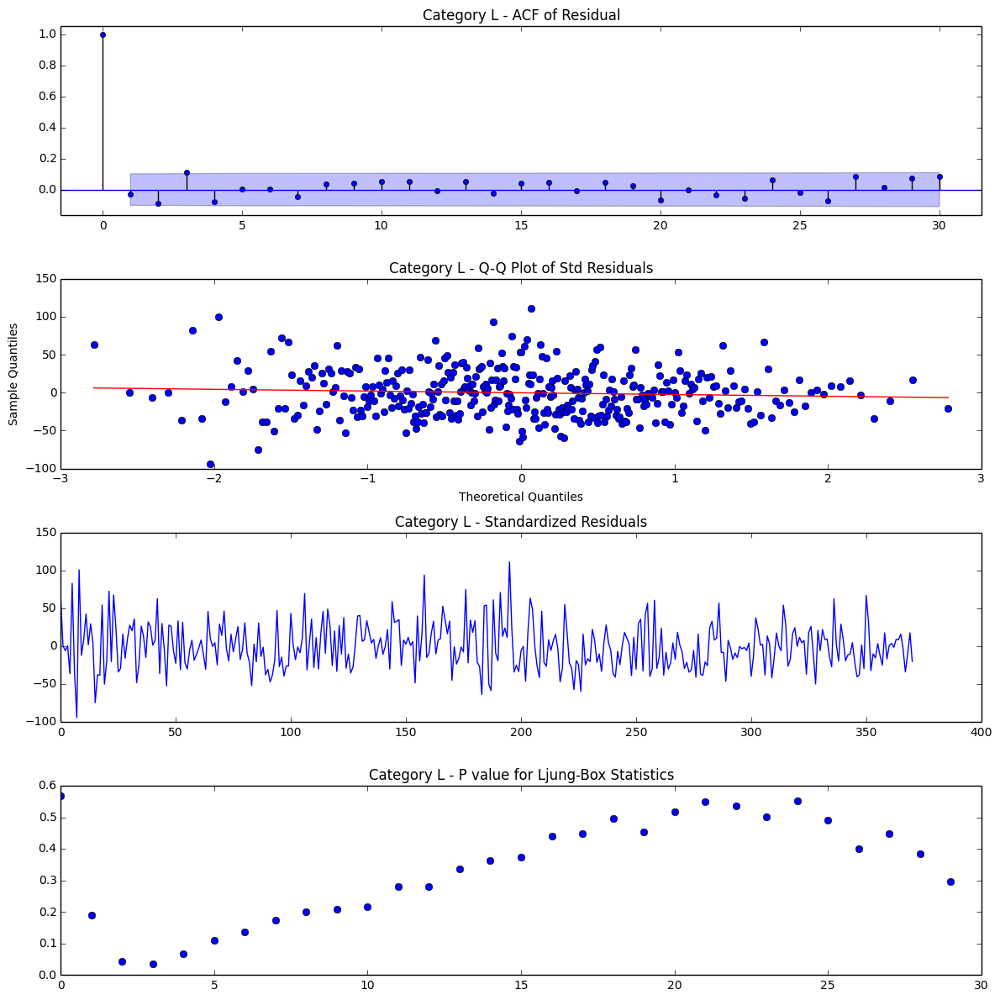

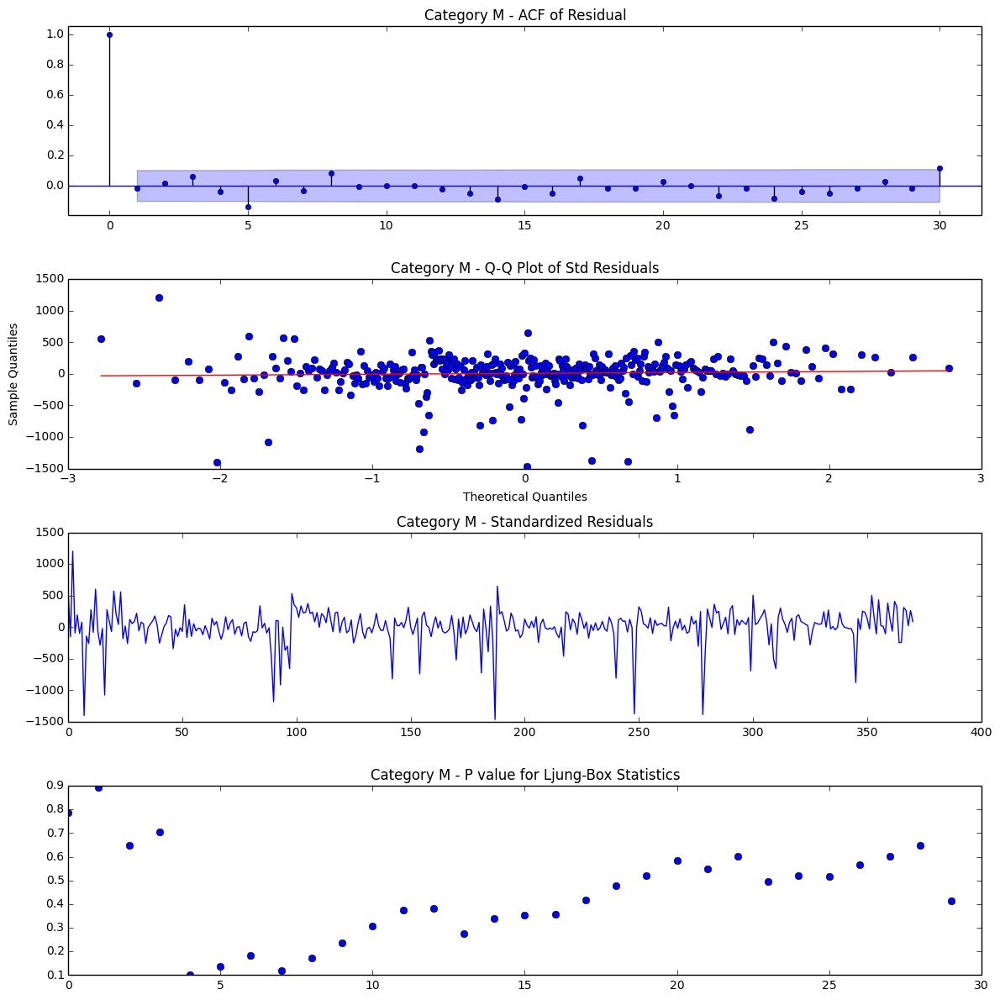

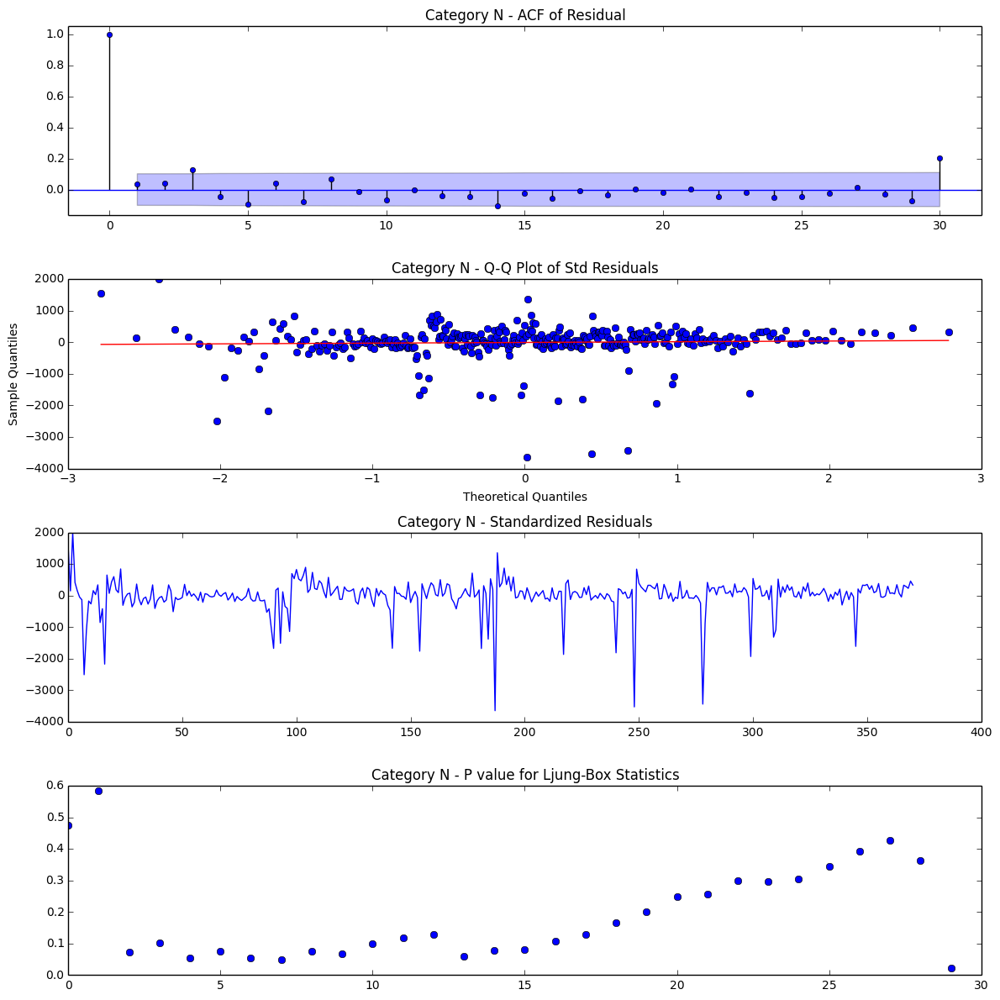

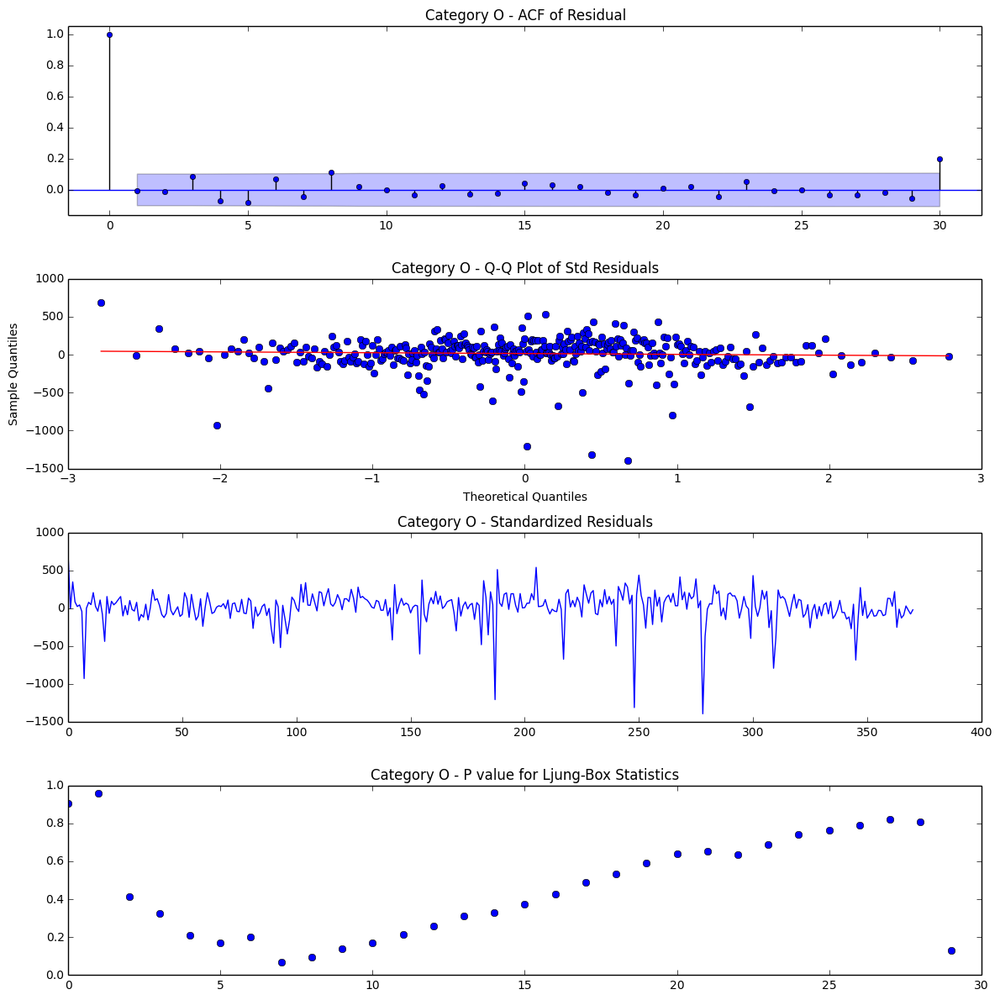

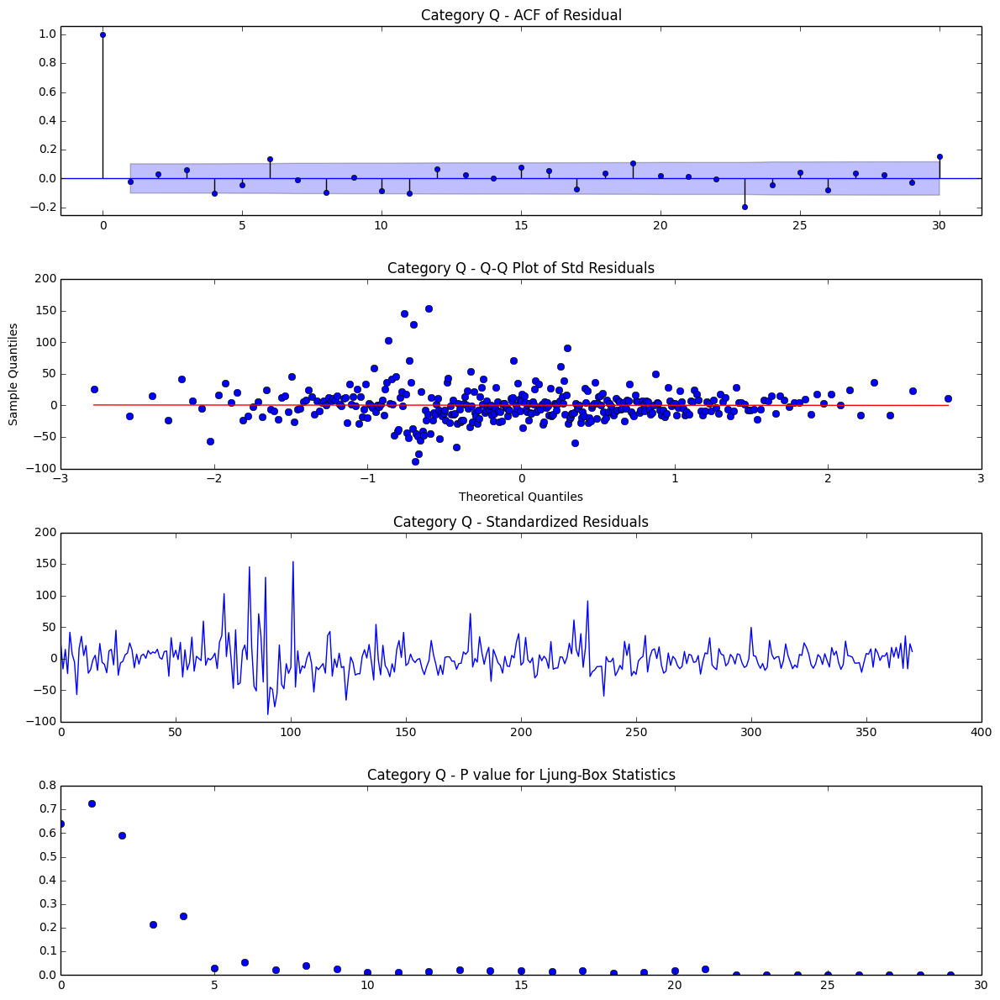

In [53]:
_ = map(residual_analysis, residuals, temp_list)

### The residuals plots mostly look good. Let's move on to forecasting.

# Step 5) Prediction In Sample, and 90 Days Ahead
### - We will plot the forecast for each category
### - Plot the relative contribution from each category
### - Add them up and plot the total forecast
### - Measure the RMSE
### - We will also build a separate model and forecast using top-down approach for comparison (what we did so far is bottom up)

In [54]:
def plot_forecast(results, timeseries, item):
    pred = (results.predict())
    forecast_90 = (results.forecast(steps=90))

    pred.plot(label='predict')
    forecast_90.plot(label='forecast')
    timeseries.plot(label='original')
    plt.title(' Category {} Forecast '.format(item))
    plt.legend()
    plt.show(block=False)
    
    return pred

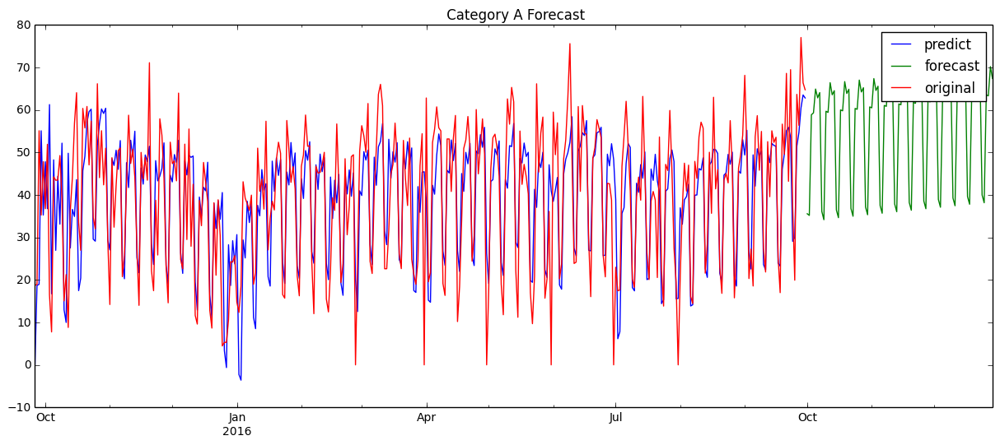

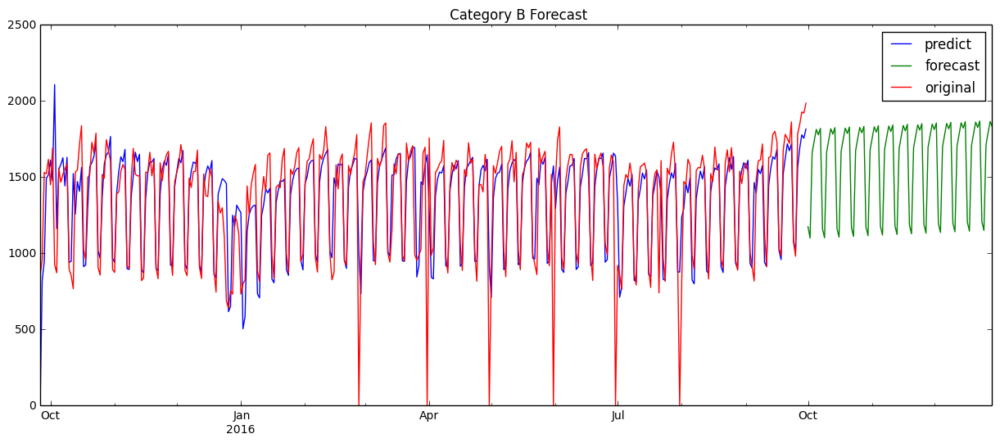

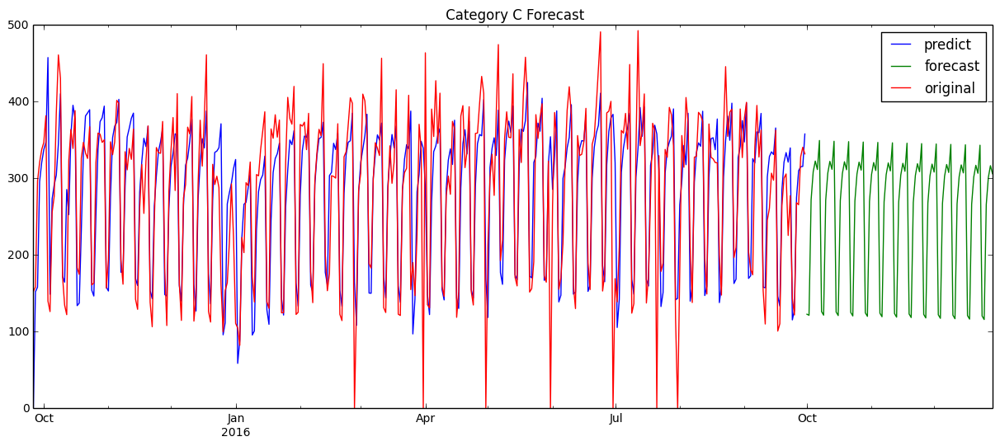

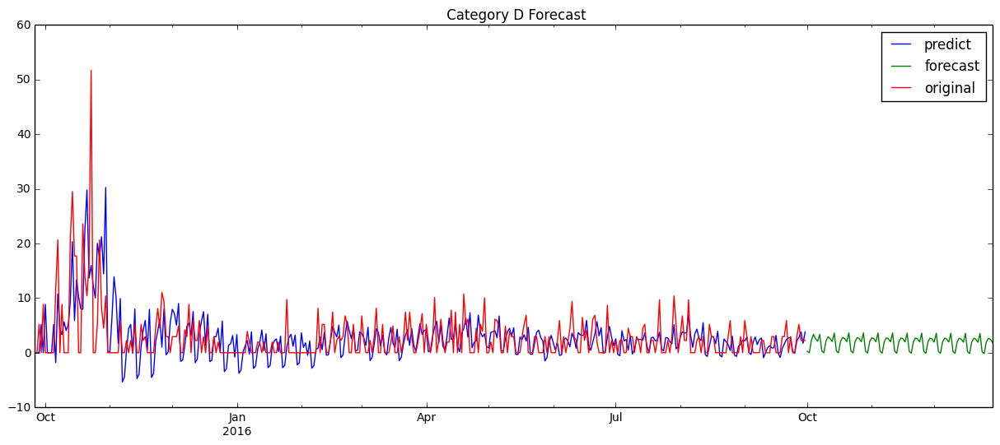

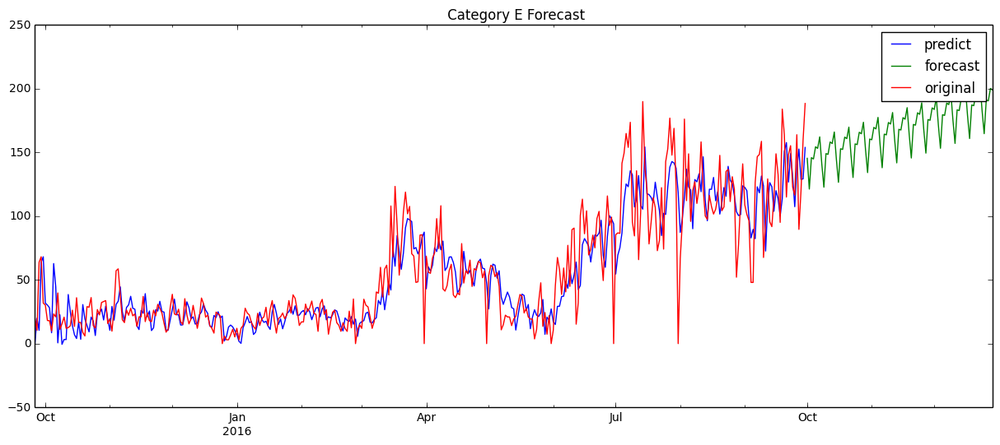

...

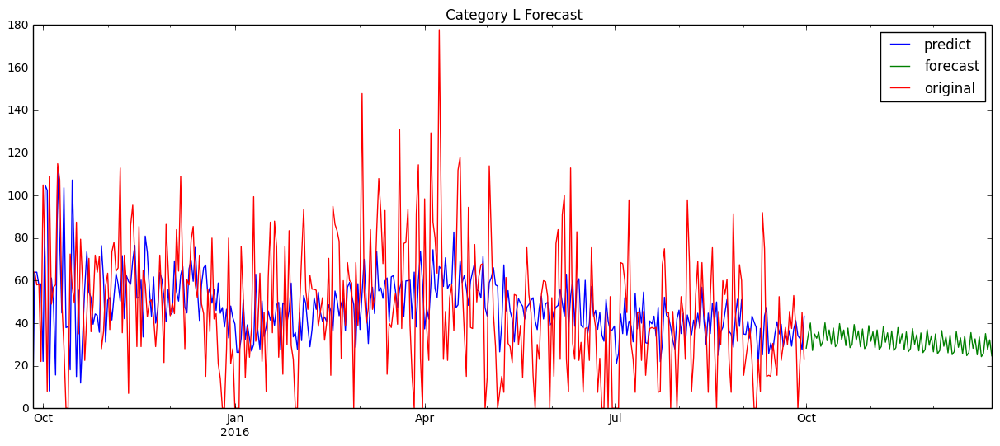

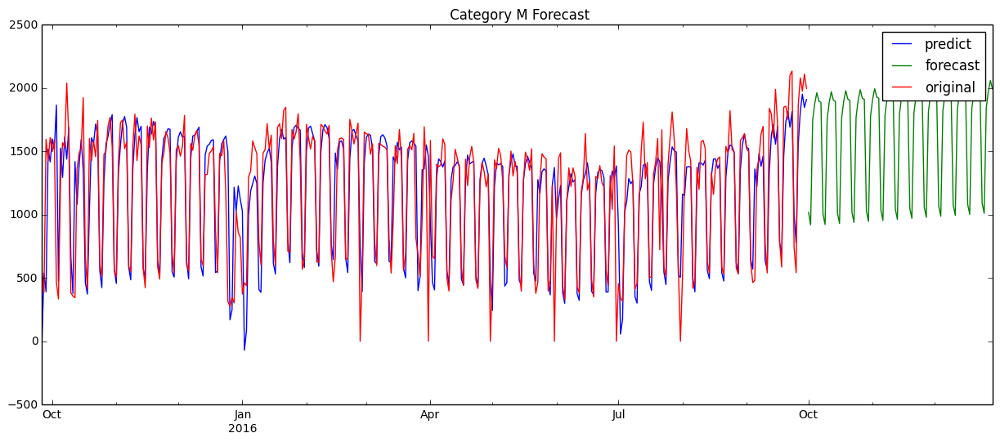

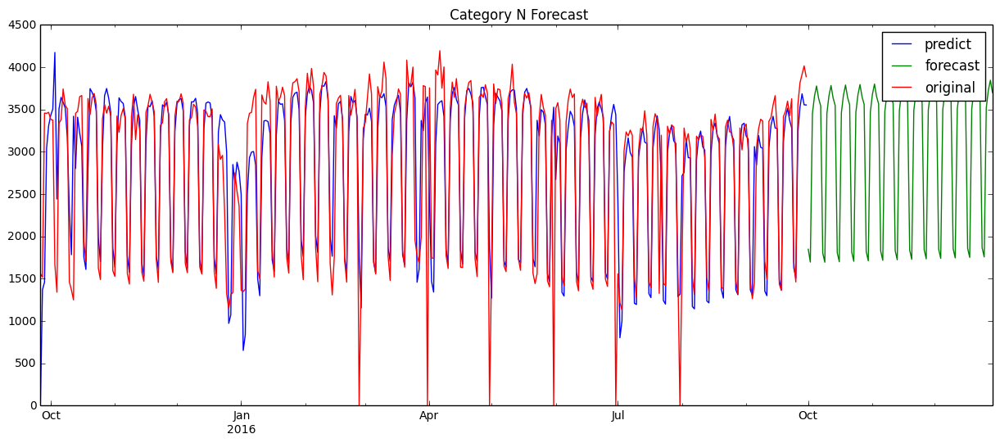

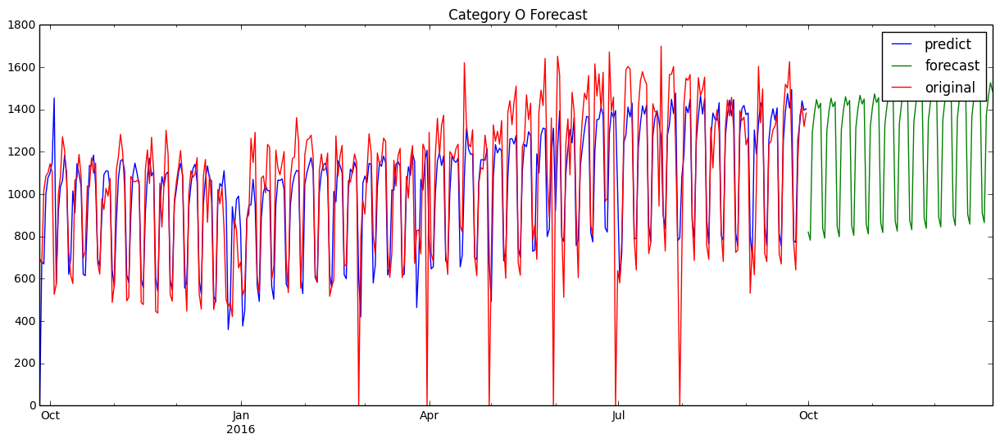

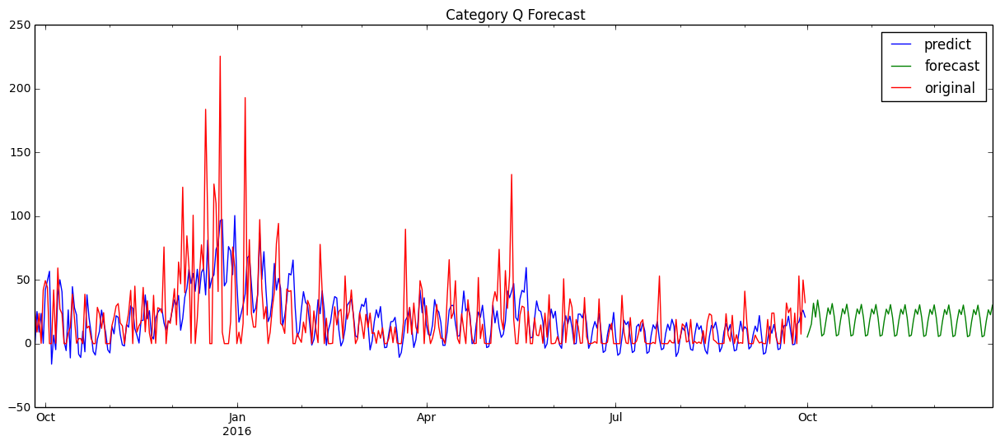

In [55]:
pred = map(plot_forecast, results_1, splitted_data, temp_list)

In [56]:
# Report performance
def rmse_measurement(timeseries, pred, item):
    mse = mean_squared_error(timeseries, pred)
    rmse = sqrt(mse)
    print('Category {} - RMSE: %.3f'.format(item) % rmse)
    return rmse

In [57]:
rmse_total = map(rmse_measurement, splitted_data, pred, temp_list)

Category A - RMSE: 11.167
Category B - RMSE: 247.486
Category C - RMSE: 66.810
Category D - RMSE: 4.463
Category E - RMSE: 22.553
Category F - RMSE: 358.726
Category G - RMSE: 103.561
Category H - RMSE: 160.261
Category I - RMSE: 71.138
Category K - RMSE: 69.670
Category L - RMSE: 30.686
Category M - RMSE: 280.767
Category N - RMSE: 560.257
Category O - RMSE: 218.178
Category Q - RMSE: 25.830


In [58]:
print 'Total RMSE: ', np.sum(rmse_total)

Total RMSE:  2231.55337037


# Total Forecast

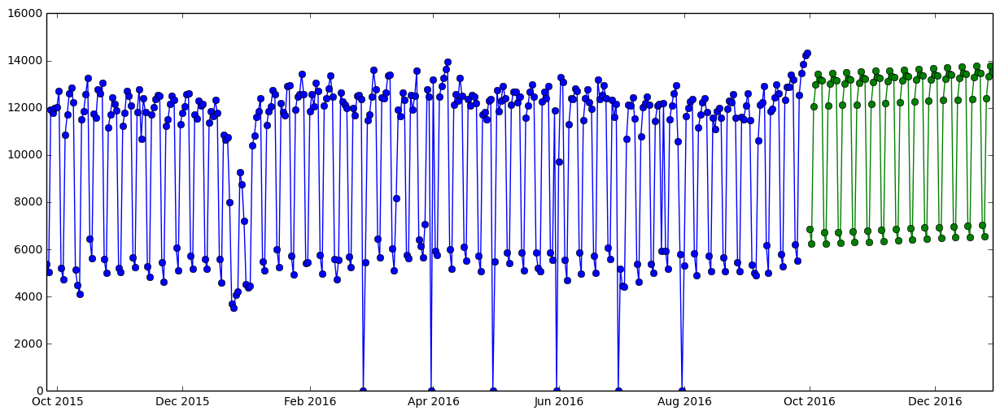

In [59]:
forecast_90 = map(lambda x: x.forecast(steps=90), results_1)

total_forecast = pd.Series()
original_sales = pd.Series()
for i, df in enumerate(forecast_90):
    if i == 0:
        total_forecast = df
        original_sales = splitted_data[i]
    else:
        total_forecast = total_forecast + df
        original_sales = original_sales + splitted_data[i]
        
plt.plot(original_sales.index, original_sales, '-o')
plt.plot(total_forecast.index, total_forecast, '-o')

Top contributors are...
Category B Sales Contribution:  0.147034860134
Category F Sales Contribution:  0.106330179479
Category M Sales Contribution:  0.147781301437
Category N Sales Contribution:  0.275003074503
Category O Sales Contribution:  0.114340518742


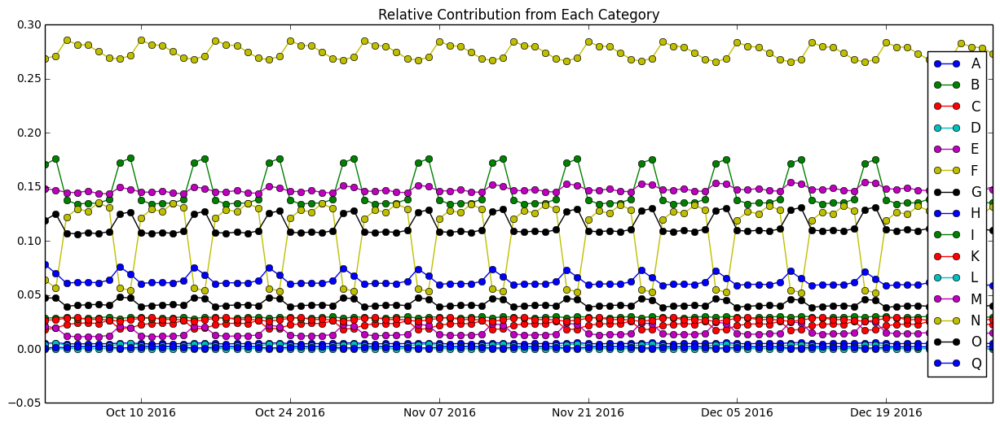

In [60]:
def relative_cont_plot(forecast_90, item):
    category = forecast_90 / total_forecast
#     print 'Category {}: '.format(item), category.mean()
    if category.mean() >= 0.08:
        print 'Category {} Sales Contribution: '.format(item), category.mean()
    _ = plt.plot(category.index, category, '-o', label=item)
    _ = plt.legend(loc='right')
    _ = plt.title('Relative Contribution from Each Category')

print 'Top contributors are...'
_ = map(relative_cont_plot, forecast_90, temp_list)

# Top Down Approach - Build Model and Forecast on All Categories.

In [61]:
print original_sales.head()
idx = pd.date_range('09-26-2015', '09-30-2016')    

original_sales.index = pd.DatetimeIndex(original_sales.index)
original_sales = original_sales.reindex(idx, fill_value=0)
print original_sales.shape, '-', original_sales.index

print '\n', original_sales.head()

2015-09-26     5370.26
2015-09-27     5051.38
2015-09-28    11937.56
2015-09-29    11788.07
2015-09-30    11995.37
Freq: D, Name: sales, dtype: float64
(371,) - DatetimeIndex(['2015-09-26', '2015-09-27', '2015-09-28', '2015-09-29',
               '2015-09-30', '2015-10-01', '2015-10-02', '2015-10-03',
               '2015-10-04', '2015-10-05',
               ...
               '2016-09-21', '2016-09-22', '2016-09-23', '2016-09-24',
               '2016-09-25', '2016-09-26', '2016-09-27', '2016-09-28',
               '2016-09-29', '2016-09-30'],
              dtype='datetime64[ns]', length=371, freq='D')

2015-09-26     5370.26
2015-09-27     5051.38
2015-09-28    11937.56
2015-09-29    11788.07
2015-09-30    11995.37
Freq: D, Name: sales, dtype: float64


In [62]:
total_forecast = model_building(original_sales, 'Total')

SARIMA(0, 1, 1) (0, 1, 1, 7) AIC=6540.579
SARIMA(0, 1, 1) (1, 1, 1, 7) AIC=6542.250
SARIMA(1, 1, 1) (0, 1, 1, 7) AIC=6532.562
SARIMA(1, 1, 1) (1, 1, 1, 7) AIC=6534.298
Best SARIMA(1, 1, 1) (0, 1, 1, 7) AIC=6532.562
Category Total:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 1, 1)x(0, 1, 1, 7)   Log Likelihood               -3262.281
Date:                           Fri, 17 Feb 2017   AIC                           6532.562
Time:                                   04:34:15   BIC                           6548.227
Sample:                               09-26-2015   HQIC                          6538.784
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z     

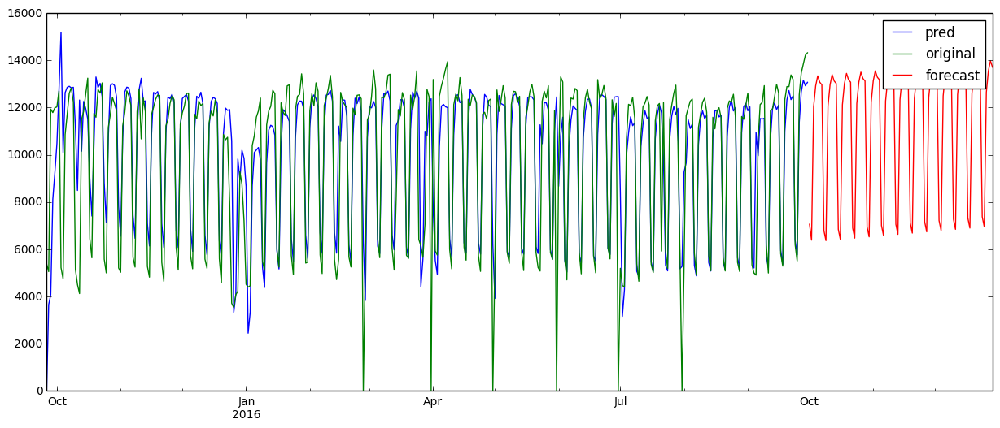

In [63]:
total_pred = total_forecast.predict()
forecast_90 = total_forecast.forecast(steps=90)

total_pred.plot(label='pred')
original_sales.plot(label='original')
forecast_90.plot(label='forecast')
plt.legend()

In [64]:
rmse_measurement(original_sales, total_pred, 'Total')

Category Total - RMSE: 2071.591


2071.5906626955702

# Final Note
### Top down approach (RMSE=2071)
### Bottom up approach (RMSE=2231)
### Both top down and bottom up approach came quite close. The series dynamics were almost the same!
### Top down was a bit better. But it could be the top down method is overfitting, so further validation is needed.
## What could be improved?
### - More data: if we have 5 years of data, we can definitely build more accurate models.
### - More features: we could use weather data to see how climate affects sales in diff categories
### - More features: also features like promotion or not, number of competitors nearby would also help
### - Diff models: we could try xgboost